Import the needed modules

In [1]:
from importlib.metadata import requires
import numpy as np
import torch
from torch import nn
from torch import optim
import pandas
import os
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=UserWarning) 

torch.autograd.set_detect_anomaly(True)

Create the sigmoid data structure with a built in forward, update, and loss function

In [2]:
class model_sigmoid(nn.Module):
    # Initialize the model
    def __init__(self, c1=10.5, c2=3, c3=1.0, c4=1.0, c5=1.0, c6=-22.0, c7=1.0, c8=1.0):
        super(model_sigmoid, self).__init__()
        
        # Alpha (learning rate) hyperparameter of the model
        self.alpha_start = 0.001
        self.alpha = self.alpha_start
        
        # Parameters of the model
        self.c1 = torch.tensor(c1, dtype=torch.float64, requires_grad=True)
        self.c2 = torch.tensor(c2, dtype=torch.float64, requires_grad=True)
        self.c3 = torch.tensor(c3, dtype=torch.float64, requires_grad=True)
        self.c4 = torch.tensor(c4, dtype=torch.float64, requires_grad=True)
        self.c5 = torch.tensor(c5, dtype=torch.float64, requires_grad=True)
        self.c6 = torch.tensor(c6, dtype=torch.float64, requires_grad=True)
        self.c7 = torch.tensor(c7, dtype=torch.float64, requires_grad=True)
        self.c8 = torch.tensor(c8, dtype=torch.float64, requires_grad=True)
    
    # Get a prediction from the model
    # Inputs:
    #   x - The inputs into the model
    def forward(self, x):
        return (self.c1)/torch.pow((self.c2+self.c3*torch.exp(-self.c4*(self.c5*x + self.c6))), self.c7)+self.c8

    # Update the model parameters
    # Inputs:
    #   loss - The loss from the model
    #   numIters - Number of time to update the model
    #   currIter - The current update iteration
    def update(self, loss, numIter, currIter):
        # Compute the gradients
        loss.backward()
        
        # Update the model parameters
        self.c1 = torch.tensor(self.c1 - self.alpha*self.c1.grad, requires_grad=True)
        self.c2 = torch.tensor(self.c2 - self.alpha*self.c2.grad, requires_grad=True)
        self.c3 = torch.tensor(self.c3 - self.alpha*self.c3.grad, requires_grad=True)
        self.c4 = torch.tensor(self.c4 - self.alpha*self.c4.grad, requires_grad=True)
        self.c5 = torch.tensor(self.c5 - self.alpha*self.c5.grad, requires_grad=True)
        self.c6 = torch.tensor(self.c6 - self.alpha*self.c6.grad, requires_grad=True)
        self.c7 = torch.tensor(self.c7 - self.alpha*self.c7.grad, requires_grad=True)
        self.c8 = torch.tensor(self.c8 - self.alpha*self.c8.grad, requires_grad=True)
        
        # Decrease the learning rate
        self.alpha = self.alpha_start*(1-(currIter/numIter))

    # The loss function used to evaluate the model. This loss
    # function is a modified form of the MSE loss where
    # 2*(1-self.c2)**2 is added to the loss value. This term
    # convinced the function to not have a massive range and to
    # keep the c2 term around 1.
    # Inputs:
    #   preds - The predictions from the model
    #   labels - The true values we want the model to predict
    def getLoss(self, preds, labels):
        return torch.sum((labels-preds)**2)/(preds.shape[0])+2*(1-self.c2)**2
    

    # Get the parameters from the model
    def getParams(self):
        return self.c1, self.c2, self.c3, self.c4, self.c5, self.c6, self.c7, self.c8

Now let's train the sigmoid model

To start, we need to load in the data as well as specify a few variables which we will use later

In [3]:
# The number of times to train the model
updates = 50000

# True if the graph should be shown while training. False otherwise
showGraph = True



# Load in the data
data = pandas.read_csv(os.path.join("data", "data2.csv"))

Now let's split the data to get all years after 1300 for both the train years and population

In [4]:
# Get the World data from the dataset
years = torch.tensor(data["year"].values[11300:].astype(np.float64), requires_grad=False)
values = torch.tensor(data["World Population"].values[11300:].astype(np.float64), requires_grad=False)

So the model can learn better, we will make both the values and years have a smaller range by dividing the populations by 1 billion and the years by 100

In [6]:
# Divide the values by 1 billion to help the model learn
values = values/1000000000

# Divide the years by 100 to help the model learn
years = years/100

Now initialize a sigmoid model

In [9]:
# Initialize the model
m = model_sigmoid()

Now we need to start training the model, we will do so for `updates` times and will show a graph every 50 updates if `showGraph` is True

Iteration #0, Loss: 9.117896845091432


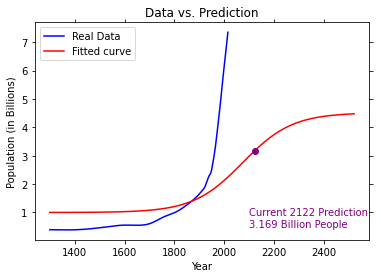

Iteration #50, Loss: 5.9849995471794815


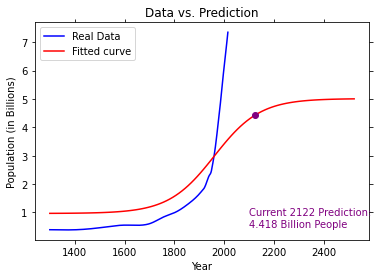

Iteration #100, Loss: 4.121899676202034


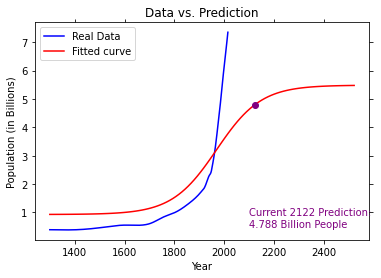

Iteration #150, Loss: 2.8602438508578096


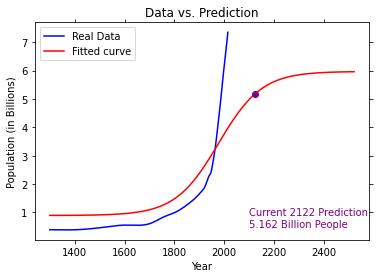

Iteration #200, Loss: 2.003356744528839


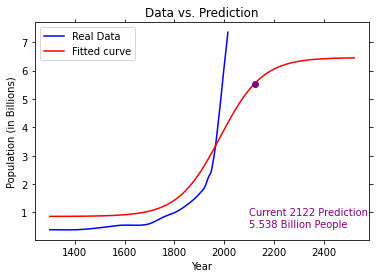

Iteration #250, Loss: 1.4194241903884632


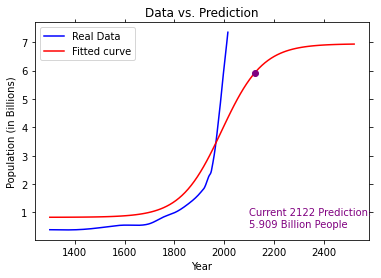

Iteration #300, Loss: 1.0199716807044021


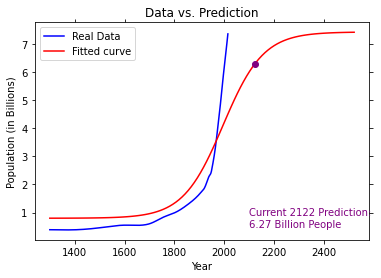

Iteration #350, Loss: 0.7455119651979131


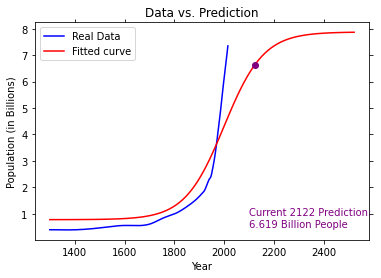

Iteration #400, Loss: 0.5559707393070373


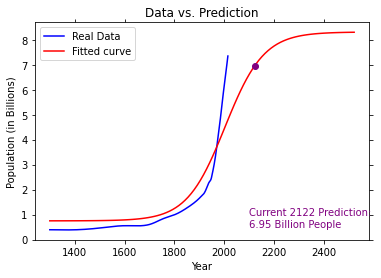

Iteration #450, Loss: 0.42429534298997507


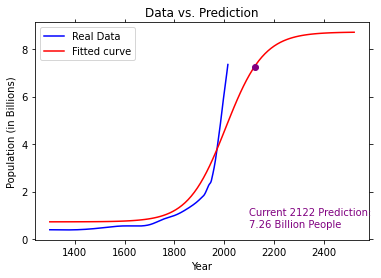

Iteration #500, Loss: 0.3321834356937127


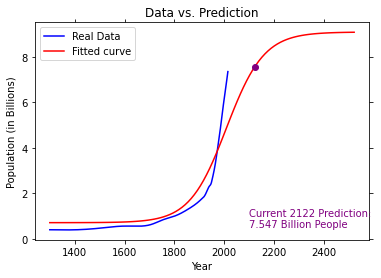

Iteration #550, Loss: 0.267224083557084


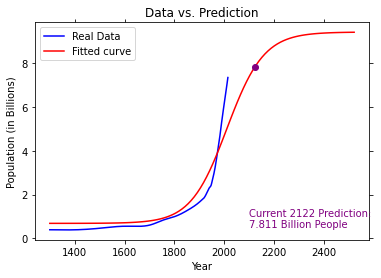

Iteration #600, Loss: 0.22098074187684114


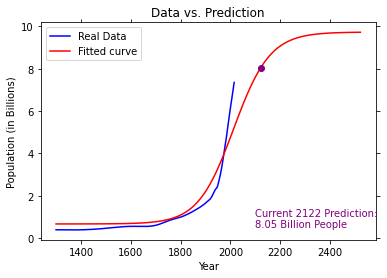

Iteration #650, Loss: 0.1877033110780304


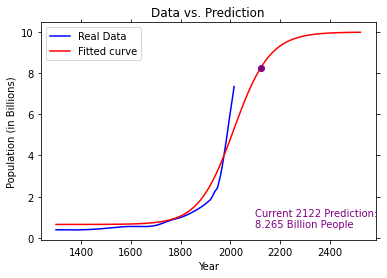

Iteration #700, Loss: 0.16346114210012674


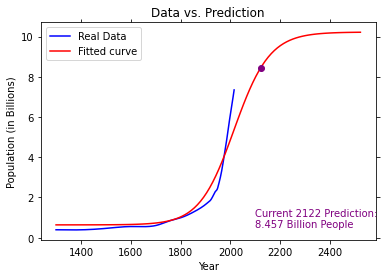

Iteration #750, Loss: 0.14555831387833532


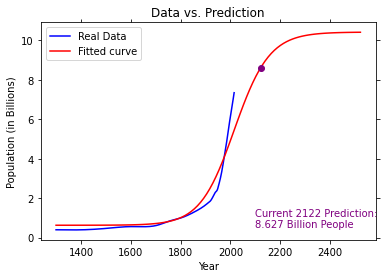

Iteration #800, Loss: 0.13213858693505592


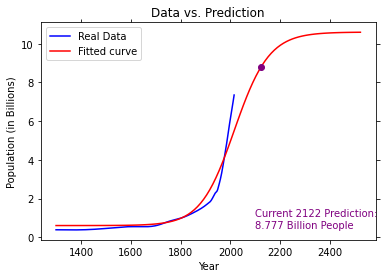

Iteration #850, Loss: 0.12191806075724361


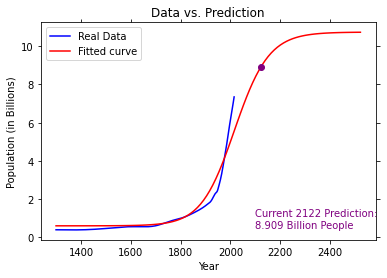

Iteration #900, Loss: 0.1140039609357824


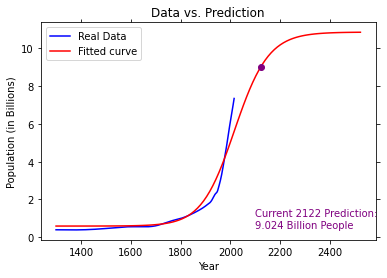

Iteration #950, Loss: 0.10777160592514352


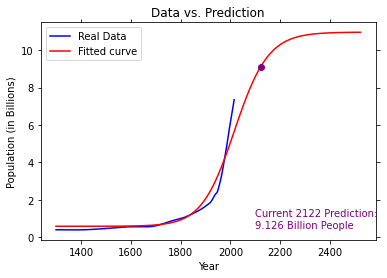

Iteration #1000, Loss: 0.10278072731105138


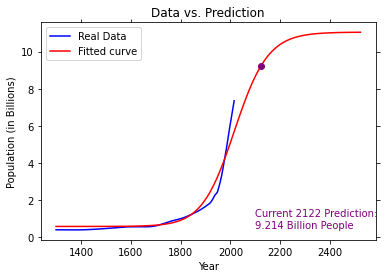

Iteration #1050, Loss: 0.09871844312131559


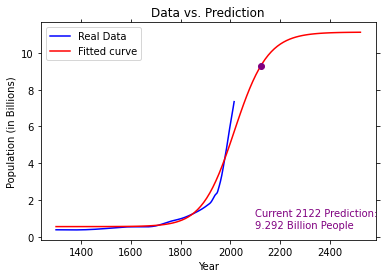

Iteration #1100, Loss: 0.09536030506735468


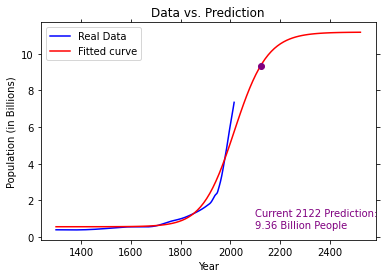

Iteration #1150, Loss: 0.09254361824773907


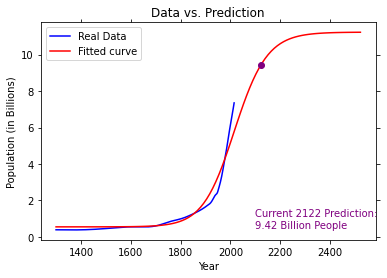

Iteration #1200, Loss: 0.09014910641214902


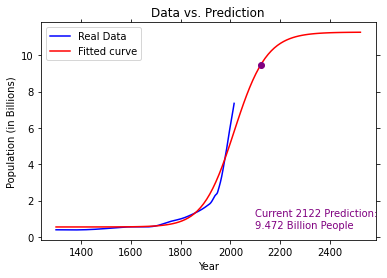

Iteration #1250, Loss: 0.0880882623103534


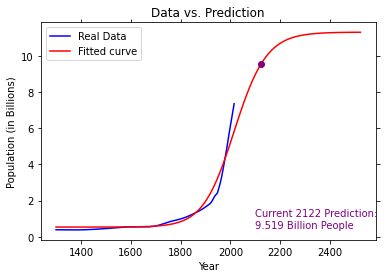

Iteration #1300, Loss: 0.08629457893082237


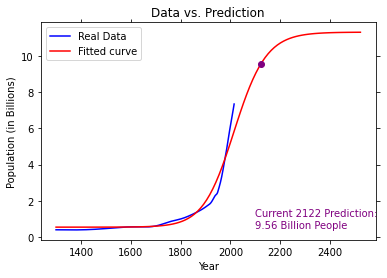

Iteration #1350, Loss: 0.0847174367939503


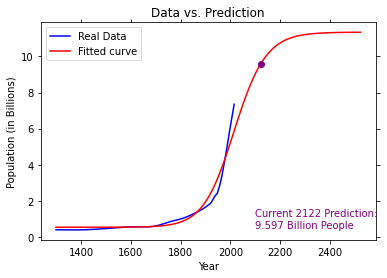

Iteration #1400, Loss: 0.08331781470800531


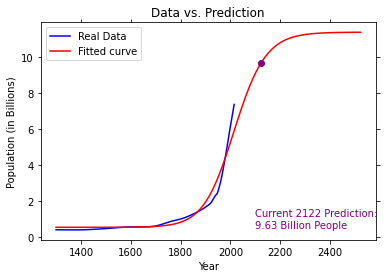

Iteration #1450, Loss: 0.08206525712958183


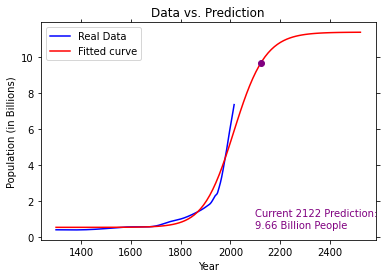

Iteration #1500, Loss: 0.08093571143331667


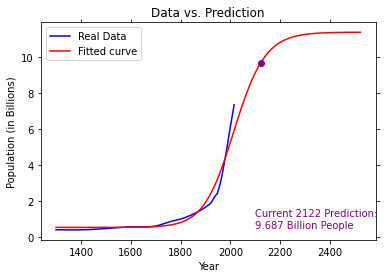

Iteration #1550, Loss: 0.07990997065641355


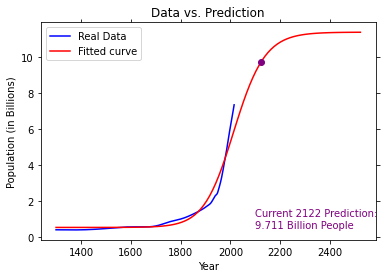

Iteration #1600, Loss: 0.07897254034809503


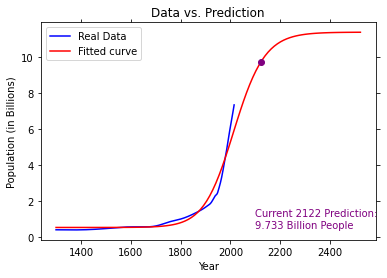

Iteration #1650, Loss: 0.07811080467234505


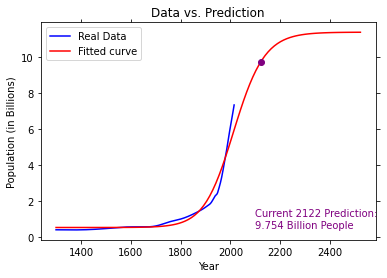

Iteration #1700, Loss: 0.07731440544006499


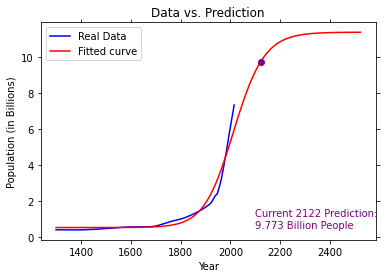

Iteration #1750, Loss: 0.07657477407218219


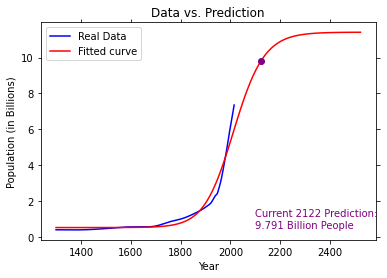

Iteration #1800, Loss: 0.07588477453508757


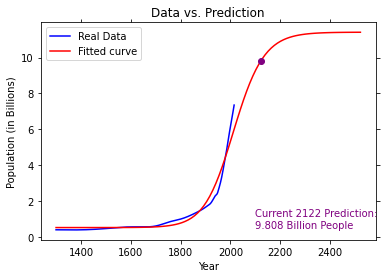

Iteration #1850, Loss: 0.07523842769558757


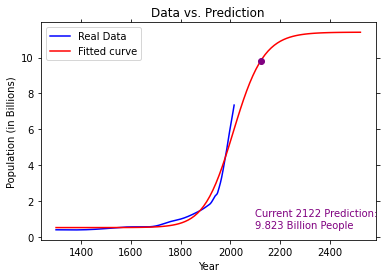

Iteration #1900, Loss: 0.07463069611035854


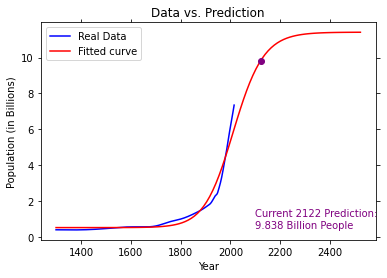

Iteration #1950, Loss: 0.07405731421223138


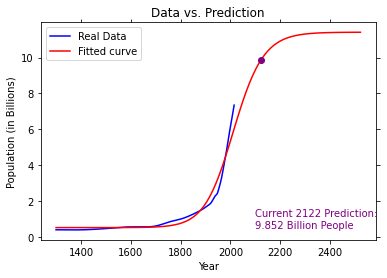

Iteration #2000, Loss: 0.07351465300872279


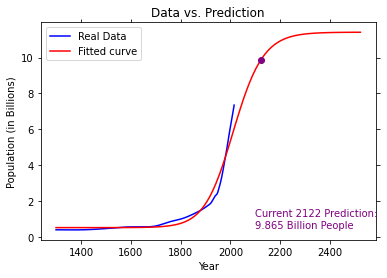

Iteration #2050, Loss: 0.07299961132858708


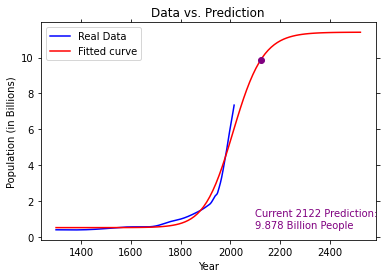

Iteration #2100, Loss: 0.07250952772199992


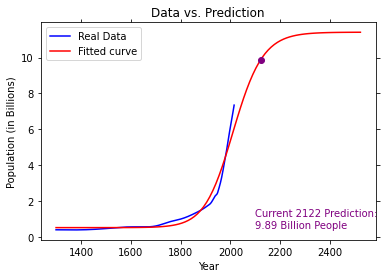

Iteration #2150, Loss: 0.0720421086001404


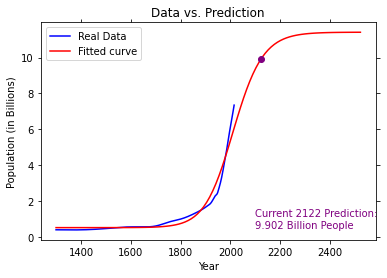

Iteration #2200, Loss: 0.07159536926883996


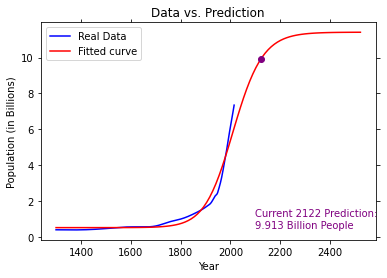

Iteration #2250, Loss: 0.07116758529111337


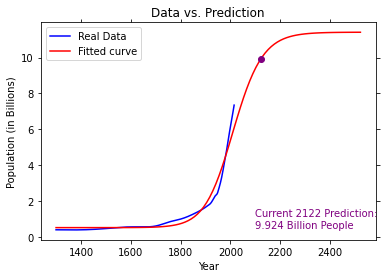

Iteration #2300, Loss: 0.07075725218923737


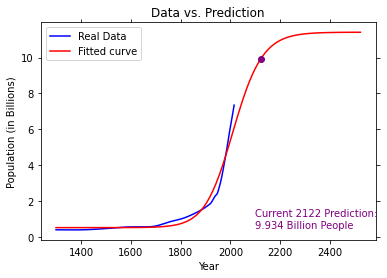

Iteration #2350, Loss: 0.07036305192705836


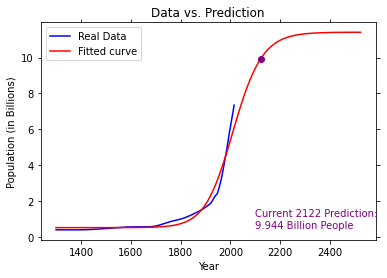

Iteration #2400, Loss: 0.06998382493814836


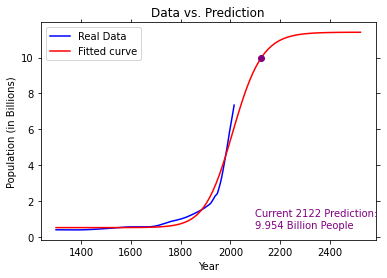

Iteration #2450, Loss: 0.06961854671384816


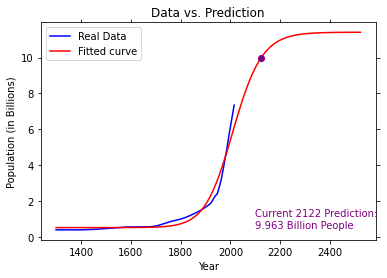

Iteration #2500, Loss: 0.06926630815732043


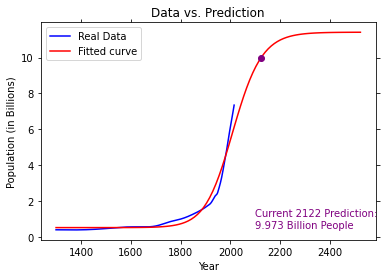

Iteration #2550, Loss: 0.06892629905985923


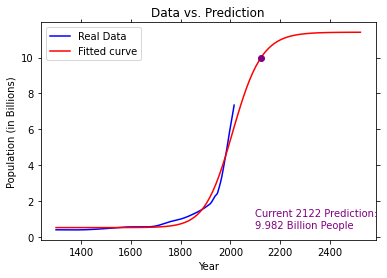

Iteration #2600, Loss: 0.06859779417421094


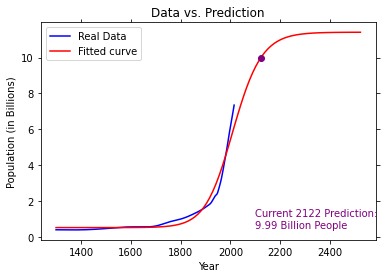

Iteration #2650, Loss: 0.0682801414540677


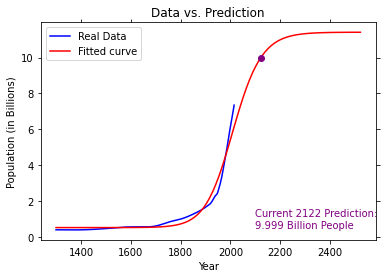

Iteration #2700, Loss: 0.06797275210471831


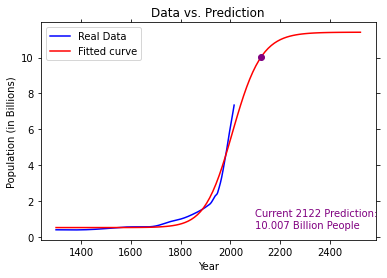

Iteration #2750, Loss: 0.0676750921511758


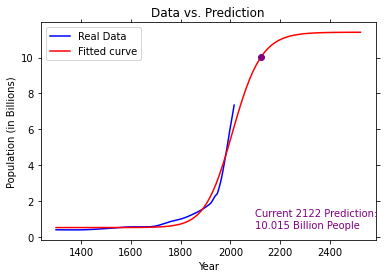

Iteration #2800, Loss: 0.06738667528004091


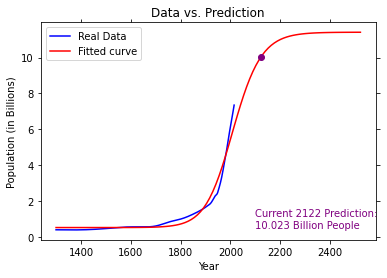

Iteration #2850, Loss: 0.06710705675223397


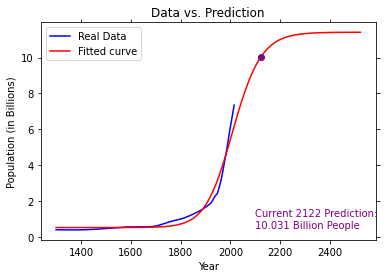

Iteration #2900, Loss: 0.06683582821734478


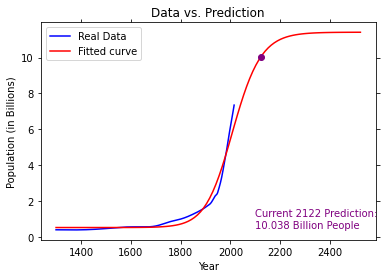

Iteration #2950, Loss: 0.0665726132881076


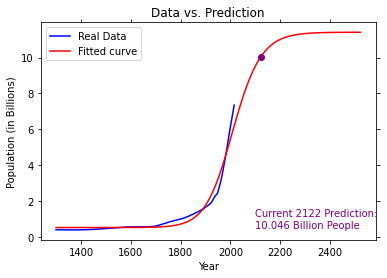

Iteration #3000, Loss: 0.06631706375651074


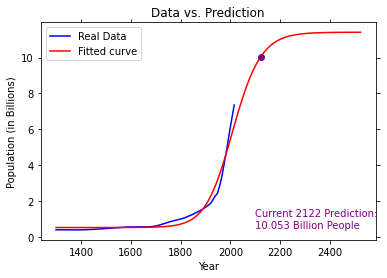

Iteration #3050, Loss: 0.06606885635215258


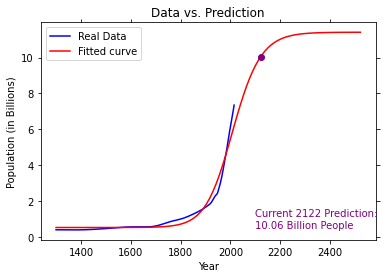

Iteration #3100, Loss: 0.06582768995938183


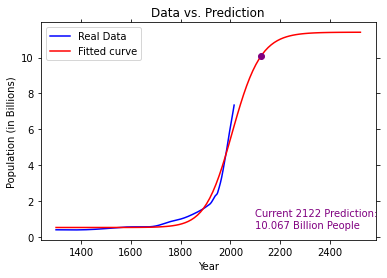

Iteration #3150, Loss: 0.0655932832230425


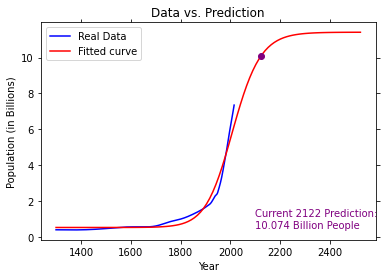

Iteration #3200, Loss: 0.06536537248375435


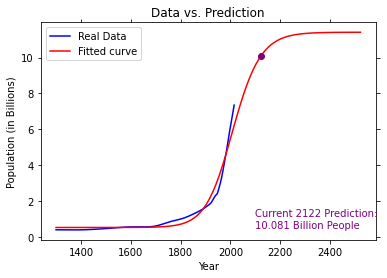

Iteration #3250, Loss: 0.0651437099929624


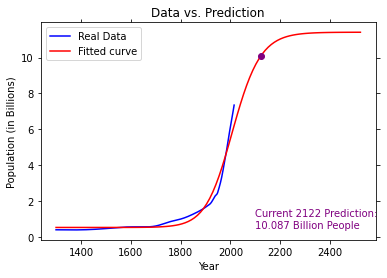

Iteration #3300, Loss: 0.06492806236579596


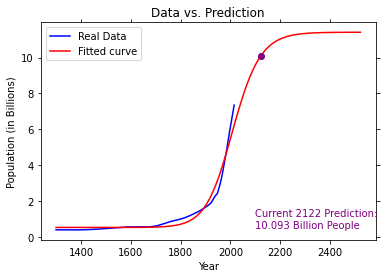

Iteration #3350, Loss: 0.06471820923631785


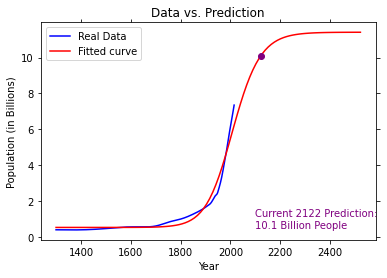

Iteration #3400, Loss: 0.06451394208525636


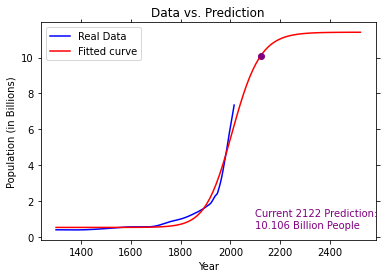

Iteration #3450, Loss: 0.06431506321493621


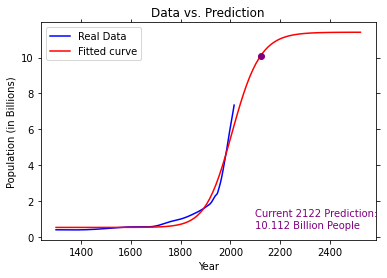

Iteration #3500, Loss: 0.06412138485002009


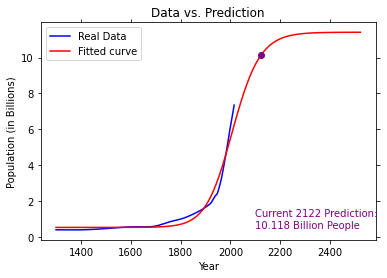

Iteration #3550, Loss: 0.06393272834595758


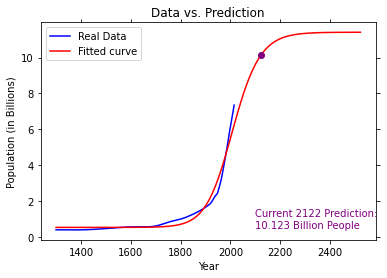

Iteration #3600, Loss: 0.06374892348979888


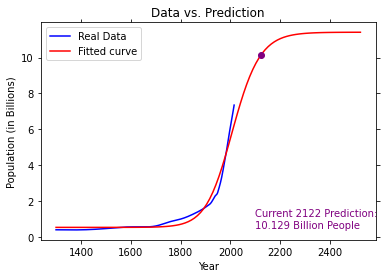

Iteration #3650, Loss: 0.06356980788036663


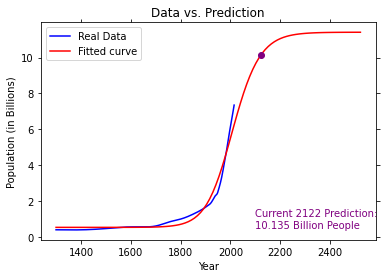

Iteration #3700, Loss: 0.06339522637674633


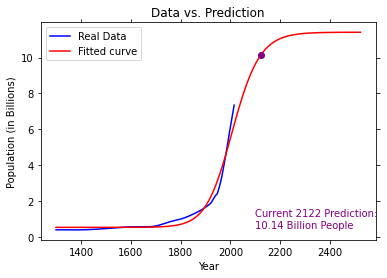

Iteration #3750, Loss: 0.06322503060571641


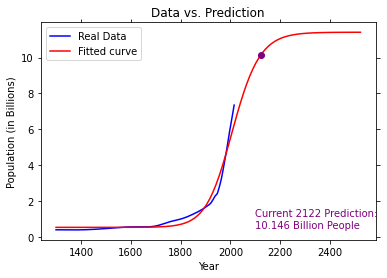

Iteration #3800, Loss: 0.06305907852014536


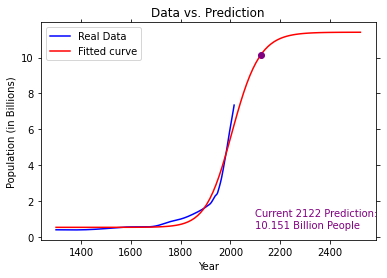

Iteration #3850, Loss: 0.06289723400156683


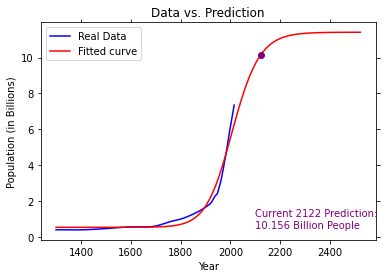

Iteration #3900, Loss: 0.06273936650115117


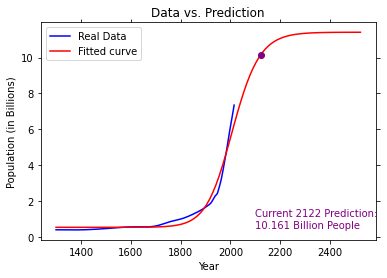

Iteration #3950, Loss: 0.06258535071413492


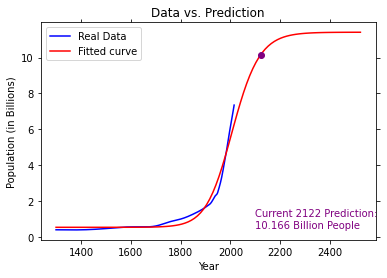

Iteration #4000, Loss: 0.062435066283497063


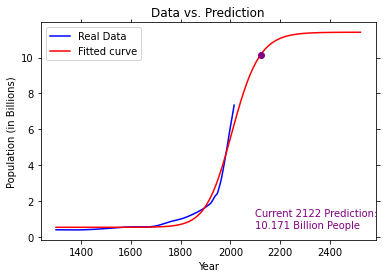

Iteration #4050, Loss: 0.06228839752927248


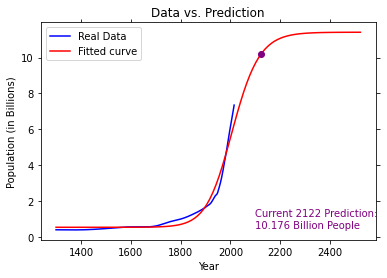

Iteration #4100, Loss: 0.06214523320041406


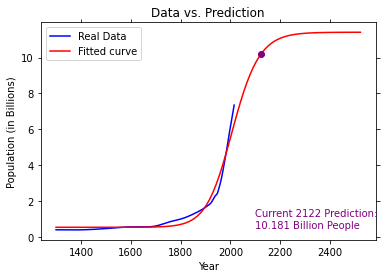

Iteration #4150, Loss: 0.06200546624655051


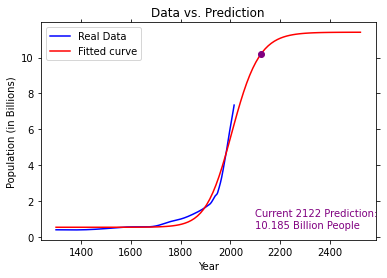

Iteration #4200, Loss: 0.06186899360736192


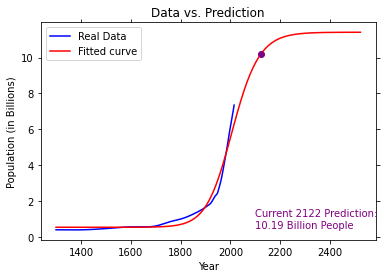

Iteration #4250, Loss: 0.0617357160176069


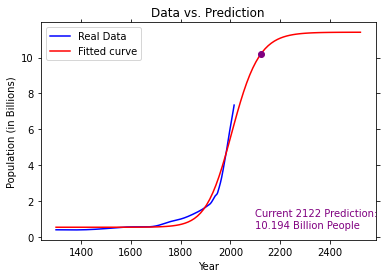

Iteration #4300, Loss: 0.061605537826108586


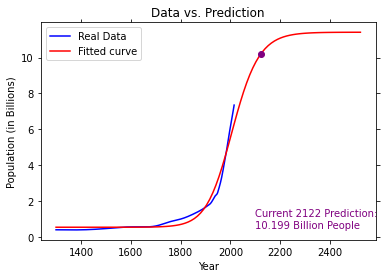

Iteration #4350, Loss: 0.061478366827231457


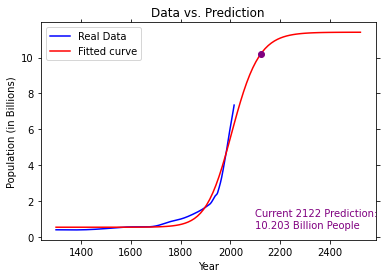

Iteration #4400, Loss: 0.0613541141035789


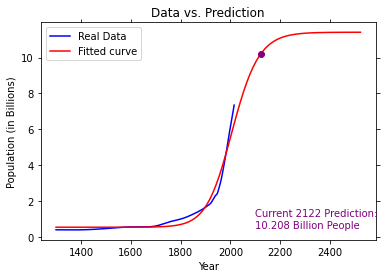

Iteration #4450, Loss: 0.06123269387880512


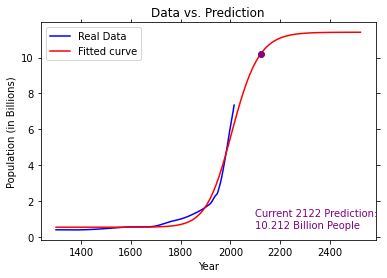

Iteration #4500, Loss: 0.061114023379580315


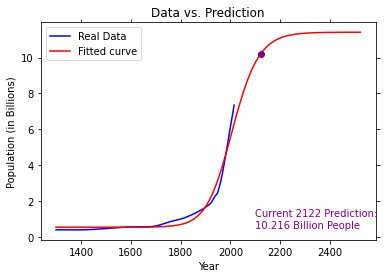

Iteration #4550, Loss: 0.06099802270586436


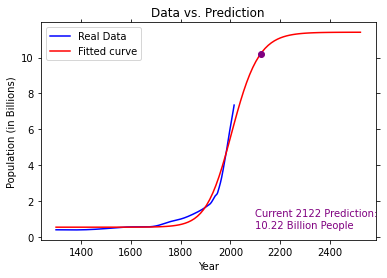

Iteration #4600, Loss: 0.06088461470875394


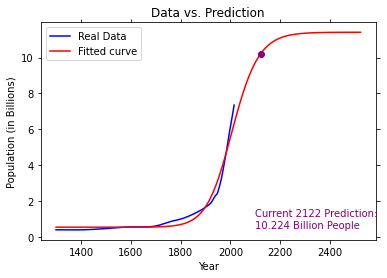

Iteration #4650, Loss: 0.06077372487525295


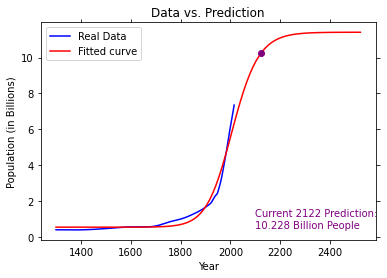

Iteration #4700, Loss: 0.060665281219393616


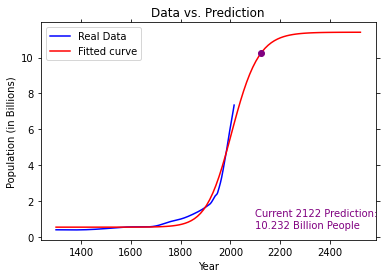

Iteration #4750, Loss: 0.060559214179202854


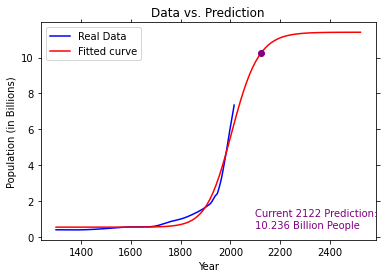

Iteration #4800, Loss: 0.06045545651906371


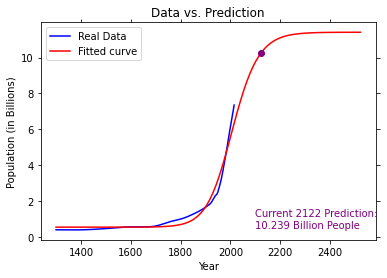

Iteration #4850, Loss: 0.06035394323707025


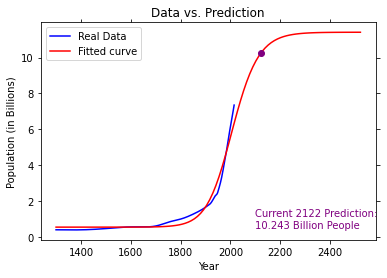

Iteration #4900, Loss: 0.060254611477019784


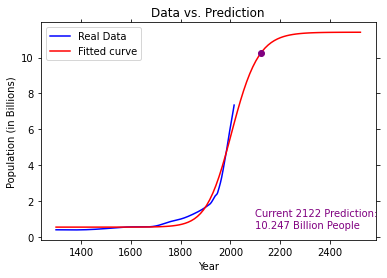

Iteration #4950, Loss: 0.06015740044471833


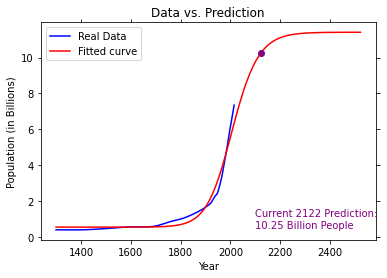

Iteration #5000, Loss: 0.06006225132831242


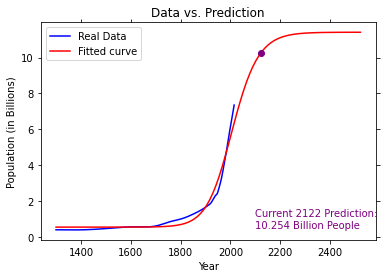

Iteration #5050, Loss: 0.05996910722238267


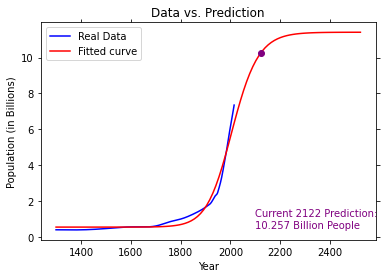

Iteration #5100, Loss: 0.05987791305556479


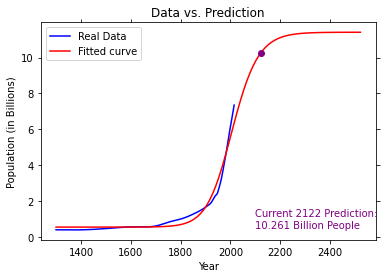

Iteration #5150, Loss: 0.05978861552148049


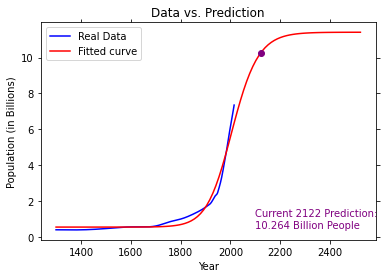

Iteration #5200, Loss: 0.05970116301278174


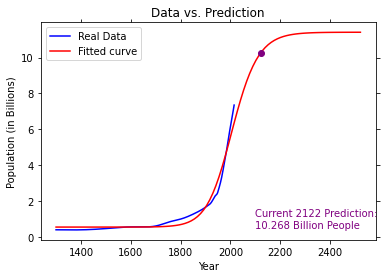

Iteration #5250, Loss: 0.05961550555812763


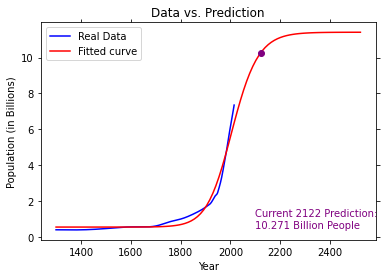

Iteration #5300, Loss: 0.05953159476192845


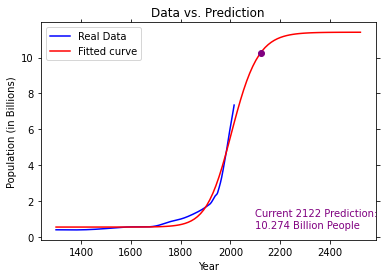

Iteration #5350, Loss: 0.059449383746704734


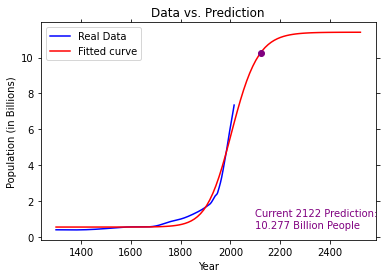

Iteration #5400, Loss: 0.059368827097918526


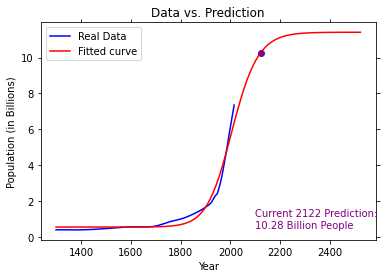

Iteration #5450, Loss: 0.05928988081114838


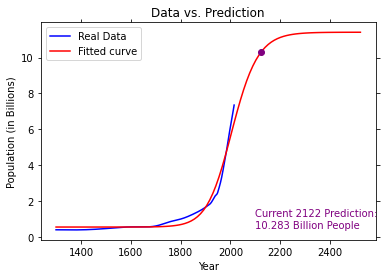

Iteration #5500, Loss: 0.05921250224148513


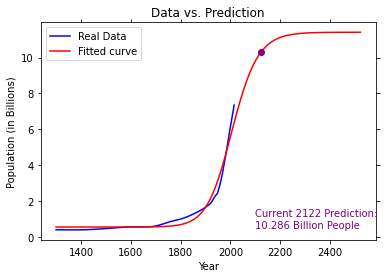

Iteration #5550, Loss: 0.059136650055035336


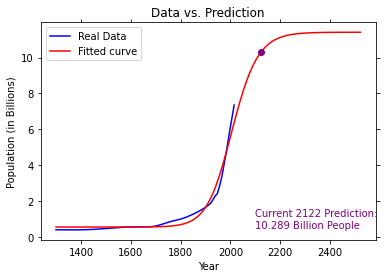

Iteration #5600, Loss: 0.059062284182428745


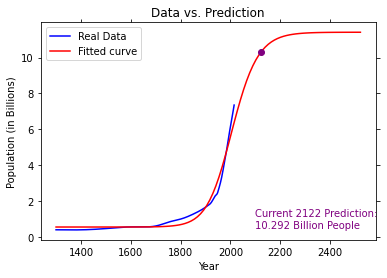

Iteration #5650, Loss: 0.0589893657742291


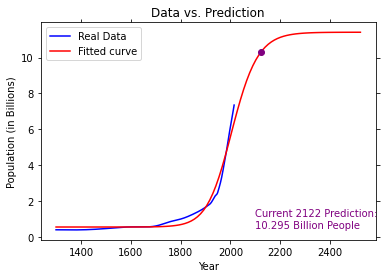

Iteration #5700, Loss: 0.058917857158157005


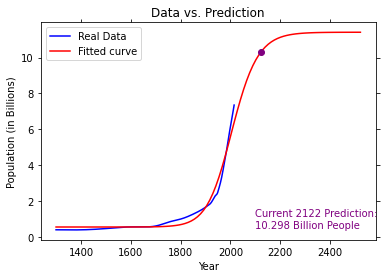

Iteration #5750, Loss: 0.058847721798038426


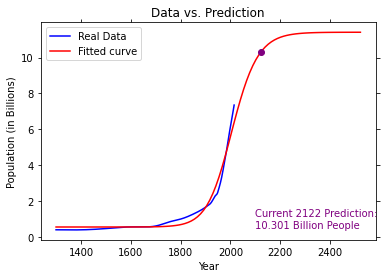

Iteration #5800, Loss: 0.05877892425439684


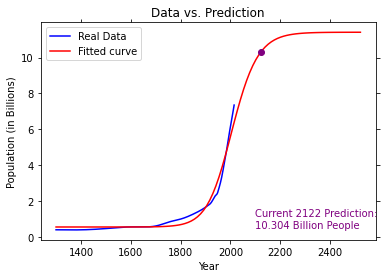

Iteration #5850, Loss: 0.05871143014661262


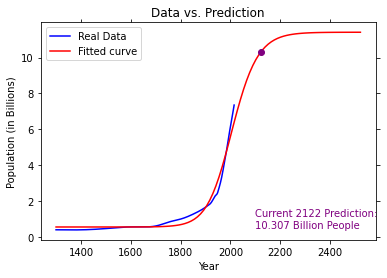

Iteration #5900, Loss: 0.05864520611657764


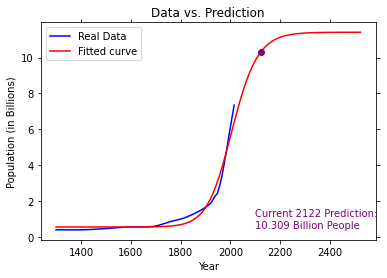

Iteration #5950, Loss: 0.05858021979377665


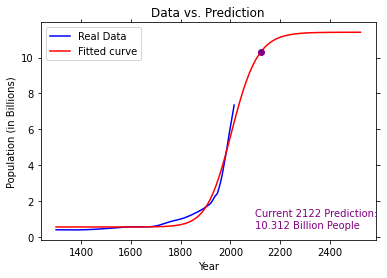

Iteration #6000, Loss: 0.05851643976173033


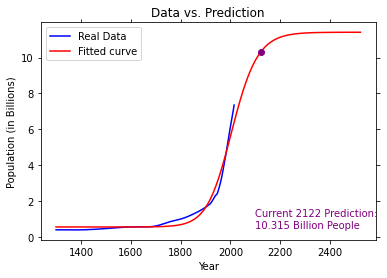

Iteration #6050, Loss: 0.0584538355257418


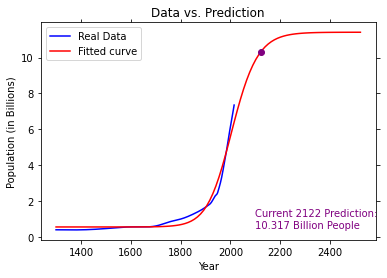

Iteration #6100, Loss: 0.058392377481884306


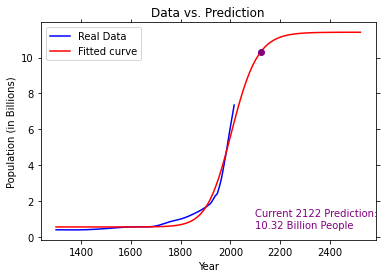

Iteration #6150, Loss: 0.058332036887179764


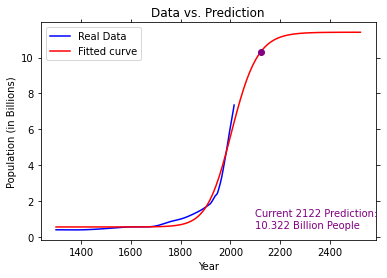

Iteration #6200, Loss: 0.058272785830914345


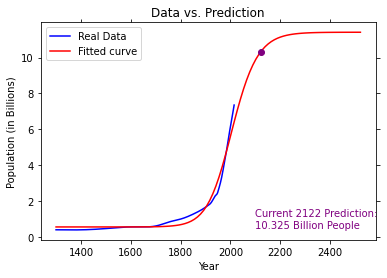

Iteration #6250, Loss: 0.05821459720704075


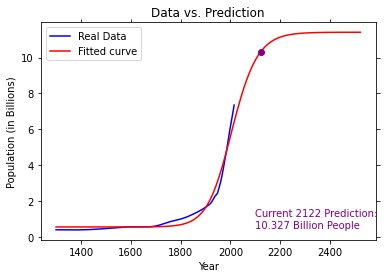

Iteration #6300, Loss: 0.058157444687623544


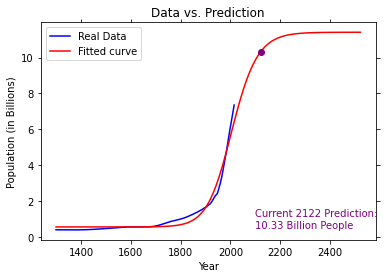

Iteration #6350, Loss: 0.058101302697279984


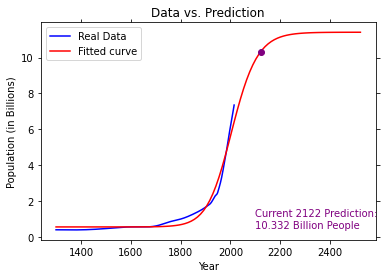

Iteration #6400, Loss: 0.05804614638857558


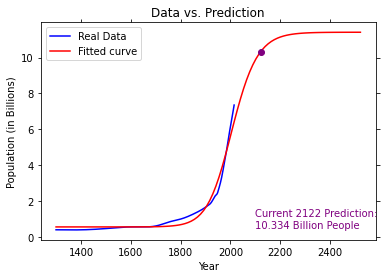

Iteration #6450, Loss: 0.05799195161833366


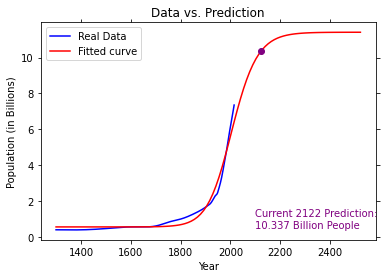

Iteration #6500, Loss: 0.05793869492482159


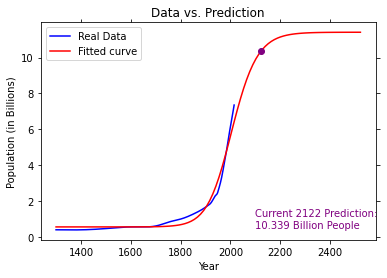

Iteration #6550, Loss: 0.05788635350577584


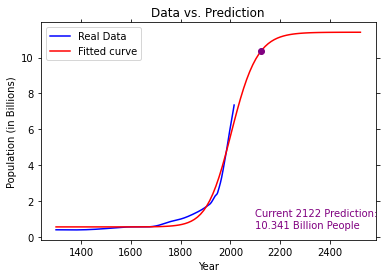

Iteration #6600, Loss: 0.057834905197231314


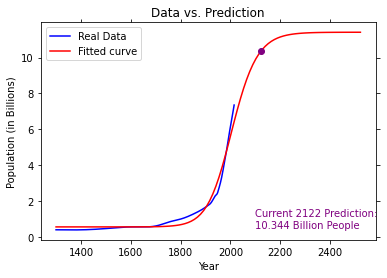

Iteration #6650, Loss: 0.057784328453123146


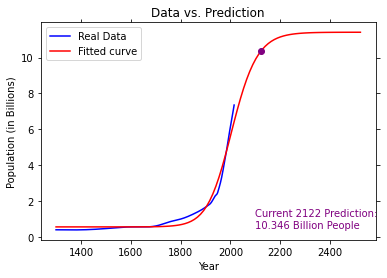

Iteration #6700, Loss: 0.05773460232562809


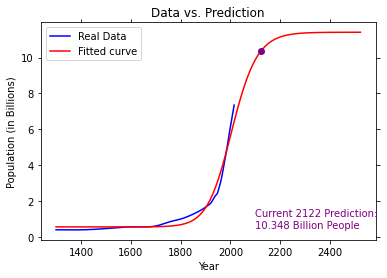

Iteration #6750, Loss: 0.057685706446214804


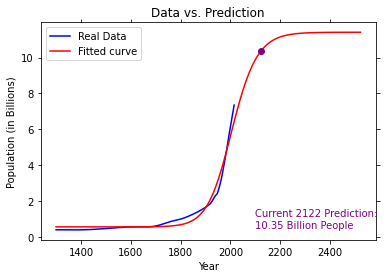

Iteration #6800, Loss: 0.05763762100737627


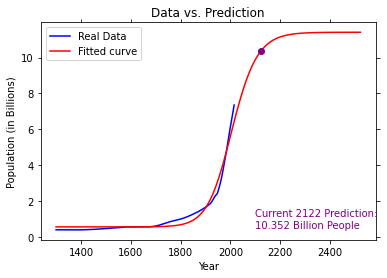

Iteration #6850, Loss: 0.057590326745014644


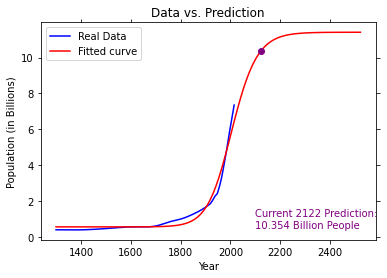

Iteration #6900, Loss: 0.0575438049214544


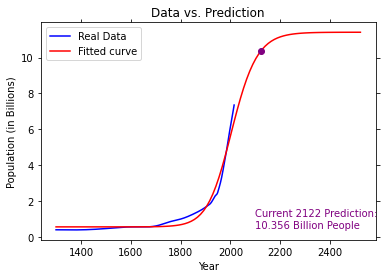

Iteration #6950, Loss: 0.05749803730905637


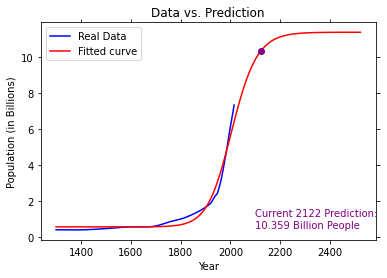

Iteration #7000, Loss: 0.05745300617441097


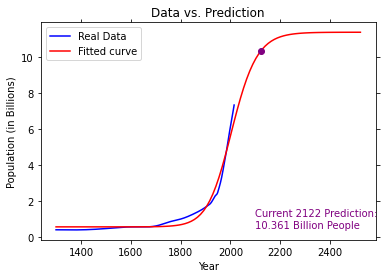

Iteration #7050, Loss: 0.05740869426308678


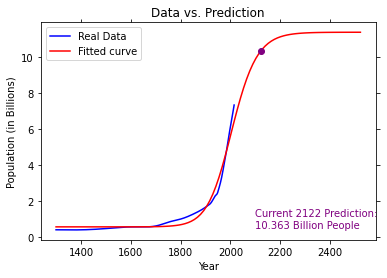

Iteration #7100, Loss: 0.05736508478491077


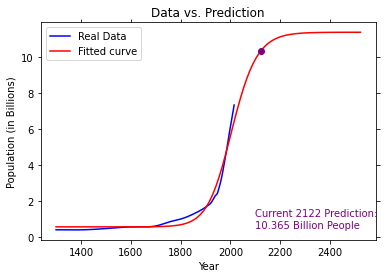

Iteration #7150, Loss: 0.05732216139976412


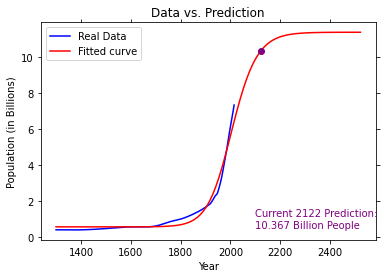

Iteration #7200, Loss: 0.057279908203867344


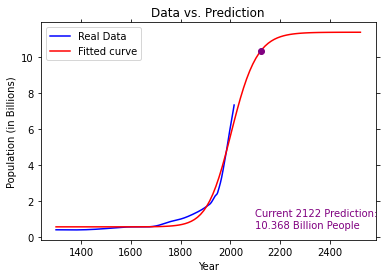

Iteration #7250, Loss: 0.057238309716541355


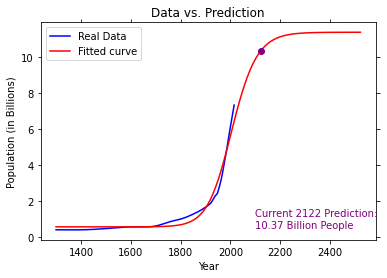

Iteration #7300, Loss: 0.0571973508674212


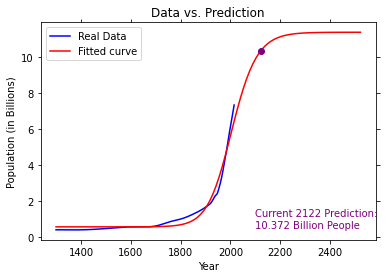

Iteration #7350, Loss: 0.057157016984109146


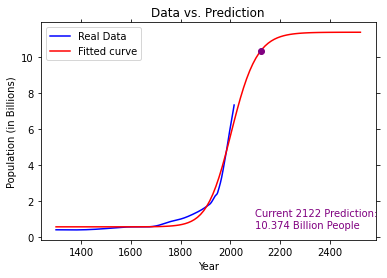

Iteration #7400, Loss: 0.05711729378024793


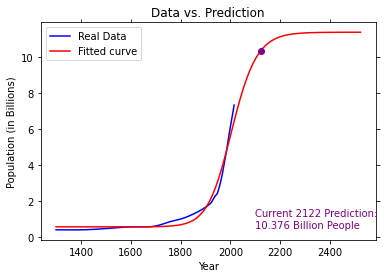

Iteration #7450, Loss: 0.05707816734399755


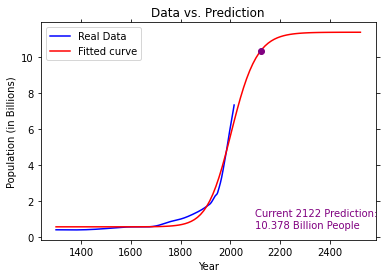

Iteration #7500, Loss: 0.05703962412690261


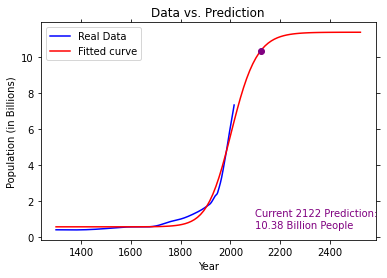

Iteration #7550, Loss: 0.05700165093313408


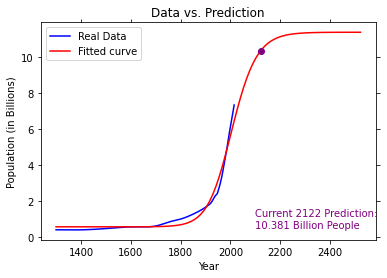

Iteration #7600, Loss: 0.05696423490909039


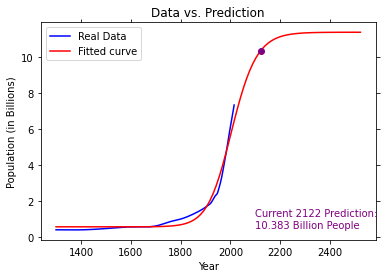

Iteration #7650, Loss: 0.05692736353334617


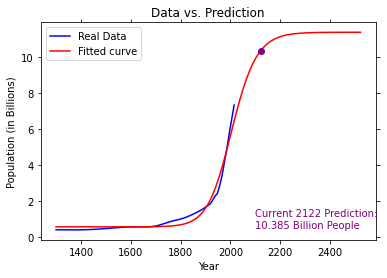

Iteration #7700, Loss: 0.056891024606934626


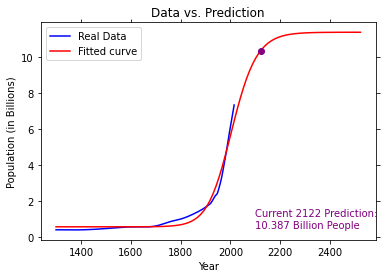

Iteration #7750, Loss: 0.05685520624395149


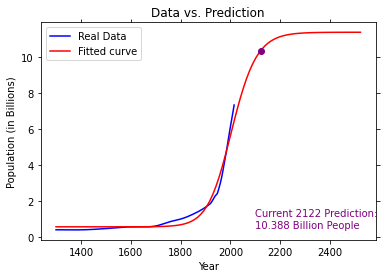

Iteration #7800, Loss: 0.05681989686246891


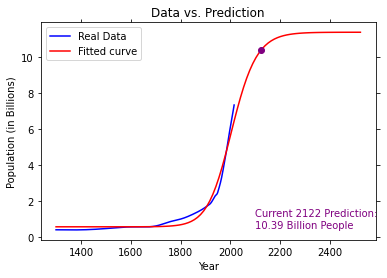

Iteration #7850, Loss: 0.05678508517574481


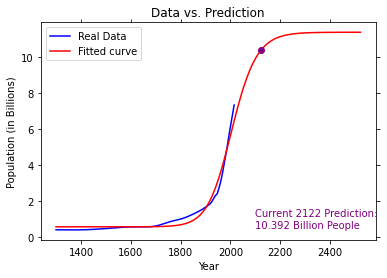

Iteration #7900, Loss: 0.05675076018372396


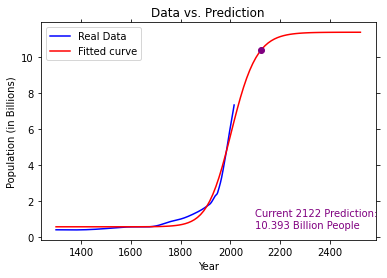

Iteration #7950, Loss: 0.05671691116481154


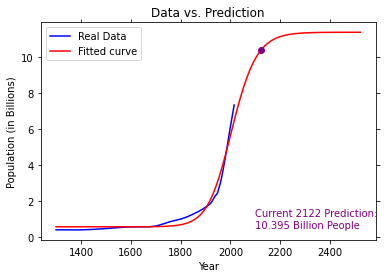

Iteration #8000, Loss: 0.0566835276679153


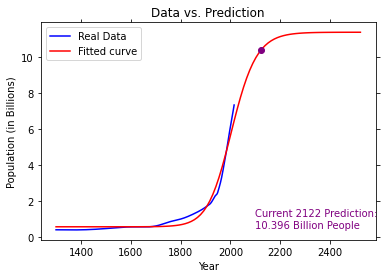

Iteration #8050, Loss: 0.05665059950474369


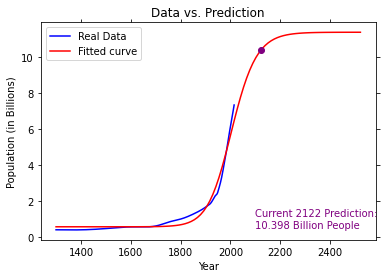

Iteration #8100, Loss: 0.056618116742352426


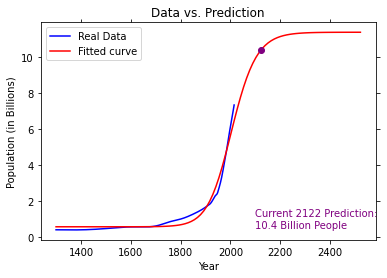

Iteration #8150, Loss: 0.056586069695928526


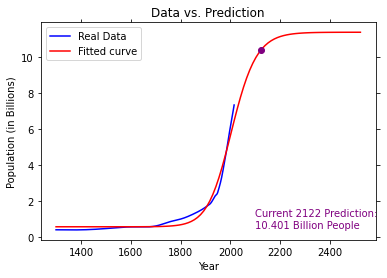

Iteration #8200, Loss: 0.05655444892180531


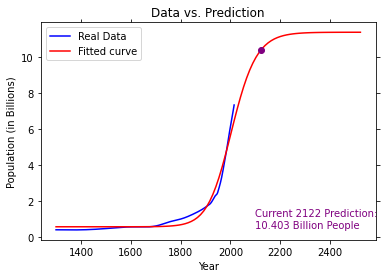

Iteration #8250, Loss: 0.05652324521069913


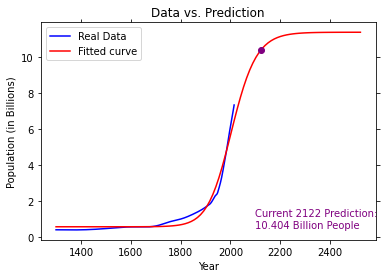

Iteration #8300, Loss: 0.056492449581159336


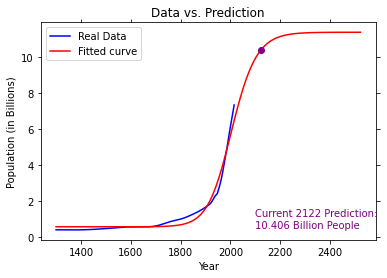

Iteration #8350, Loss: 0.05646205327322577


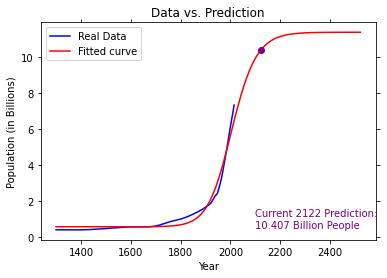

Iteration #8400, Loss: 0.056432047742284205


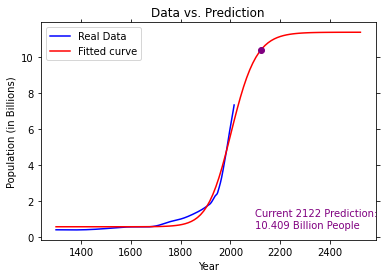

Iteration #8450, Loss: 0.05640242465311461


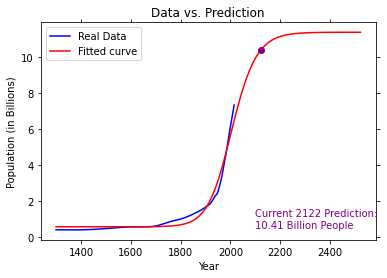

Iteration #8500, Loss: 0.05637317587412471


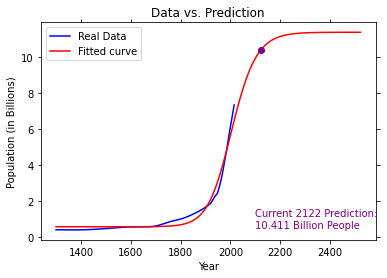

Iteration #8550, Loss: 0.05634429347176172


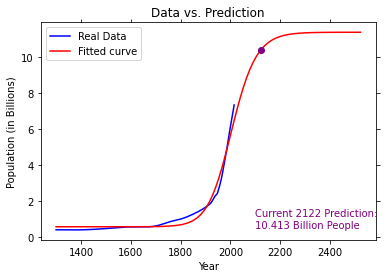

Iteration #8600, Loss: 0.05631576970509786


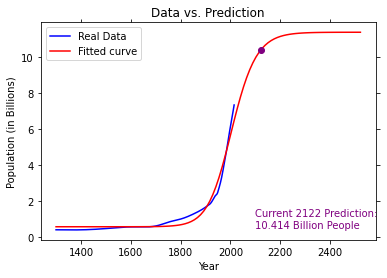

Iteration #8650, Loss: 0.056287597020581705


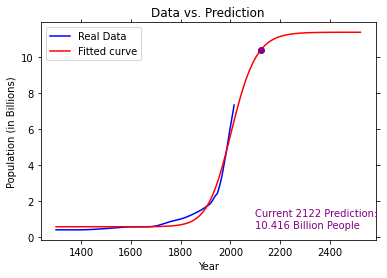

Iteration #8700, Loss: 0.05625976804695115


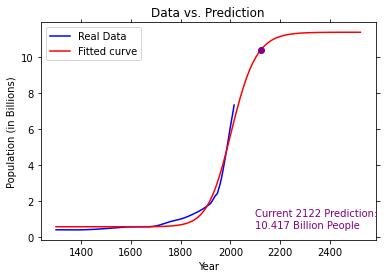

Iteration #8750, Loss: 0.05623227559030062


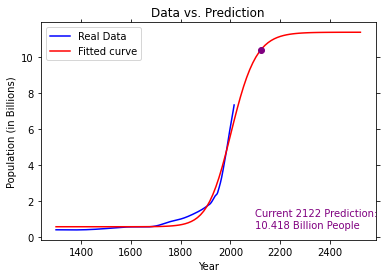

Iteration #8800, Loss: 0.05620511262930029


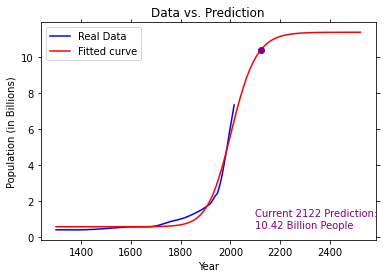

Iteration #8850, Loss: 0.05617827231055818


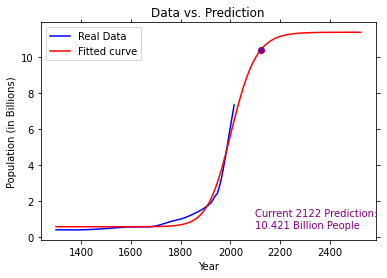

Iteration #8900, Loss: 0.05615174794412436


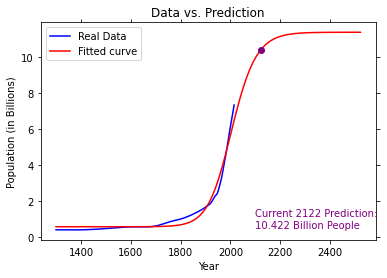

Iteration #8950, Loss: 0.05612553299912876


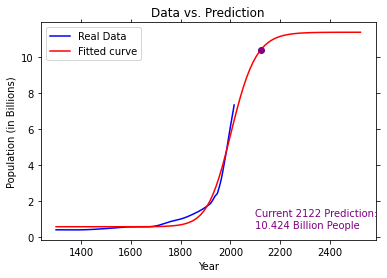

Iteration #9000, Loss: 0.05609962109955068


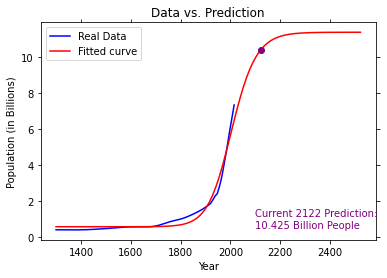

Iteration #9050, Loss: 0.05607400602011493


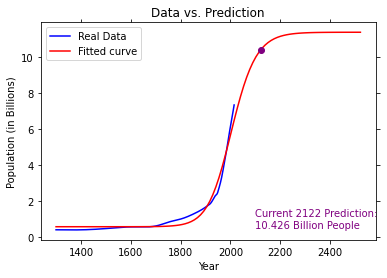

Iteration #9100, Loss: 0.05604868168230911


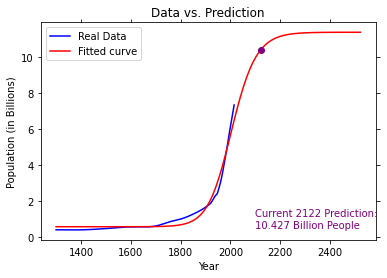

Iteration #9150, Loss: 0.05602364215051995


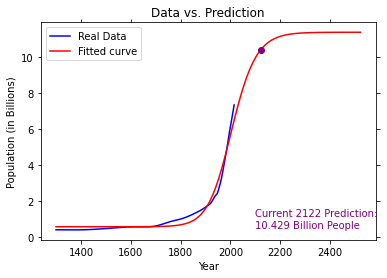

Iteration #9200, Loss: 0.05599888162828334


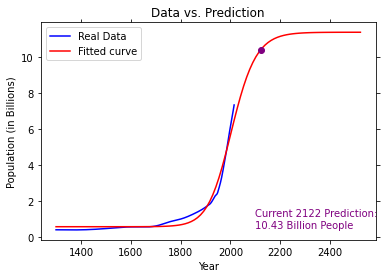

Iteration #9250, Loss: 0.05597439445464568


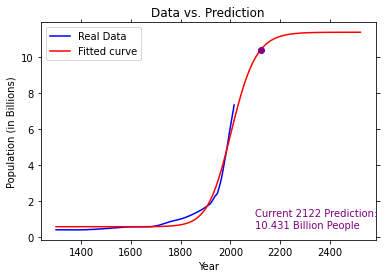

Iteration #9300, Loss: 0.05595017510062981


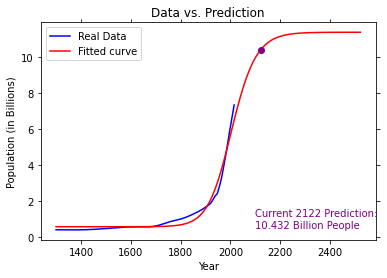

Iteration #9350, Loss: 0.05592621816580701


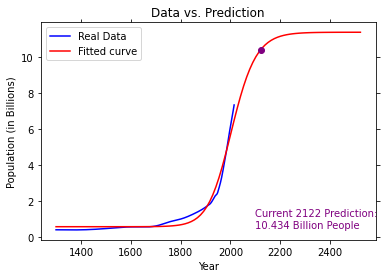

Iteration #9400, Loss: 0.055902518374966875


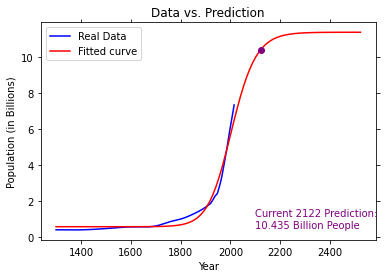

Iteration #9450, Loss: 0.05587907057488465


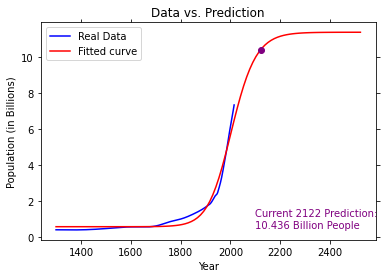

Iteration #9500, Loss: 0.05585586973118185


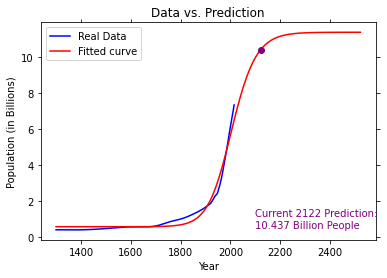

Iteration #9550, Loss: 0.05583291092527811


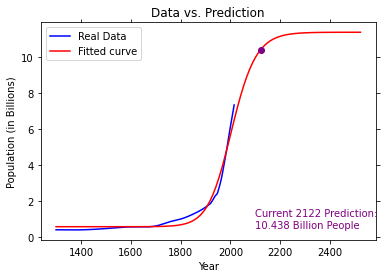

Iteration #9600, Loss: 0.05581018935142883


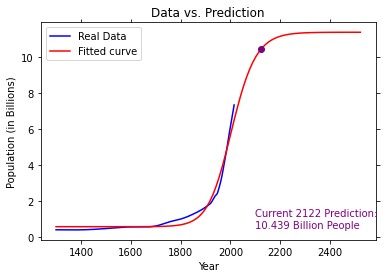

Iteration #9650, Loss: 0.05578770031384985


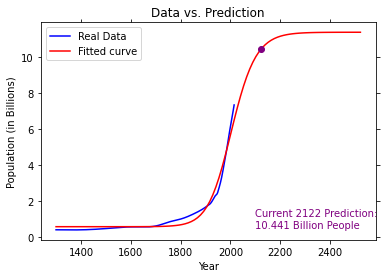

Iteration #9700, Loss: 0.055765439223922464


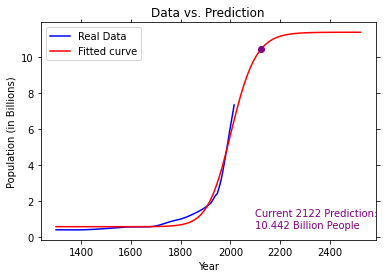

Iteration #9750, Loss: 0.05574340159747833


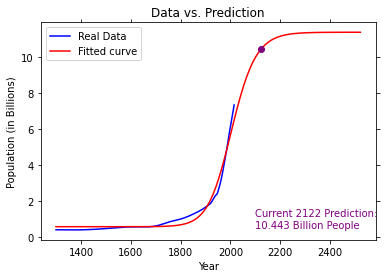

Iteration #9800, Loss: 0.055721583052162085


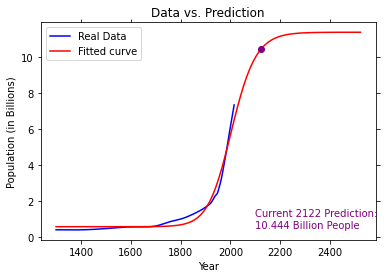

Iteration #9850, Loss: 0.055699979304867454


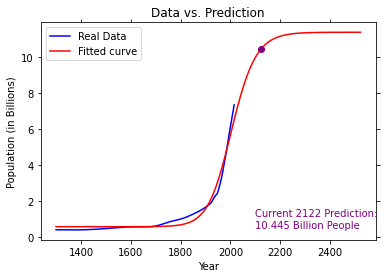

Iteration #9900, Loss: 0.055678586169245814


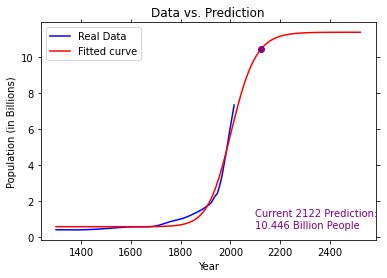

Iteration #9950, Loss: 0.0556573995532846


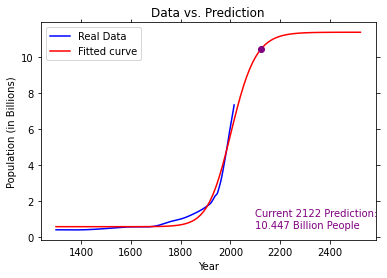

Iteration #10000, Loss: 0.055636415456954066


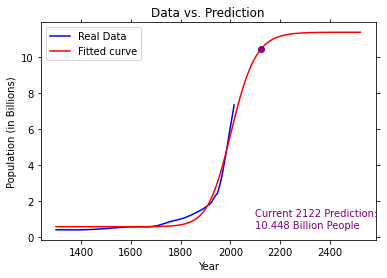

Iteration #10050, Loss: 0.05561562996991858


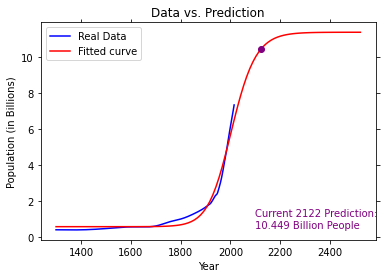

Iteration #10100, Loss: 0.05559503926931189


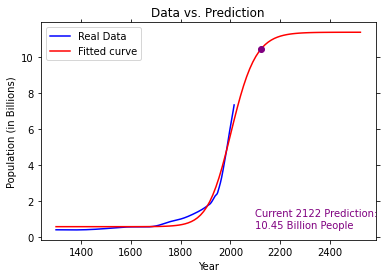

Iteration #10150, Loss: 0.05557463961757451


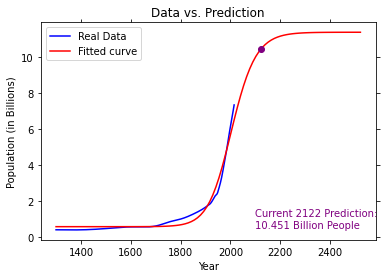

Iteration #10200, Loss: 0.0555544273603497


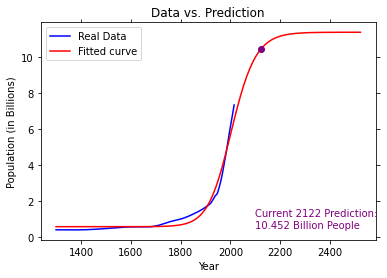

Iteration #10250, Loss: 0.05553439892443839


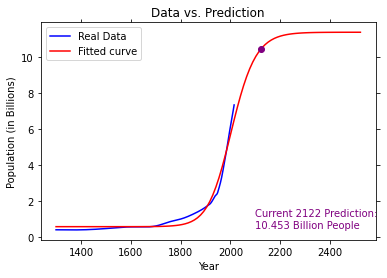

Iteration #10300, Loss: 0.05551455081580965


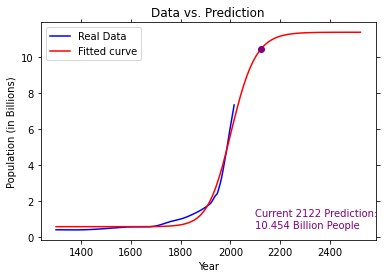

Iteration #10350, Loss: 0.05549487961766495


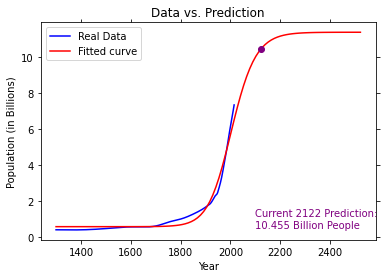

Iteration #10400, Loss: 0.055475381988556755


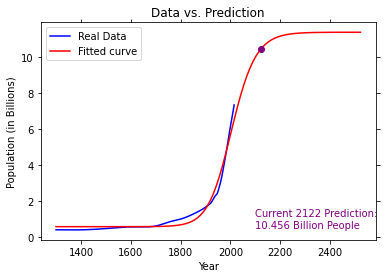

Iteration #10450, Loss: 0.05545605466055599


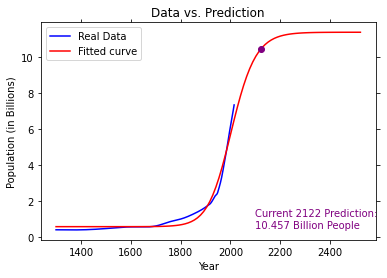

Iteration #10500, Loss: 0.05543689443747115


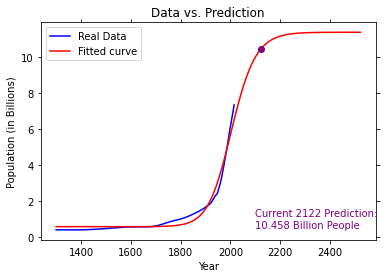

Iteration #10550, Loss: 0.05541789819311473


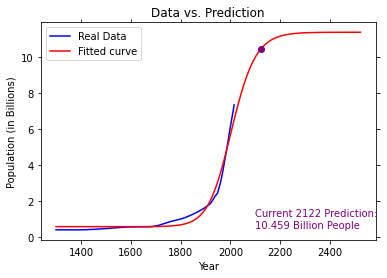

Iteration #10600, Loss: 0.055399062869615066


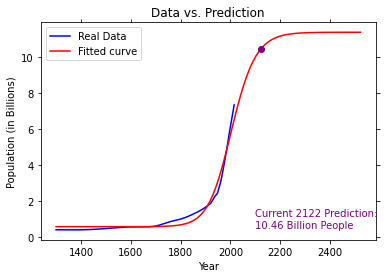

Iteration #10650, Loss: 0.055380385475775805


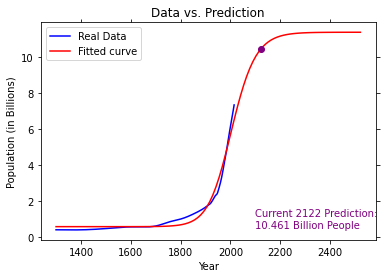

Iteration #10700, Loss: 0.05536186308547704


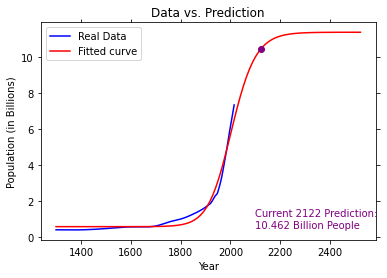

Iteration #10750, Loss: 0.055343492836120244


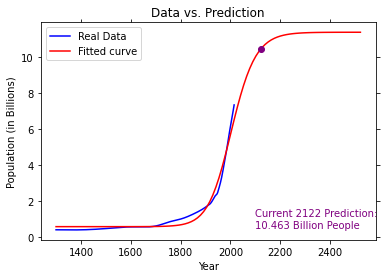

Iteration #10800, Loss: 0.055325271927114145


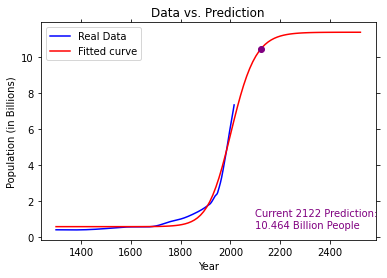

Iteration #10850, Loss: 0.05530719761840092


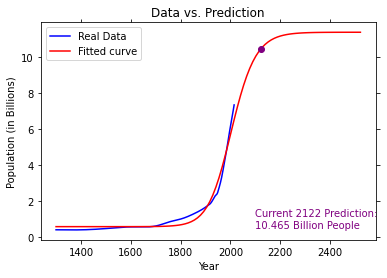

Iteration #10900, Loss: 0.055289267229020944


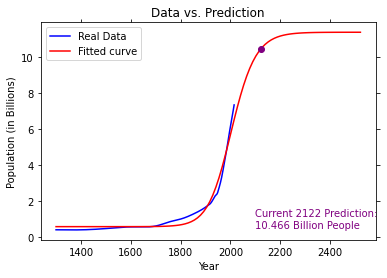

Iteration #10950, Loss: 0.055271478135715486


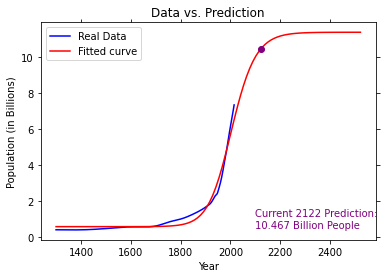

Iteration #11000, Loss: 0.055253827771566226


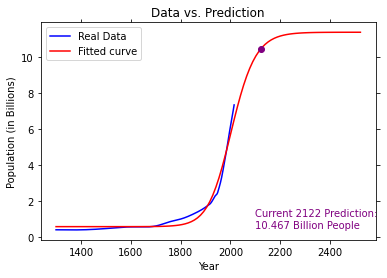

Iteration #11050, Loss: 0.05523631362467032


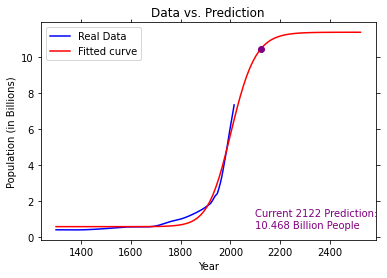

Iteration #11100, Loss: 0.05521893323684948


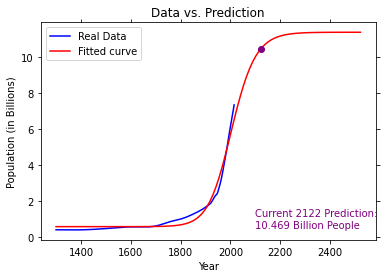

Iteration #11150, Loss: 0.05520168420239396


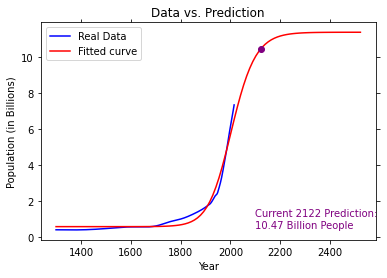

Iteration #11200, Loss: 0.05518456416683702


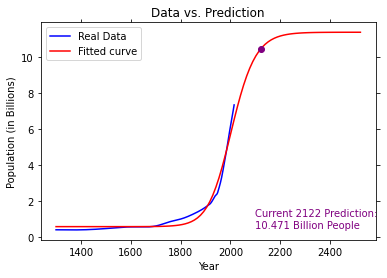

Iteration #11250, Loss: 0.05516757082576365


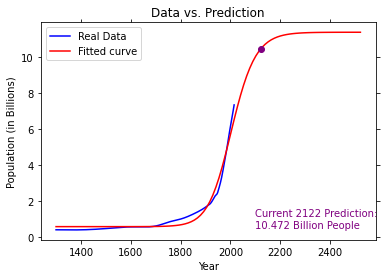

Iteration #11300, Loss: 0.055150701923647474


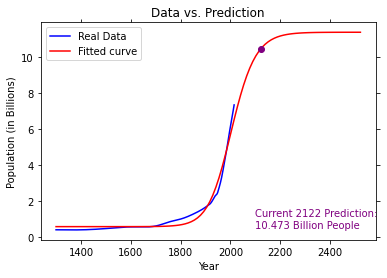

Iteration #11350, Loss: 0.05513395525271982


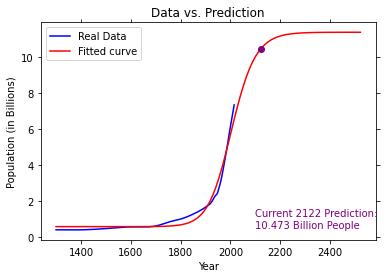

Iteration #11400, Loss: 0.05511732865186582


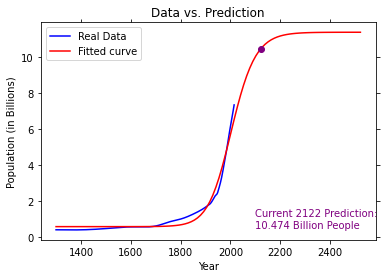

Iteration #11450, Loss: 0.05510082000554992


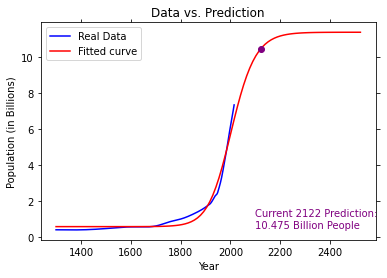

Iteration #11500, Loss: 0.05508442724276895


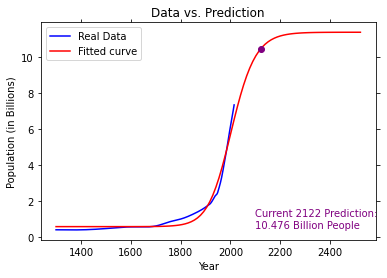

Iteration #11550, Loss: 0.055068148336030395


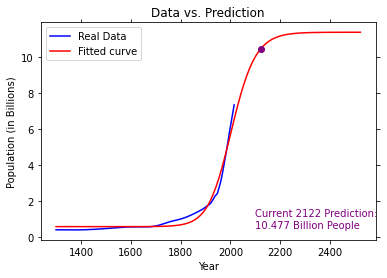

Iteration #11600, Loss: 0.055051981300358266


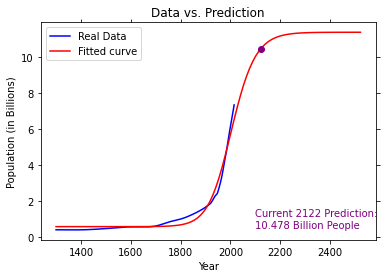

Iteration #11650, Loss: 0.05503592419232276


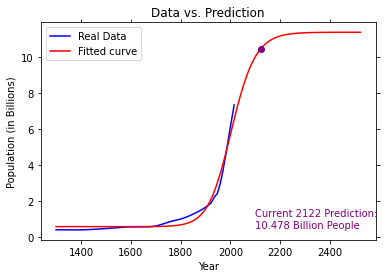

Iteration #11700, Loss: 0.05501997510909542


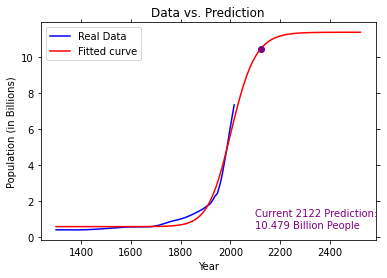

Iteration #11750, Loss: 0.0550041321875272


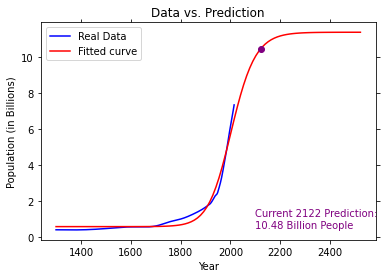

Iteration #11800, Loss: 0.054988393603250176


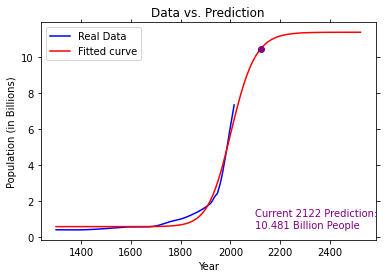

Iteration #11850, Loss: 0.05497275756980105


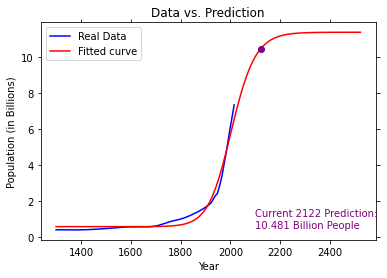

Iteration #11900, Loss: 0.05495722233776785


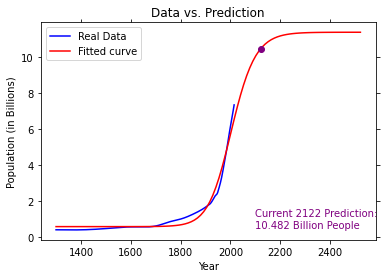

Iteration #11950, Loss: 0.054941786193955816


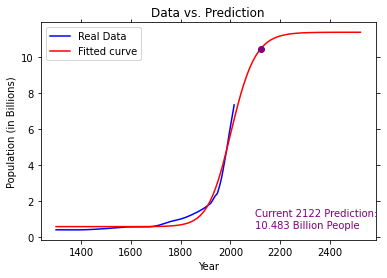

Iteration #12000, Loss: 0.054926447460576316


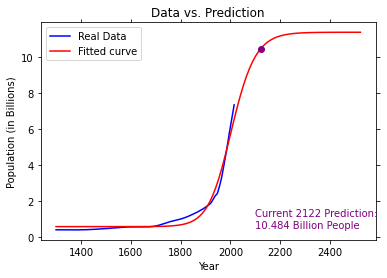

Iteration #12050, Loss: 0.054911204494453476


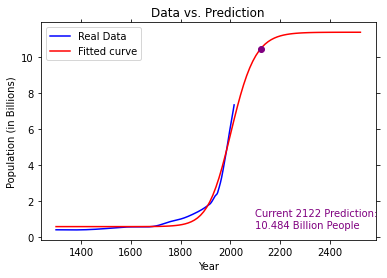

Iteration #12100, Loss: 0.05489605568625232


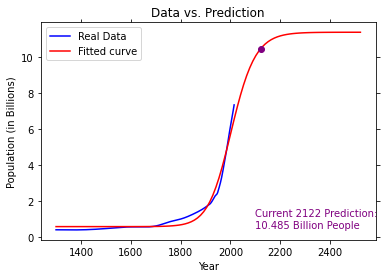

Iteration #12150, Loss: 0.054880999459724404


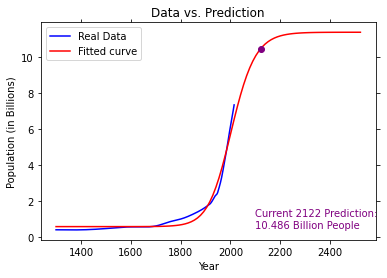

Iteration #12200, Loss: 0.05486603427097309


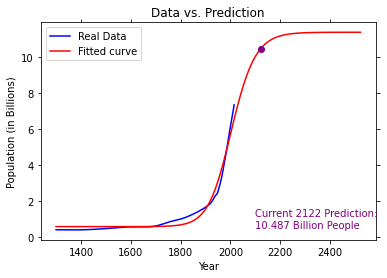

Iteration #12250, Loss: 0.05485115860773629


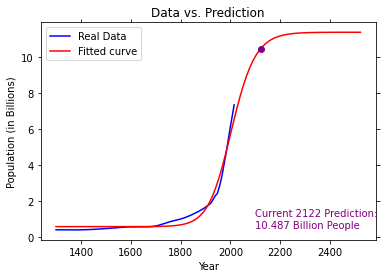

Iteration #12300, Loss: 0.05483637098868623


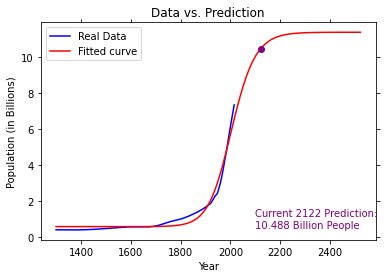

Iteration #12350, Loss: 0.054821669962747344


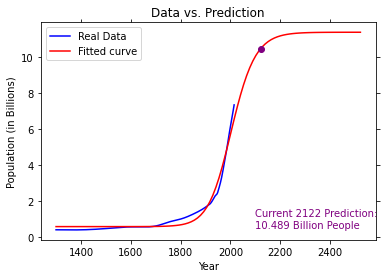

Iteration #12400, Loss: 0.05480705410842964


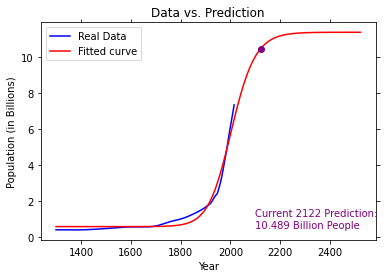

Iteration #12450, Loss: 0.05479252203317922


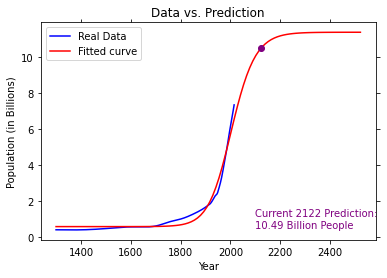

Iteration #12500, Loss: 0.05477807237274323


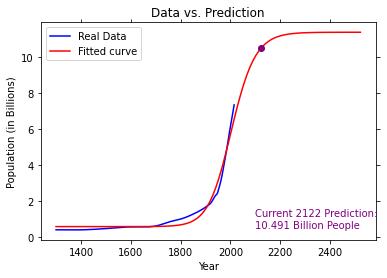

Iteration #12550, Loss: 0.05476370379055141


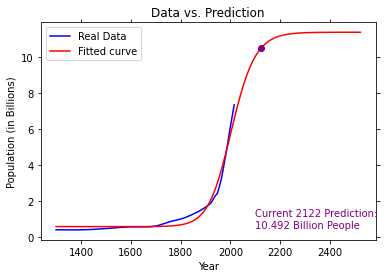

Iteration #12600, Loss: 0.05474941497711187


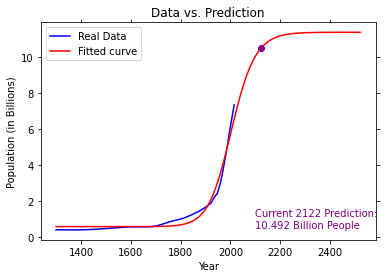

Iteration #12650, Loss: 0.05473520464942101


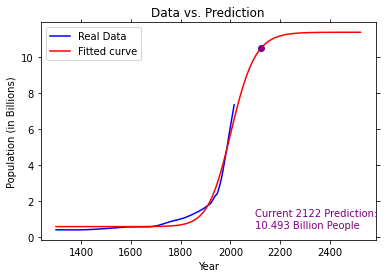

Iteration #12700, Loss: 0.05472107155038813


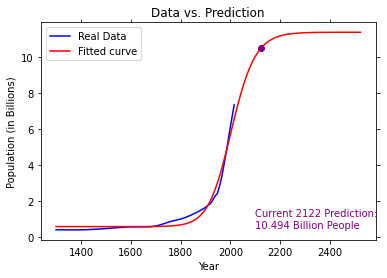

Iteration #12750, Loss: 0.054707014448273625


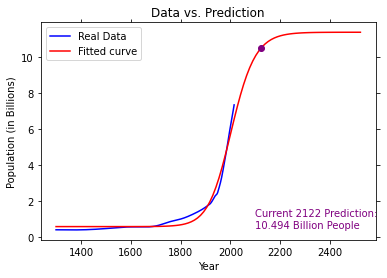

Iteration #12800, Loss: 0.05469303213614025


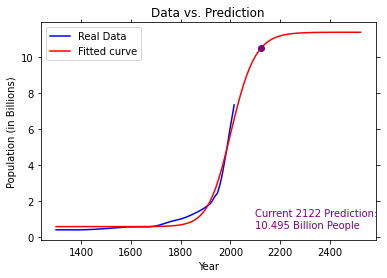

Iteration #12850, Loss: 0.05467912343131788


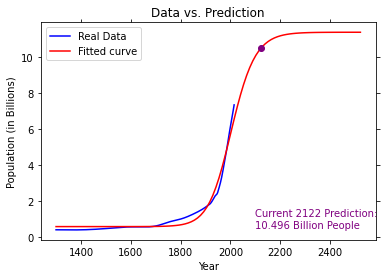

Iteration #12900, Loss: 0.05466528717488029


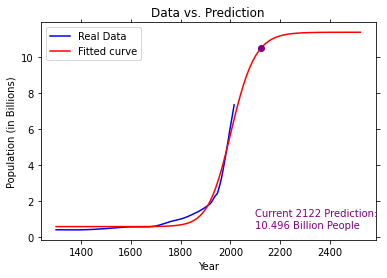

Iteration #12950, Loss: 0.05465152223113501


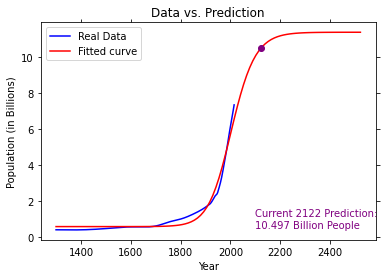

Iteration #13000, Loss: 0.054637827487124625


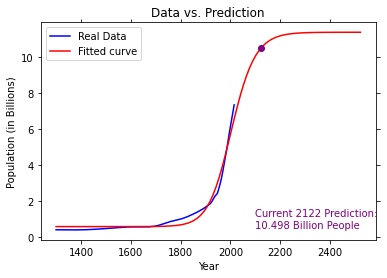

Iteration #13050, Loss: 0.05462420185213998


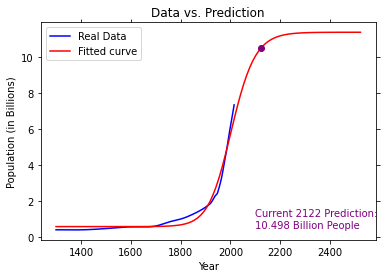

Iteration #13100, Loss: 0.05461064425724477


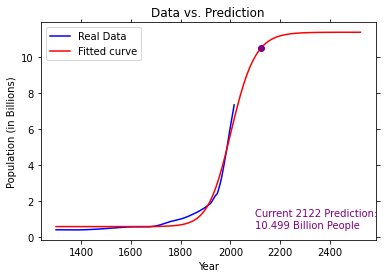

Iteration #13150, Loss: 0.054597153654811666


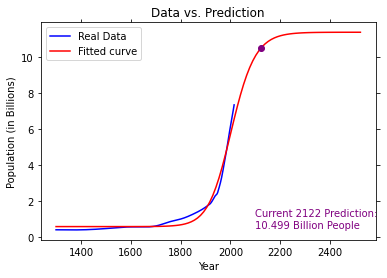

Iteration #13200, Loss: 0.05458372901806832


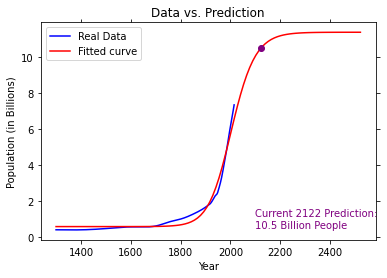

Iteration #13250, Loss: 0.05457036934065495


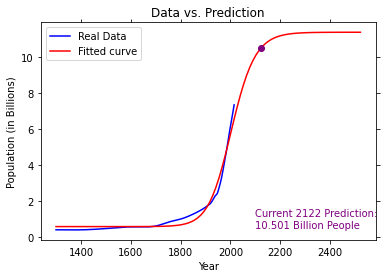

Iteration #13300, Loss: 0.05455707363619133


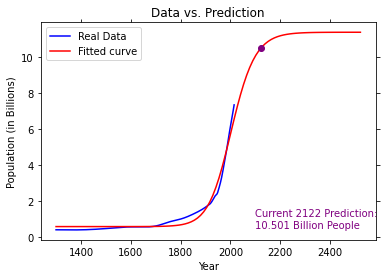

Iteration #13350, Loss: 0.05454384093785448


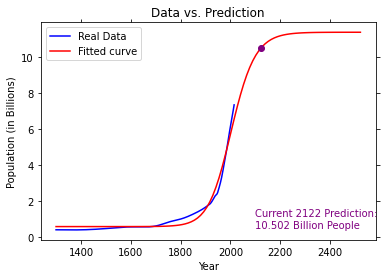

Iteration #13400, Loss: 0.05453067029796572


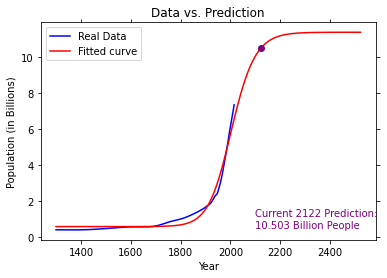

Iteration #13450, Loss: 0.05451756078758752


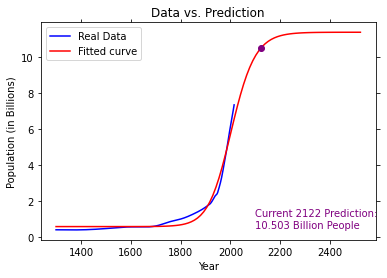

Iteration #13500, Loss: 0.0545045114961289


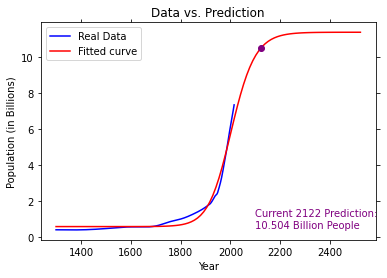

Iteration #13550, Loss: 0.05449152153096115


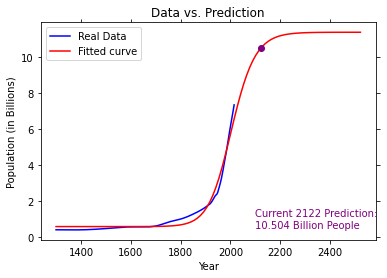

Iteration #13600, Loss: 0.05447859001704124


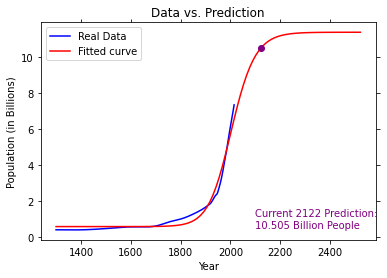

Iteration #13650, Loss: 0.05446571609654406


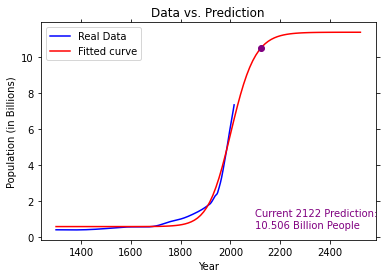

Iteration #13700, Loss: 0.05445289892850365


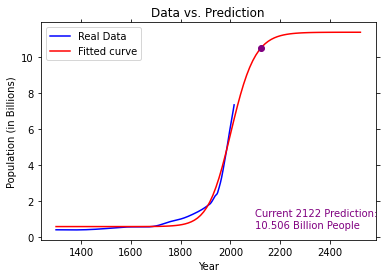

Iteration #13750, Loss: 0.05444013768846162


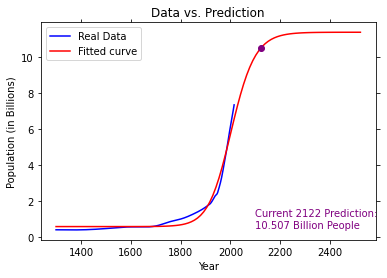

Iteration #13800, Loss: 0.05442743156812436


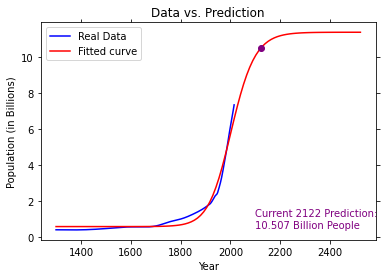

Iteration #13850, Loss: 0.05441477977502771


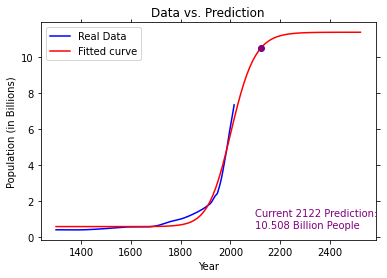

Iteration #13900, Loss: 0.05440218153220881


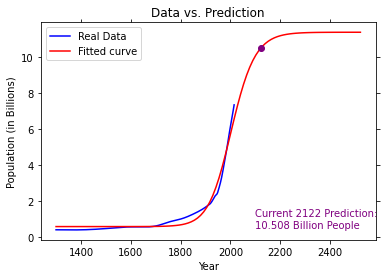

Iteration #13950, Loss: 0.054389636077886355


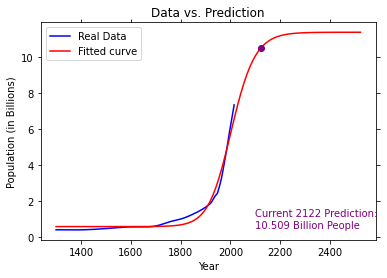

Iteration #14000, Loss: 0.05437714266514644


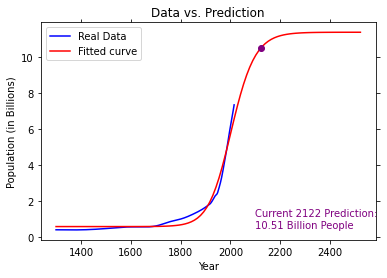

Iteration #14050, Loss: 0.05436470056163751


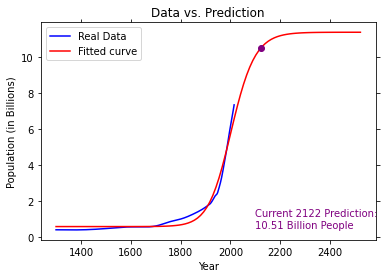

Iteration #14100, Loss: 0.05435230904927012


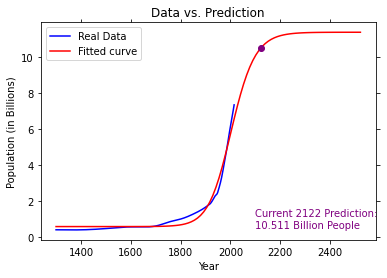

Iteration #14150, Loss: 0.054339967423924954


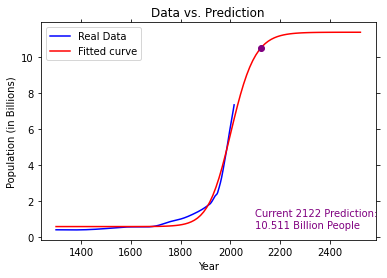

Iteration #14200, Loss: 0.054327674995166


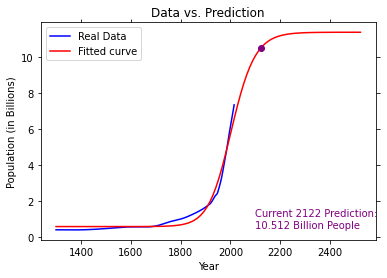

Iteration #14250, Loss: 0.054315431085961374


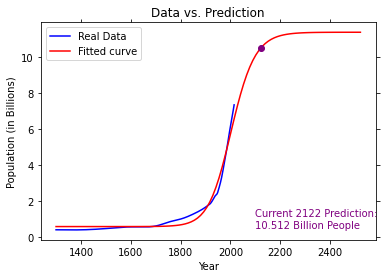

Iteration #14300, Loss: 0.05430323503240959


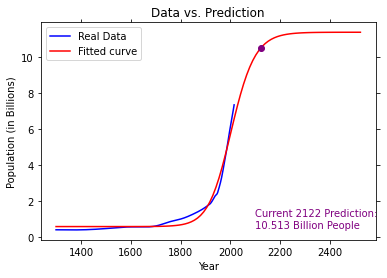

Iteration #14350, Loss: 0.05429108618347214


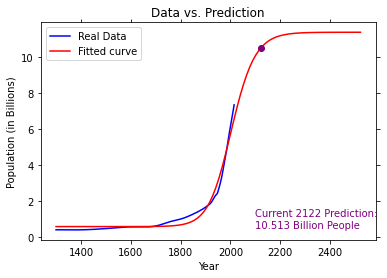

Iteration #14400, Loss: 0.054278983900711515


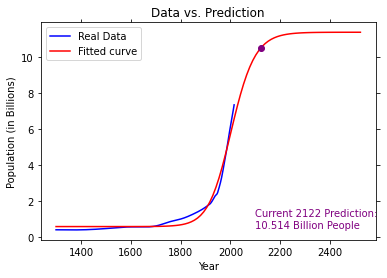

Iteration #14450, Loss: 0.05426692755803605


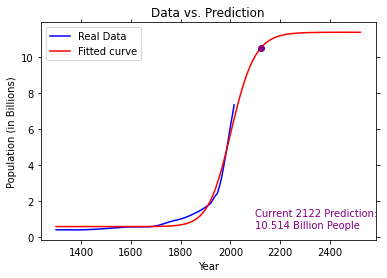

Iteration #14500, Loss: 0.054254916541448886


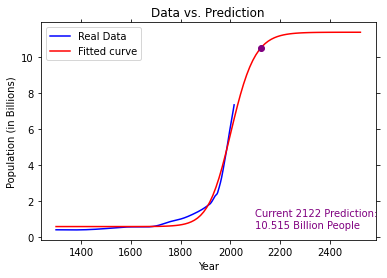

Iteration #14550, Loss: 0.05424295024880412


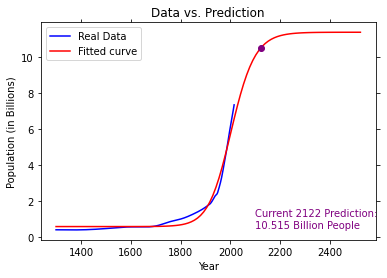

Iteration #14600, Loss: 0.054231028089566605


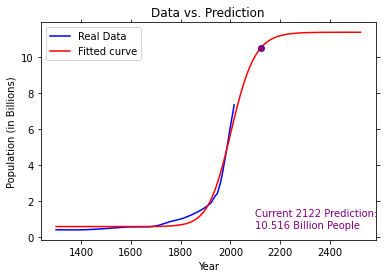

Iteration #14650, Loss: 0.054219149484578705


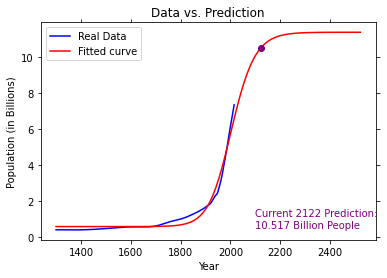

Iteration #14700, Loss: 0.05420731386583052


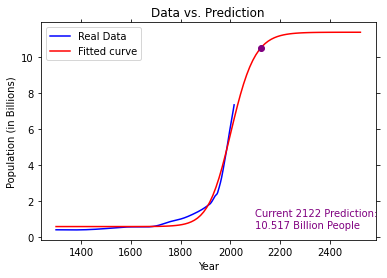

Iteration #14750, Loss: 0.054195520676236404


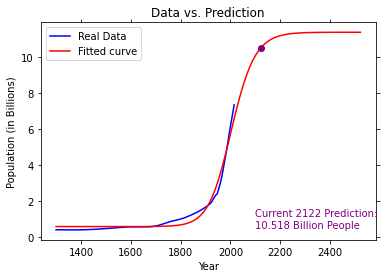

Iteration #14800, Loss: 0.05418376936941526


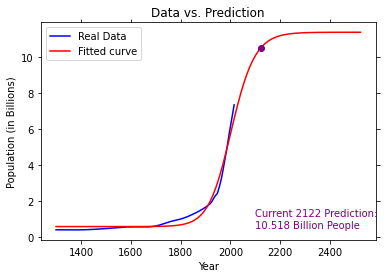

Iteration #14850, Loss: 0.05417205940947657


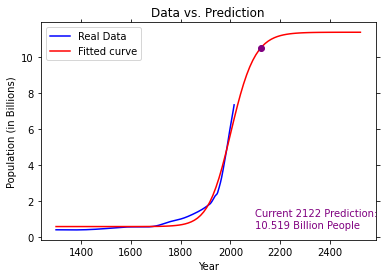

Iteration #14900, Loss: 0.05416039027081074


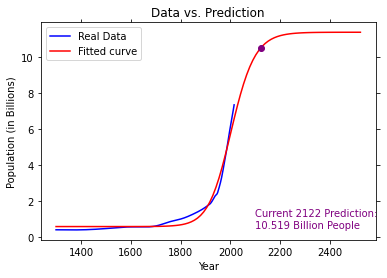

Iteration #14950, Loss: 0.05414876143788314


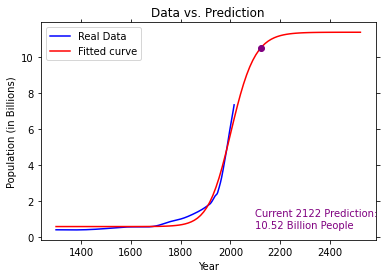

Iteration #15000, Loss: 0.05413717240503399


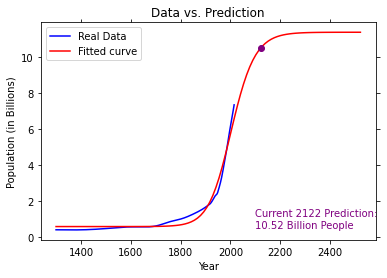

Iteration #15050, Loss: 0.05412562267628166


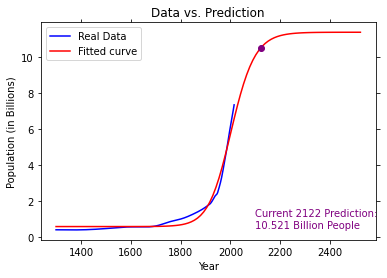

Iteration #15100, Loss: 0.05411411176513001


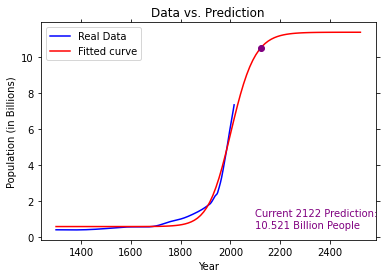

Iteration #15150, Loss: 0.05410263919438085


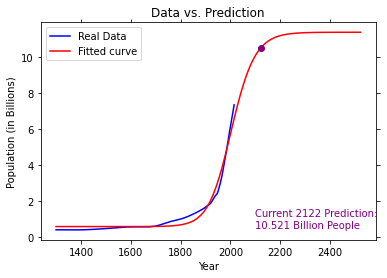

Iteration #15200, Loss: 0.05409120449594918


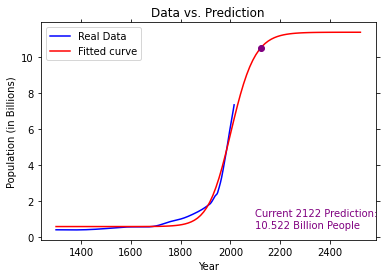

Iteration #15250, Loss: 0.05407980721068347


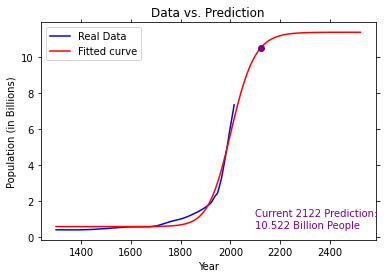

Iteration #15300, Loss: 0.05406844688818864


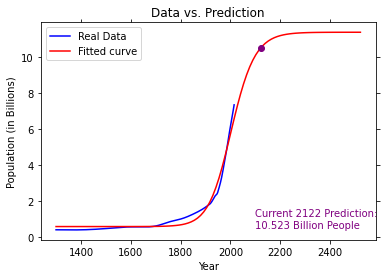

Iteration #15350, Loss: 0.05405712308665447


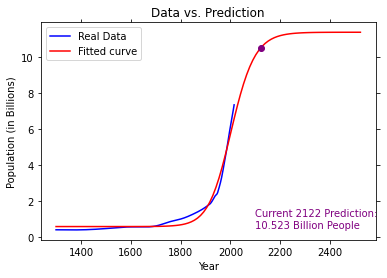

Iteration #15400, Loss: 0.05404583537268535


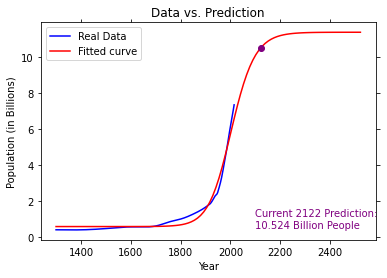

Iteration #15450, Loss: 0.054034583321135844


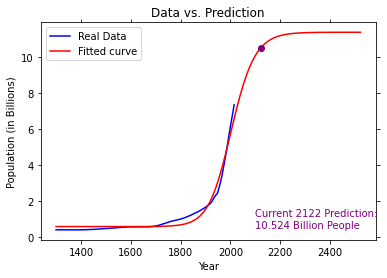

Iteration #15500, Loss: 0.05402336651494835


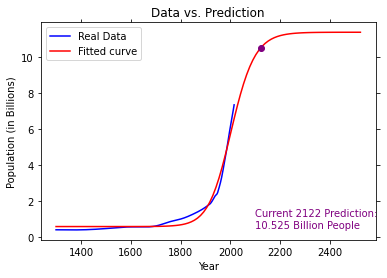

Iteration #15550, Loss: 0.05401218454499466


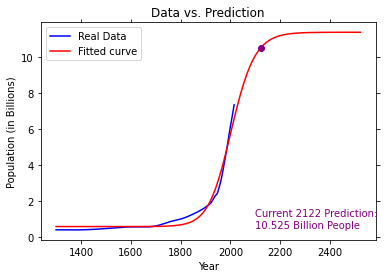

Iteration #15600, Loss: 0.054001037009920996


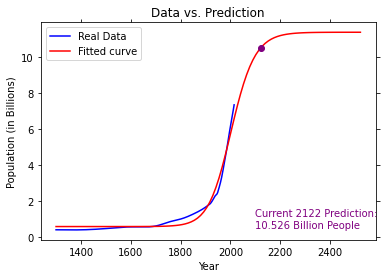

Iteration #15650, Loss: 0.053989923515995734


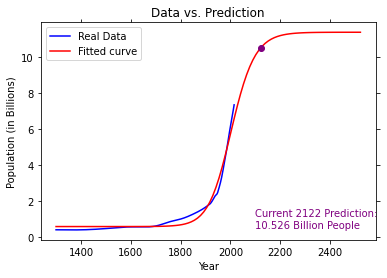

Iteration #15700, Loss: 0.053978843676961104


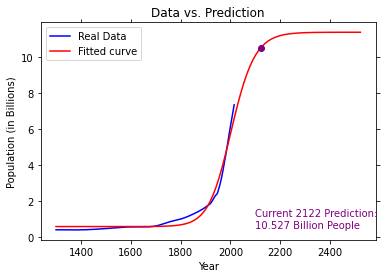

Iteration #15750, Loss: 0.053967797113887245


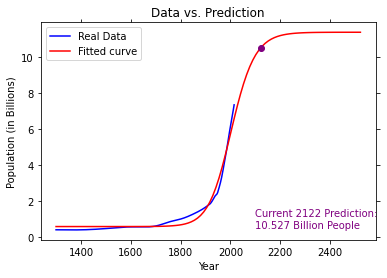

Iteration #15800, Loss: 0.05395678345502983


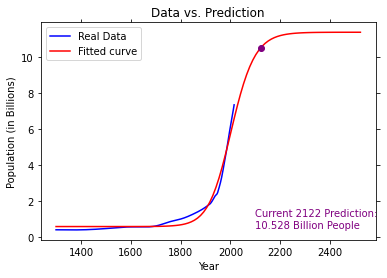

Iteration #15850, Loss: 0.05394580233569043


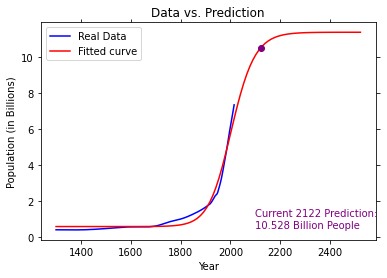

Iteration #15900, Loss: 0.05393485339808019


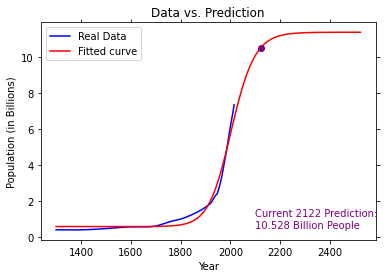

Iteration #15950, Loss: 0.05392393629118493


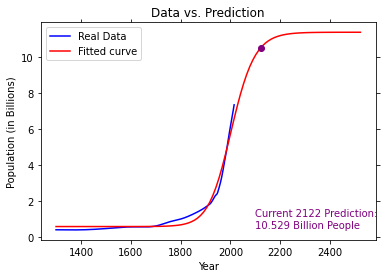

Iteration #16000, Loss: 0.05391305067063538


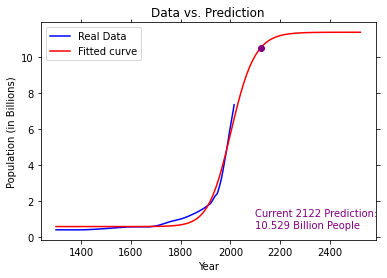

Iteration #16050, Loss: 0.05390219619857775


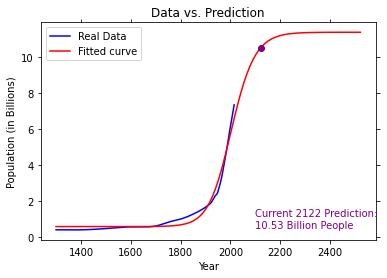

Iteration #16100, Loss: 0.05389137254354937


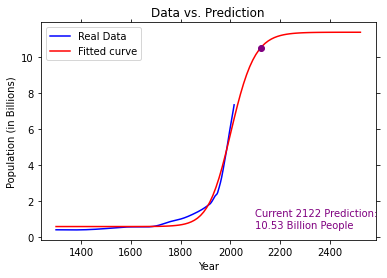

Iteration #16150, Loss: 0.053880579380353594


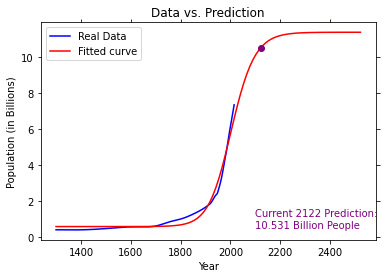

Iteration #16200, Loss: 0.05386981638994097


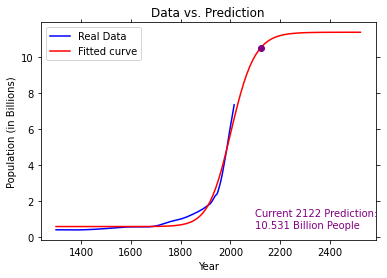

Iteration #16250, Loss: 0.053859083259290445


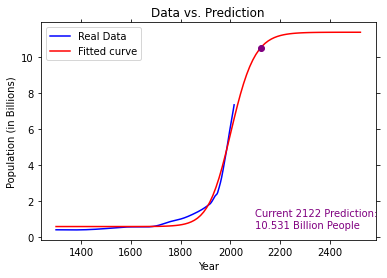

Iteration #16300, Loss: 0.05384837968129349


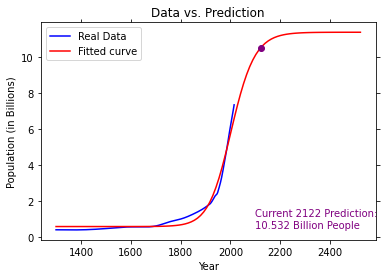

Iteration #16350, Loss: 0.05383770535464132


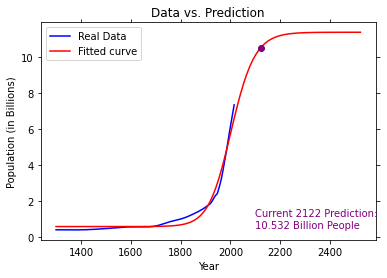

Iteration #16400, Loss: 0.05382705998371368


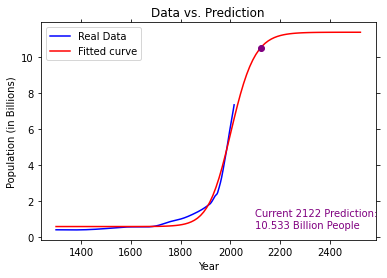

Iteration #16450, Loss: 0.05381644327846973


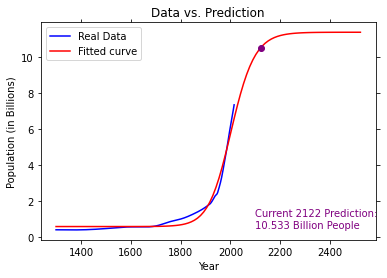

Iteration #16500, Loss: 0.05380585495434202


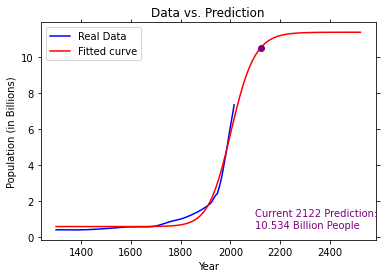

Iteration #16550, Loss: 0.05379529473213194


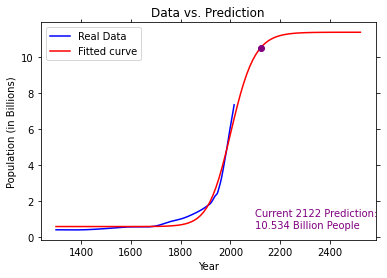

Iteration #16600, Loss: 0.053784762337907625


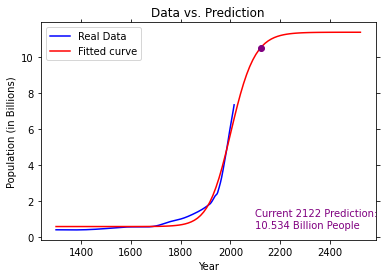

Iteration #16650, Loss: 0.053774257502903586


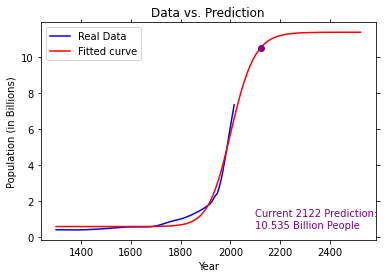

Iteration #16700, Loss: 0.0537637799634228


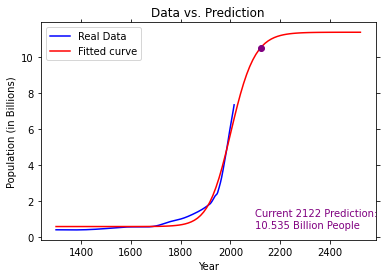

Iteration #16750, Loss: 0.05375332946074028


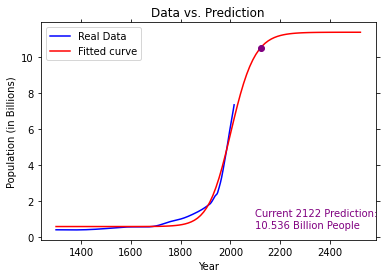

Iteration #16800, Loss: 0.05374290574100906


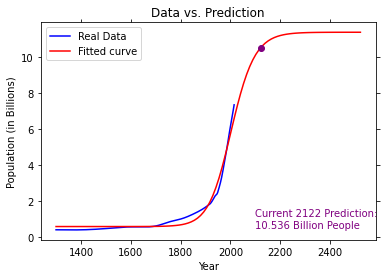

Iteration #16850, Loss: 0.05373250855516806


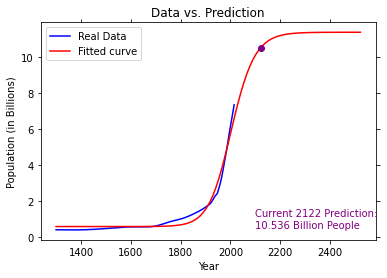

Iteration #16900, Loss: 0.053722137658851046


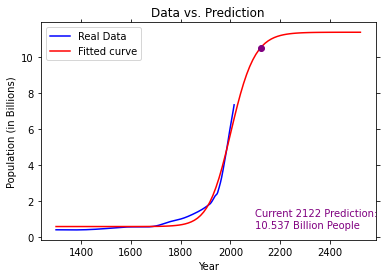

Iteration #16950, Loss: 0.053711792812298535


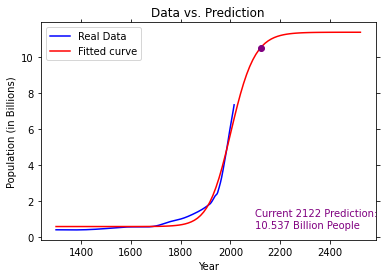

Iteration #17000, Loss: 0.05370147378027068


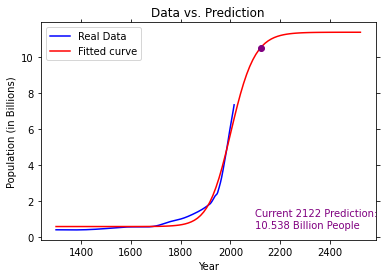

Iteration #17050, Loss: 0.05369118033196226


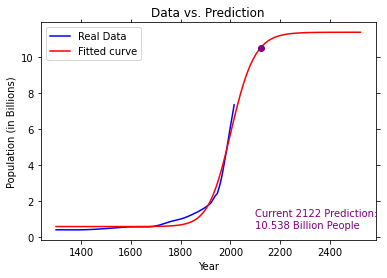

Iteration #17100, Loss: 0.053680912240918956


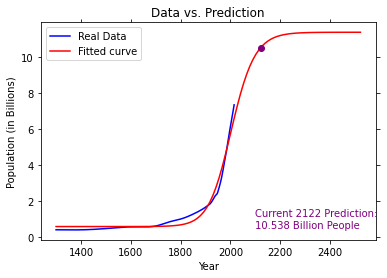

Iteration #17150, Loss: 0.05367066928495589


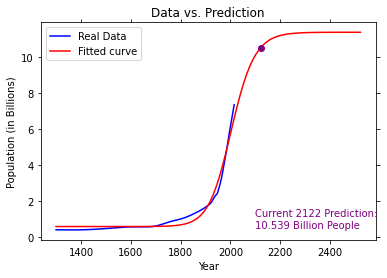

Iteration #17200, Loss: 0.05366045124607741


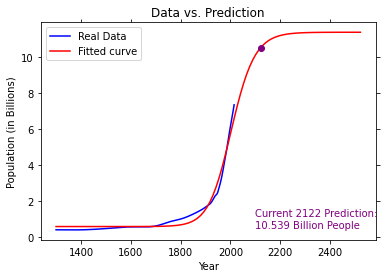

Iteration #17250, Loss: 0.053650257910398375


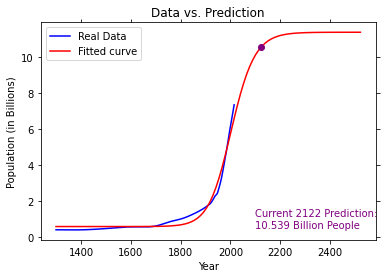

Iteration #17300, Loss: 0.053640089068067345


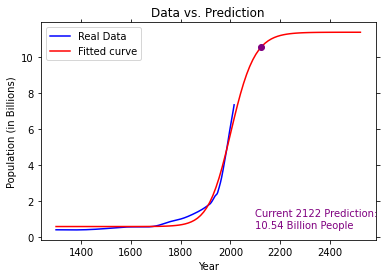

Iteration #17350, Loss: 0.05362994451319092


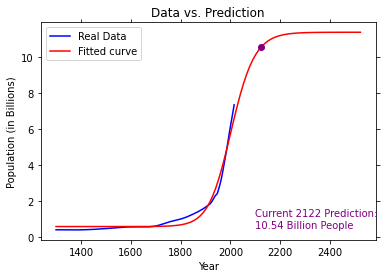

Iteration #17400, Loss: 0.05361982404376005


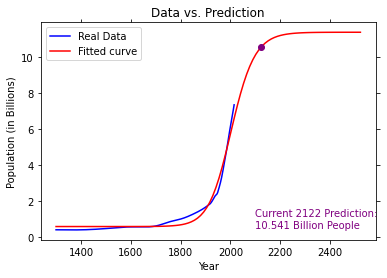

Iteration #17450, Loss: 0.05360972746157703


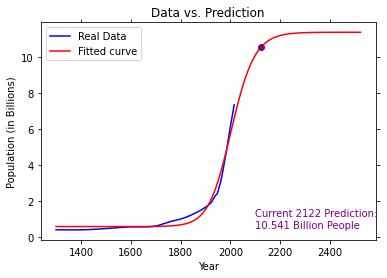

Iteration #17500, Loss: 0.05359965457218511


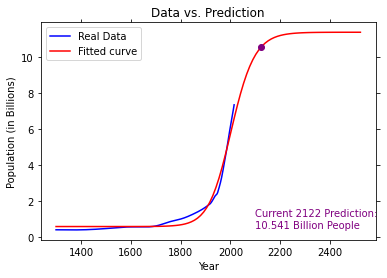

Iteration #17550, Loss: 0.05358960518479761


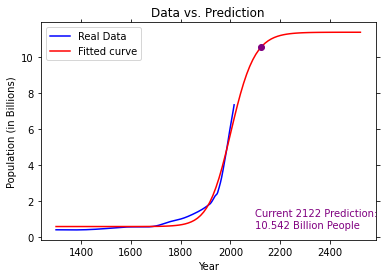

Iteration #17600, Loss: 0.0535795791122314


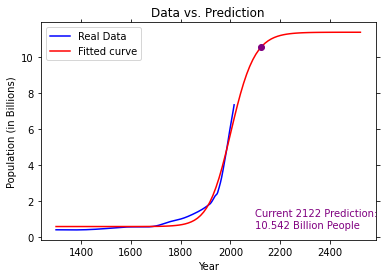

Iteration #17650, Loss: 0.05356957617083816


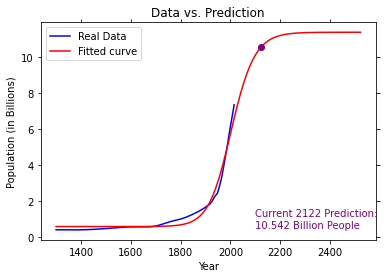

Iteration #17700, Loss: 0.05355959618043971


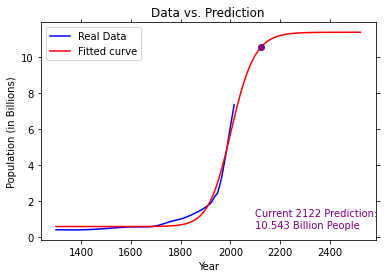

Iteration #17750, Loss: 0.05354963896426318


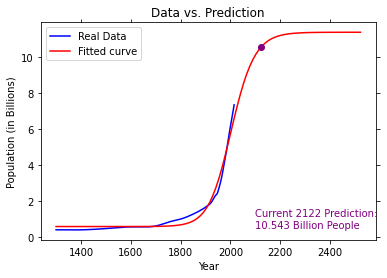

Iteration #17800, Loss: 0.05353970434887817


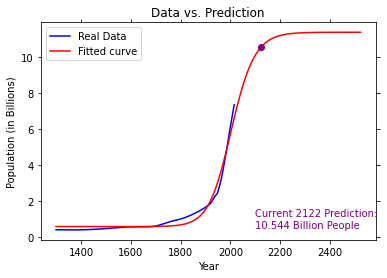

Iteration #17850, Loss: 0.05352979216413457


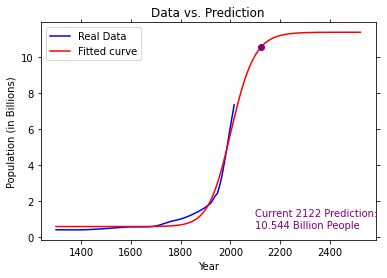

Iteration #17900, Loss: 0.05351990224310204


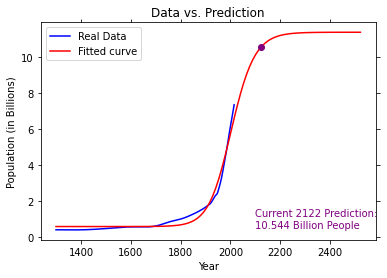

Iteration #17950, Loss: 0.05351003442201053


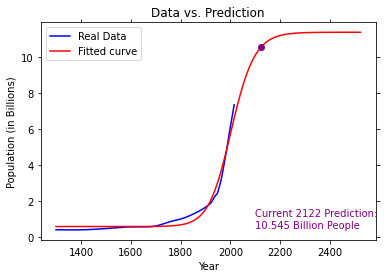

Iteration #18000, Loss: 0.0535001885401917


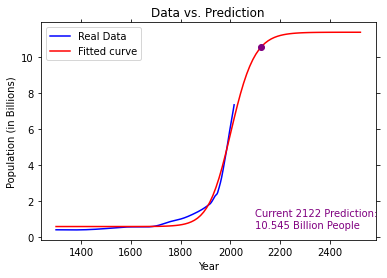

Iteration #18050, Loss: 0.05349036444002187


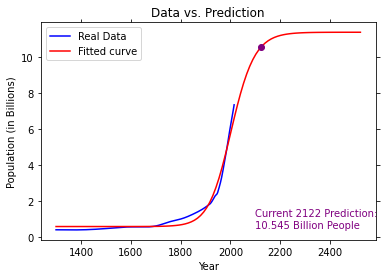

Iteration #18100, Loss: 0.05348056196686583


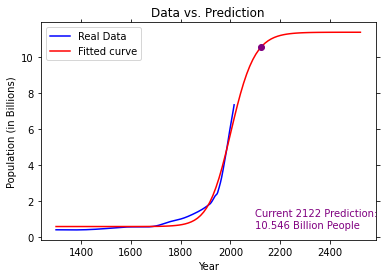

Iteration #18150, Loss: 0.05347078096902173


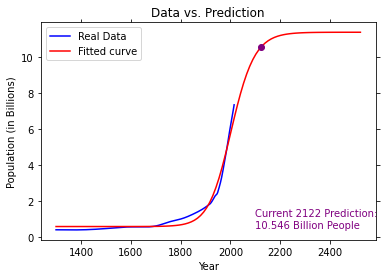

Iteration #18200, Loss: 0.0534610212976674


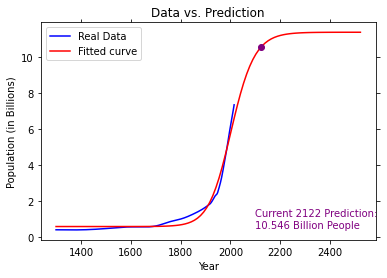

Iteration #18250, Loss: 0.053451282806806846


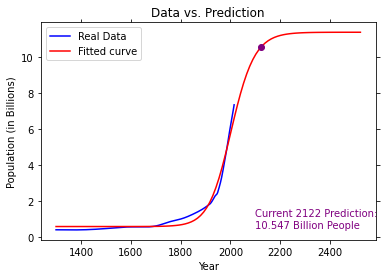

Iteration #18300, Loss: 0.05344156535321885


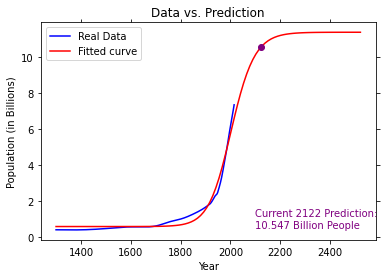

Iteration #18350, Loss: 0.053431868796405865


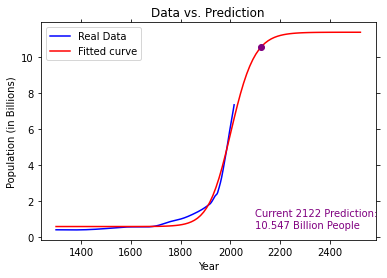

Iteration #18400, Loss: 0.0534221929985439


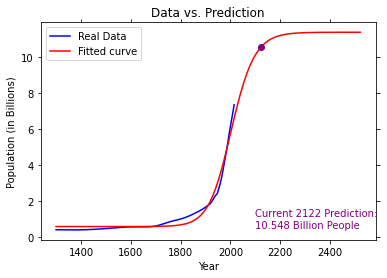

Iteration #18450, Loss: 0.05341253782443386


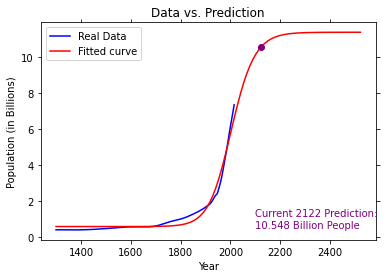

Iteration #18500, Loss: 0.05340290314145323


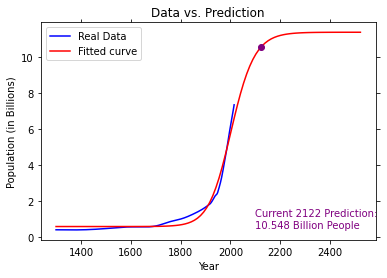

Iteration #18550, Loss: 0.05339328881950881


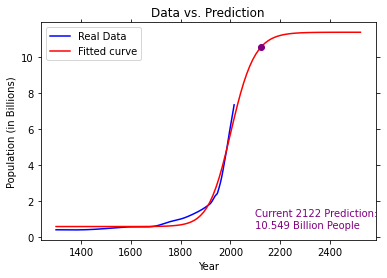

Iteration #18600, Loss: 0.05338369473099093


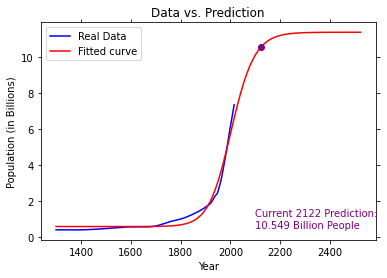

Iteration #18650, Loss: 0.05337412075072783


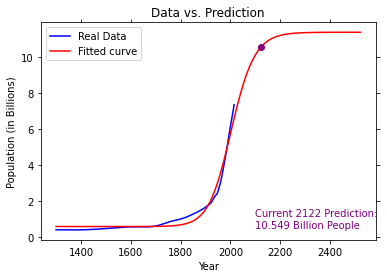

Iteration #18700, Loss: 0.05336456675594098


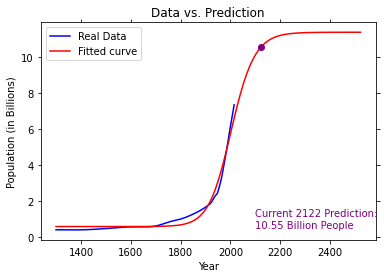

Iteration #18750, Loss: 0.053355032626201296


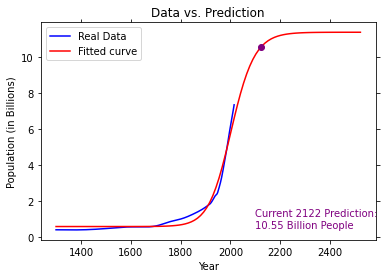

Iteration #18800, Loss: 0.053345518243387506


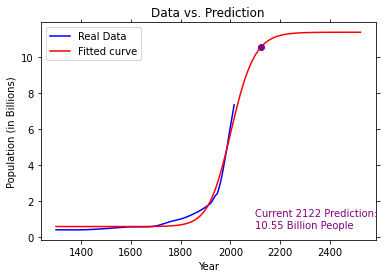

Iteration #18850, Loss: 0.05333602349164252


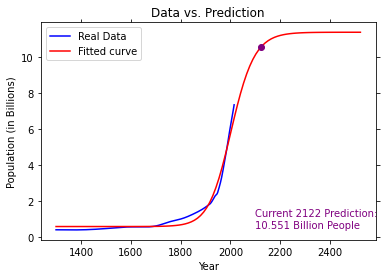

Iteration #18900, Loss: 0.05332654825733305


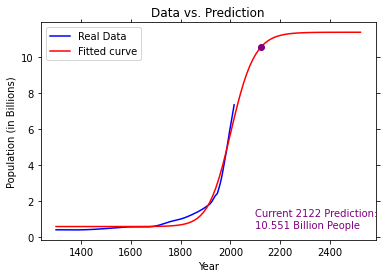

Iteration #18950, Loss: 0.05331709242900926


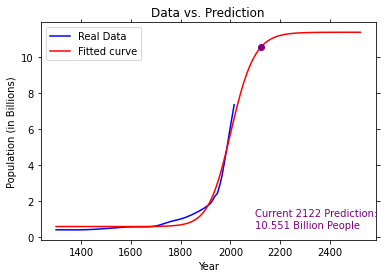

Iteration #19000, Loss: 0.05330765589736476


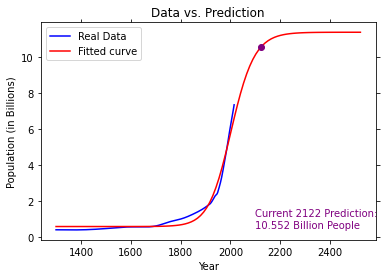

Iteration #19050, Loss: 0.053298238555197726


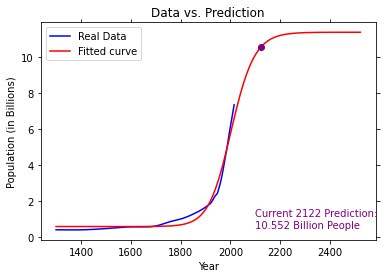

Iteration #19100, Loss: 0.053288840297372804


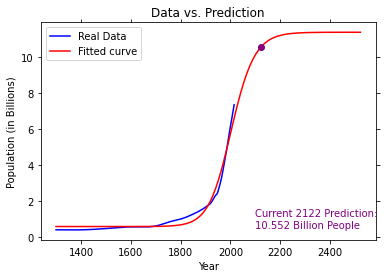

Iteration #19150, Loss: 0.05327946102078372


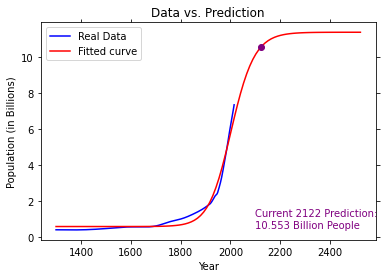

Iteration #19200, Loss: 0.05327010062431601


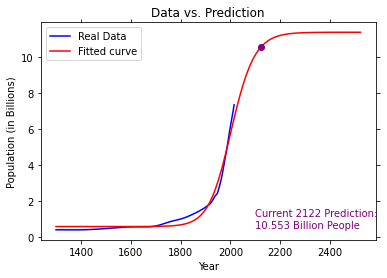

Iteration #19250, Loss: 0.05326075900881173


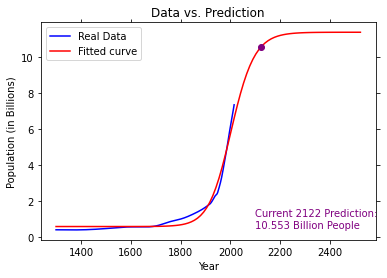

Iteration #19300, Loss: 0.05325143607703316


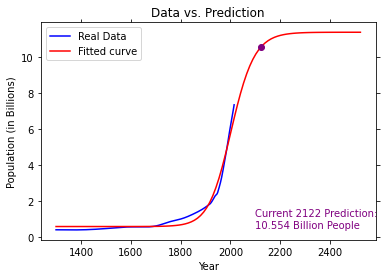

Iteration #19350, Loss: 0.05324213173362878


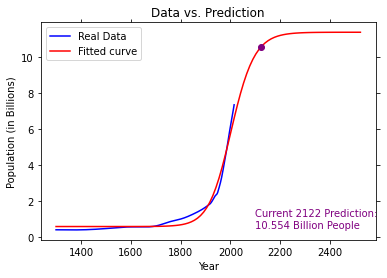

Iteration #19400, Loss: 0.05323284588509871


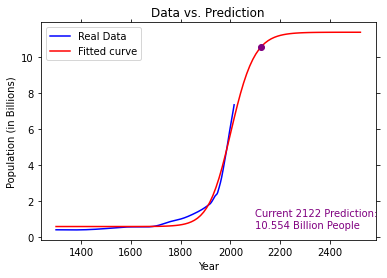

Iteration #19450, Loss: 0.05322357843976134


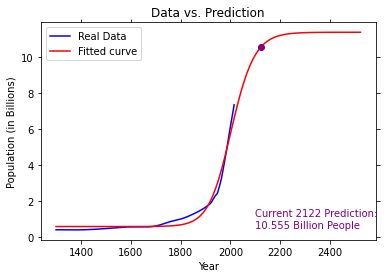

Iteration #19500, Loss: 0.05321432930772076


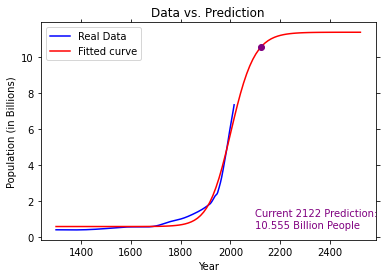

Iteration #19550, Loss: 0.05320509840083399


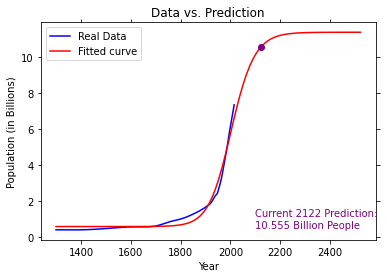

Iteration #19600, Loss: 0.05319588563267988


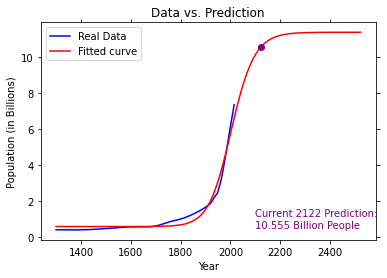

Iteration #19650, Loss: 0.053186690918527624


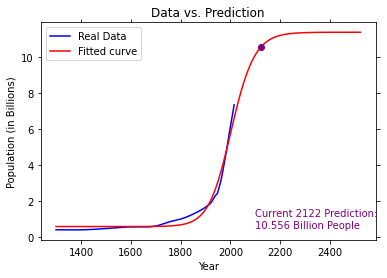

Iteration #19700, Loss: 0.0531775141753066


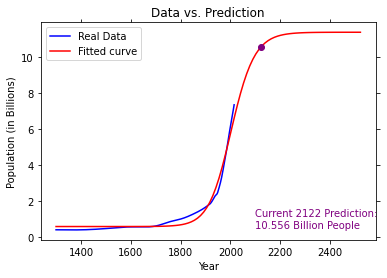

Iteration #19750, Loss: 0.053168355321576245


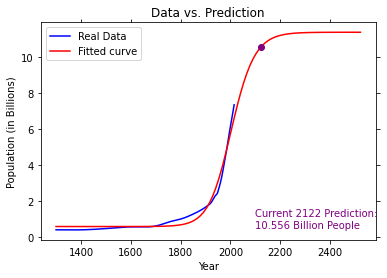

Iteration #19800, Loss: 0.05315921427749676


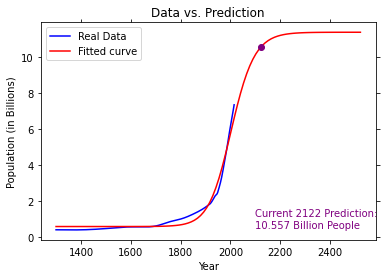

Iteration #19850, Loss: 0.05315009096480043


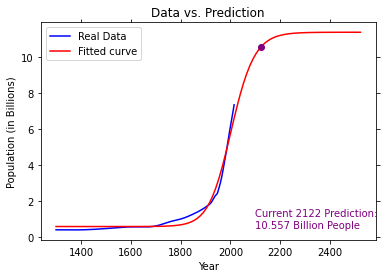

Iteration #19900, Loss: 0.053140985306763026


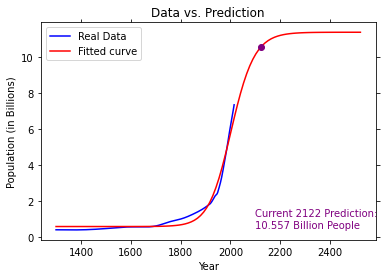

Iteration #19950, Loss: 0.05313189722817636


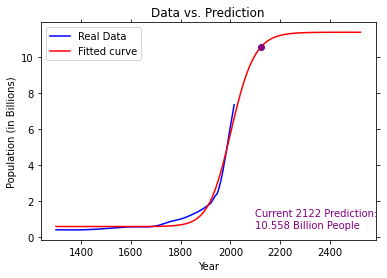

Iteration #20000, Loss: 0.05312282665532076


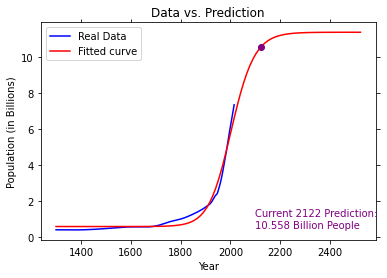

Iteration #20050, Loss: 0.053113773515938434


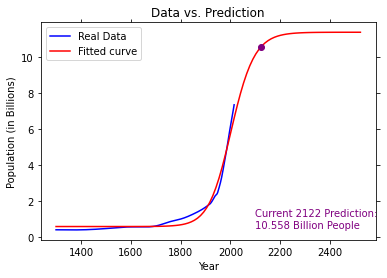

Iteration #20100, Loss: 0.05310473773920736


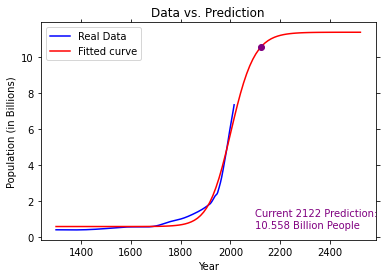

Iteration #20150, Loss: 0.05309571925571514


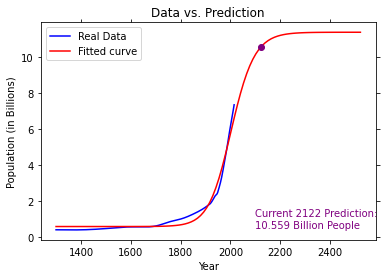

Iteration #20200, Loss: 0.05308671799743395


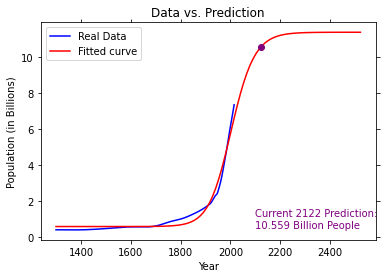

Iteration #20250, Loss: 0.053077733897695545


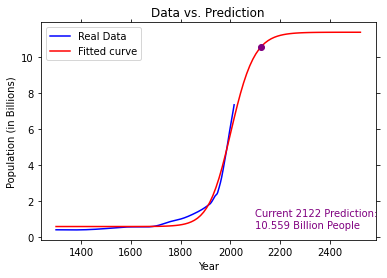

Iteration #20300, Loss: 0.053068766891167074


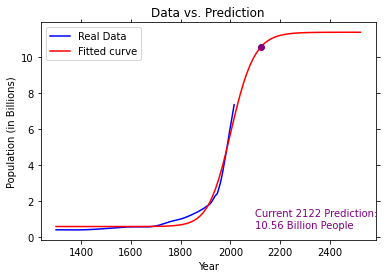

Iteration #20350, Loss: 0.05305981691382691


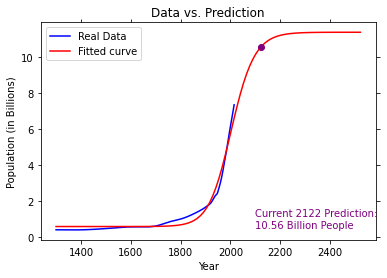

Iteration #20400, Loss: 0.05305088390294111


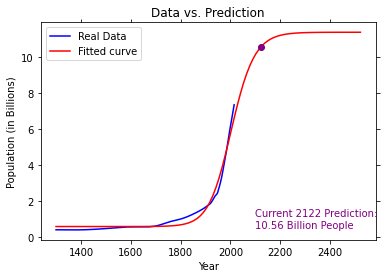

Iteration #20450, Loss: 0.0530419677970405


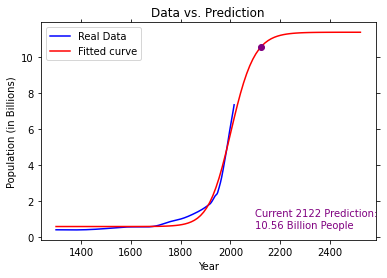

Iteration #20500, Loss: 0.05303306853589788


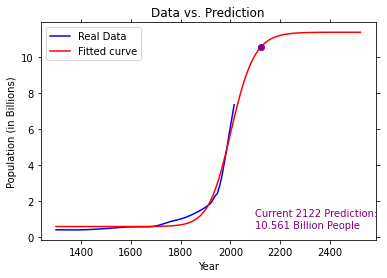

Iteration #20550, Loss: 0.05302418606050578


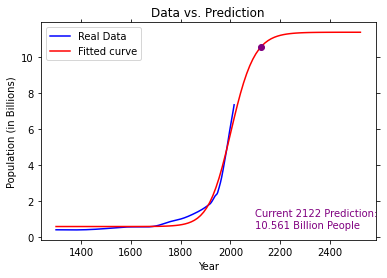

Iteration #20600, Loss: 0.05301532031305473


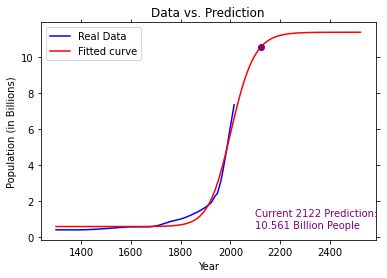

Iteration #20650, Loss: 0.05300647123691156


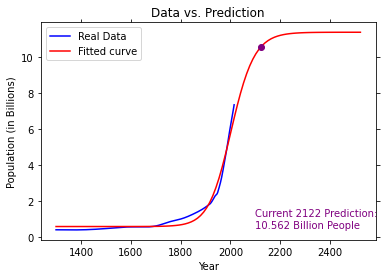

Iteration #20700, Loss: 0.05299763877659847


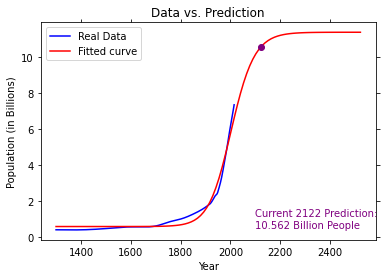

Iteration #20750, Loss: 0.05298882287777239


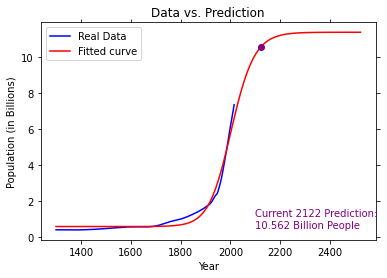

Iteration #20800, Loss: 0.05298002348720452


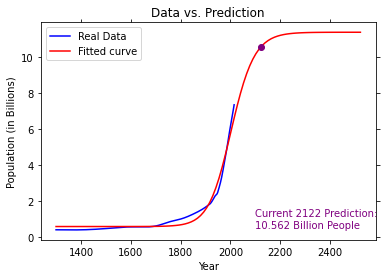

Iteration #20850, Loss: 0.05297124055276051


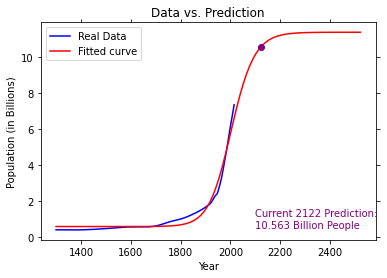

Iteration #20900, Loss: 0.052962474023380585


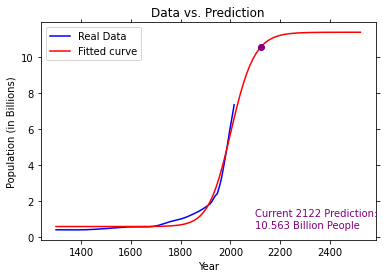

Iteration #20950, Loss: 0.05295372384906093


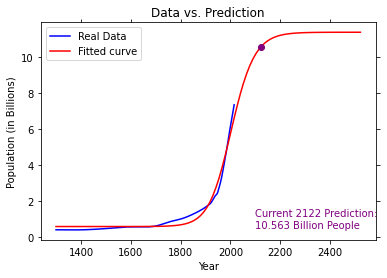

Iteration #21000, Loss: 0.05294498998083404


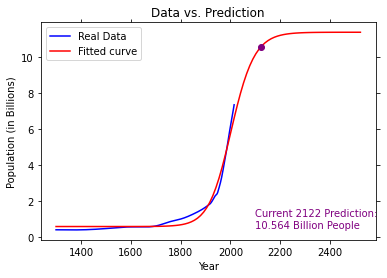

Iteration #21050, Loss: 0.05293627237075057


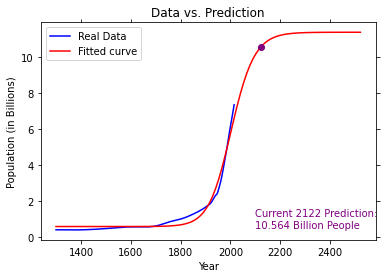

Iteration #21100, Loss: 0.0529275709718611


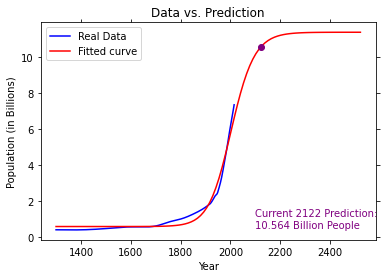

Iteration #21150, Loss: 0.05291888573819818


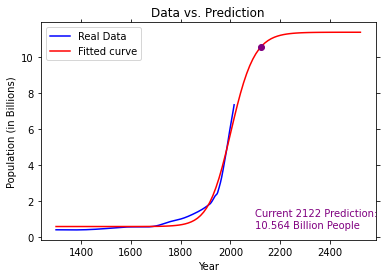

Iteration #21200, Loss: 0.05291021662475874


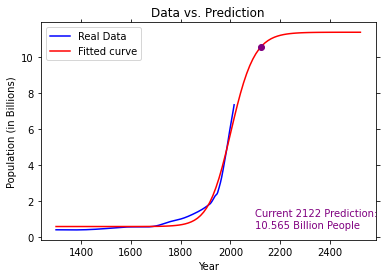

Iteration #21250, Loss: 0.0529015635874869


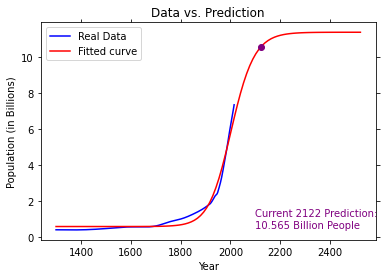

Iteration #21300, Loss: 0.052892926583256776


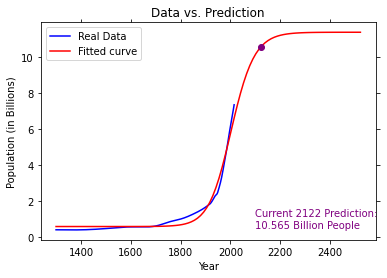

Iteration #21350, Loss: 0.05288430556985625


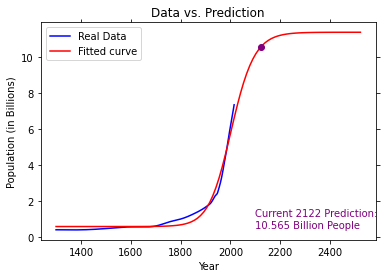

Iteration #21400, Loss: 0.052875700505970104


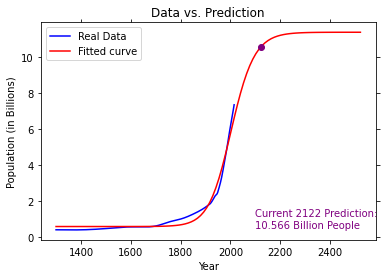

Iteration #21450, Loss: 0.05286711135116444


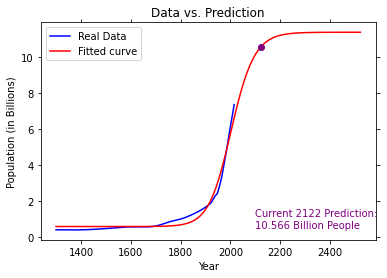

Iteration #21500, Loss: 0.052858538065870535


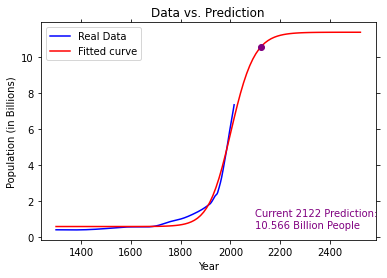

Iteration #21550, Loss: 0.05284998061136952


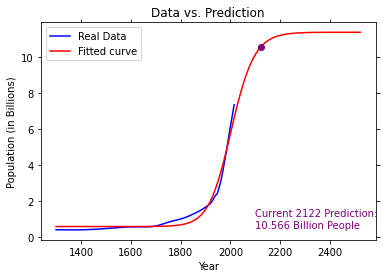

Iteration #21600, Loss: 0.05284143894977726


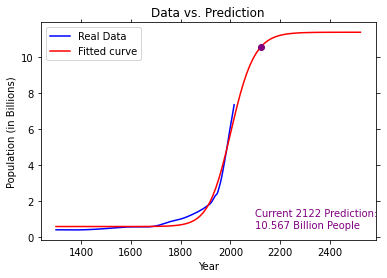

Iteration #21650, Loss: 0.052832913044029164


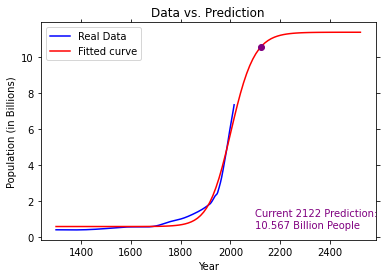

Iteration #21700, Loss: 0.05282440285786534


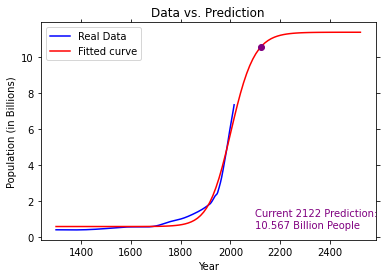

Iteration #21750, Loss: 0.05281590835581679


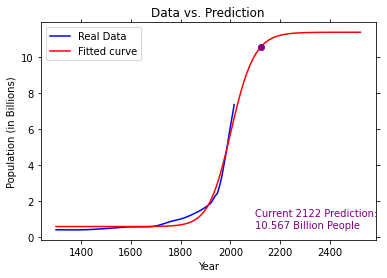

Iteration #21800, Loss: 0.05280742950319075


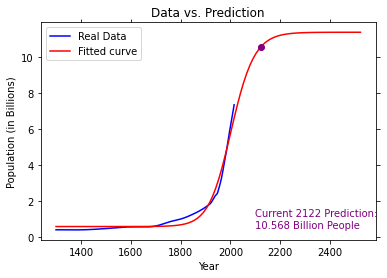

Iteration #21850, Loss: 0.052798966266056784


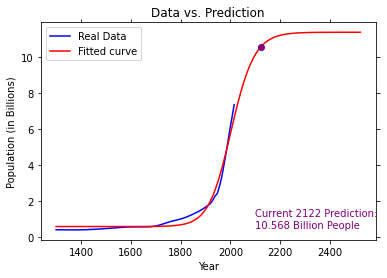

Iteration #21900, Loss: 0.05279051861123328


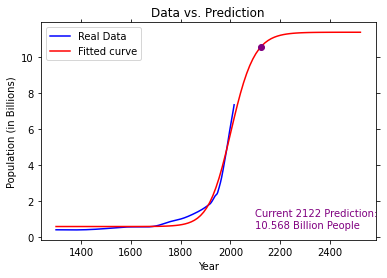

Iteration #21950, Loss: 0.05278208650627393


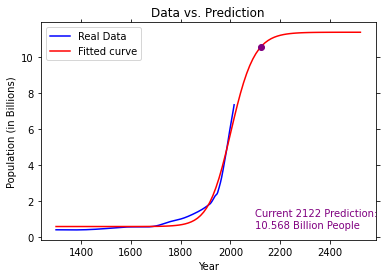

Iteration #22000, Loss: 0.05277366991945442


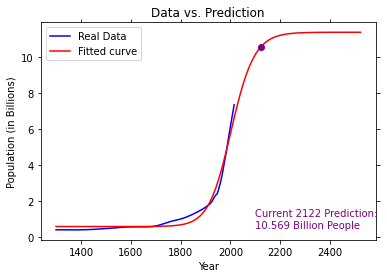

Iteration #22050, Loss: 0.05276526881975972


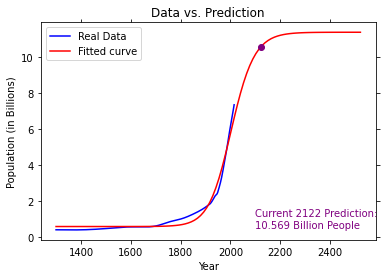

Iteration #22100, Loss: 0.052756883176871175


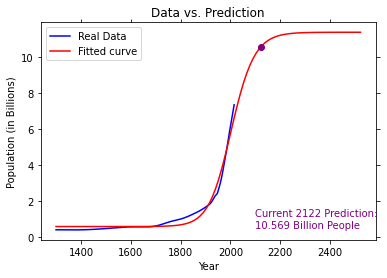

Iteration #22150, Loss: 0.052748512961154126


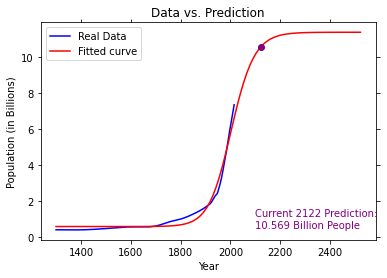

Iteration #22200, Loss: 0.05274015814364489


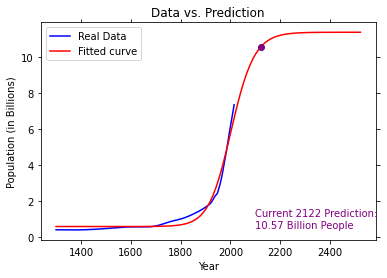

Iteration #22250, Loss: 0.052731818696040135


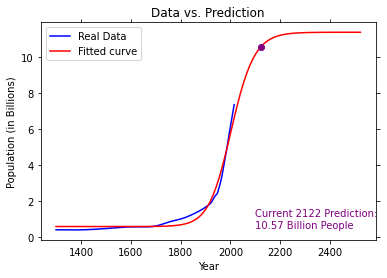

Iteration #22300, Loss: 0.05272349459068377


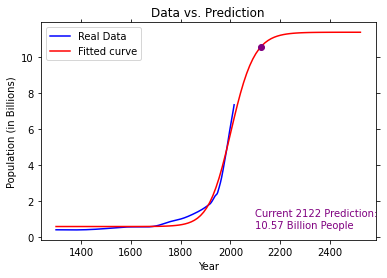

Iteration #22350, Loss: 0.05271518580055563


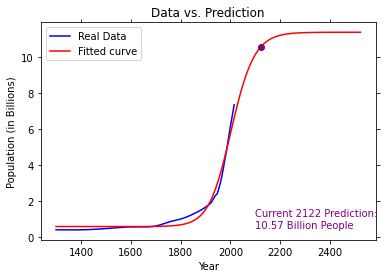

Iteration #22400, Loss: 0.05270689229926001


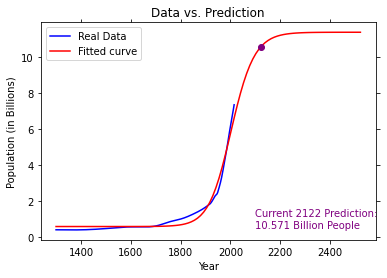

Iteration #22450, Loss: 0.05269861406101489


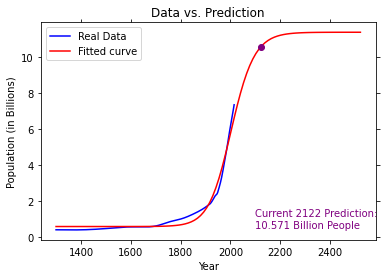

Iteration #22500, Loss: 0.05269035106063958


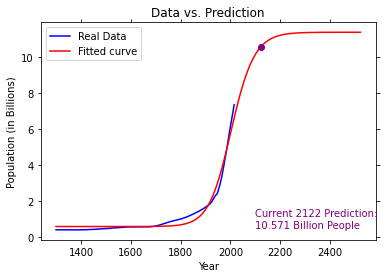

Iteration #22550, Loss: 0.05268210327354579


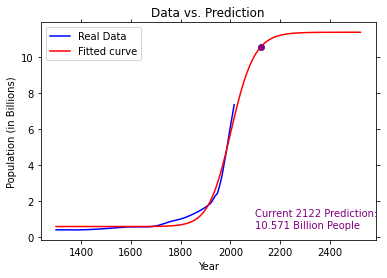

Iteration #22600, Loss: 0.05267387067572509


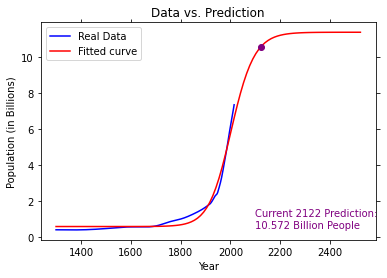

Iteration #22650, Loss: 0.05266565324373979


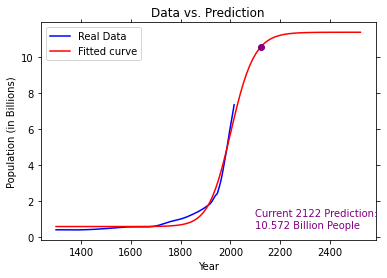

Iteration #22700, Loss: 0.0526574509547115


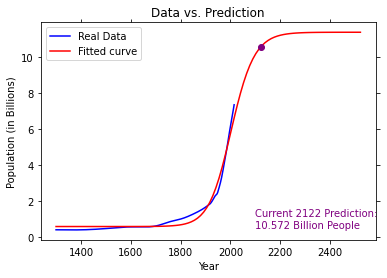

Iteration #22750, Loss: 0.052649263786311774


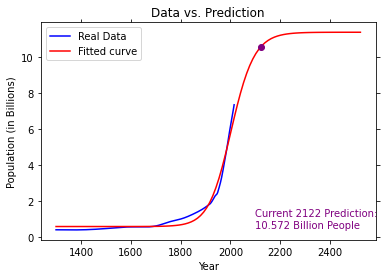

Iteration #22800, Loss: 0.05264109171675219


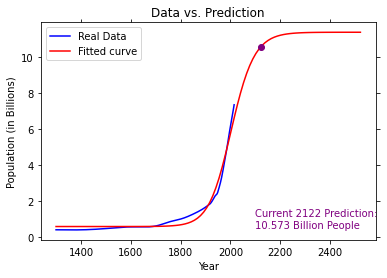

Iteration #22850, Loss: 0.052632934724773935


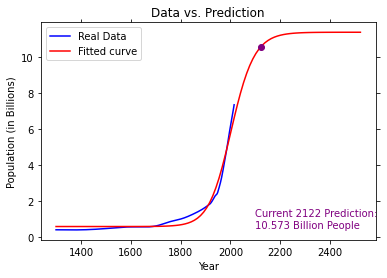

Iteration #22900, Loss: 0.052624792789638726


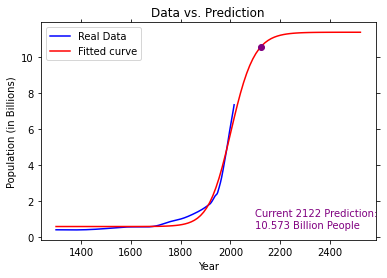

Iteration #22950, Loss: 0.052616665891119366


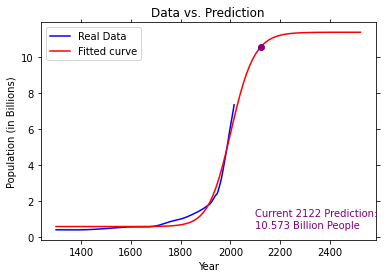

Iteration #23000, Loss: 0.05260855400948991


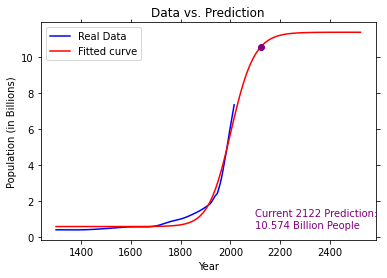

Iteration #23050, Loss: 0.05260045712551745


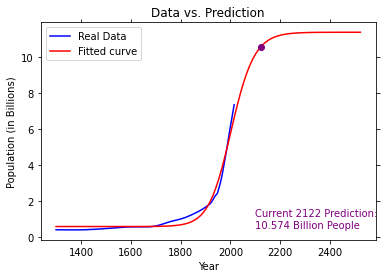

Iteration #23100, Loss: 0.05259237522045229


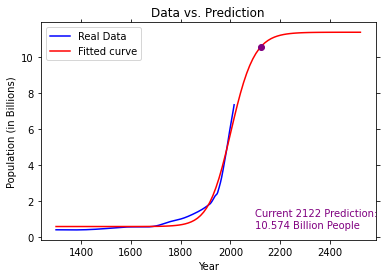

Iteration #23150, Loss: 0.052584308276019606


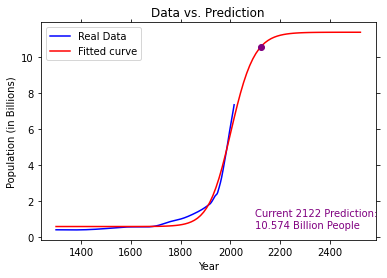

Iteration #23200, Loss: 0.05257625627441068


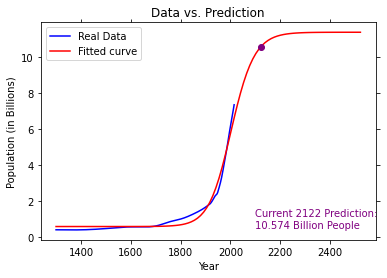

Iteration #23250, Loss: 0.05256821919827454


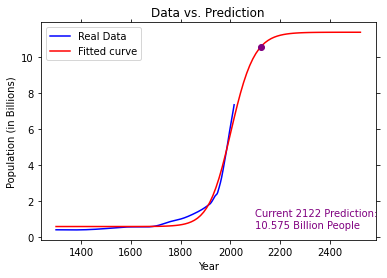

Iteration #23300, Loss: 0.052560197030709056


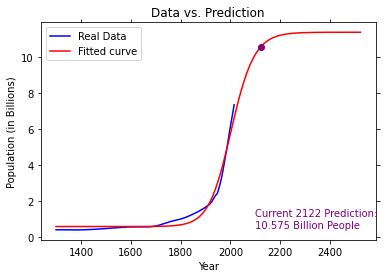

Iteration #23350, Loss: 0.05255218975525359


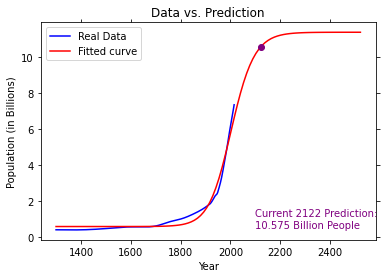

Iteration #23400, Loss: 0.05254419735588025


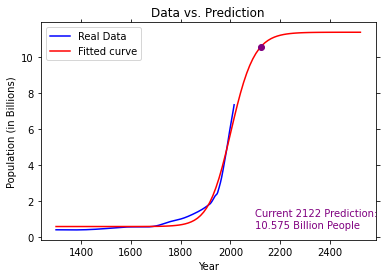

Iteration #23450, Loss: 0.052536219816986314


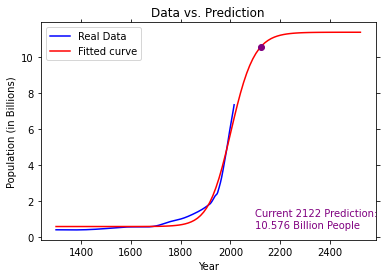

Iteration #23500, Loss: 0.05252825712338599


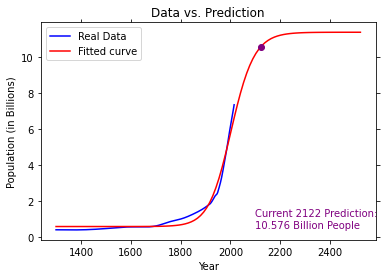

Iteration #23550, Loss: 0.05252030926030325


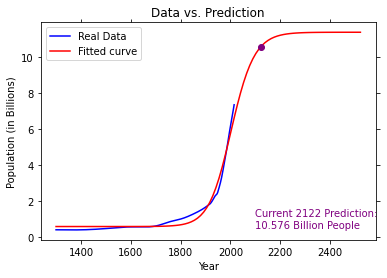

Iteration #23600, Loss: 0.052512376213364194


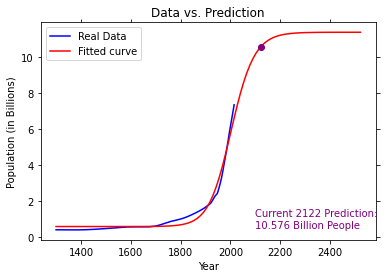

Iteration #23650, Loss: 0.05250445796858928


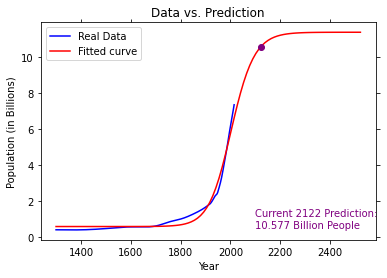

Iteration #23700, Loss: 0.05249655451238681


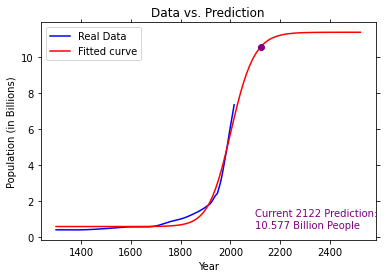

Iteration #23750, Loss: 0.05248866583154479


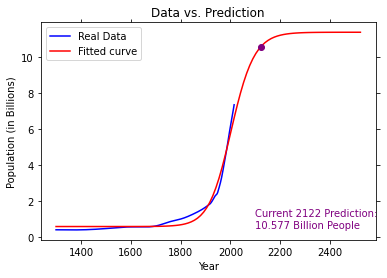

Iteration #23800, Loss: 0.052480791913224516


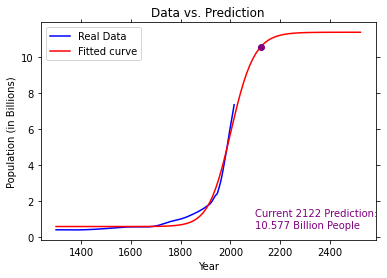

Iteration #23850, Loss: 0.05247293274495386


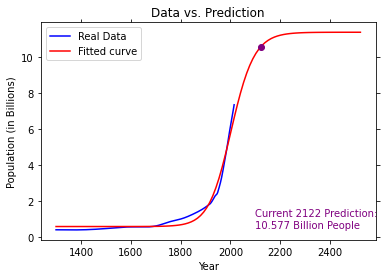

Iteration #23900, Loss: 0.05246508831461989


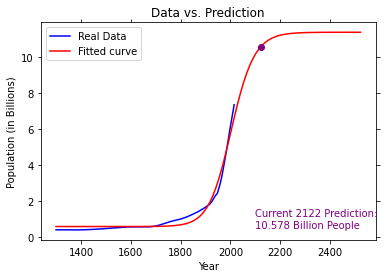

Iteration #23950, Loss: 0.05245725861046267


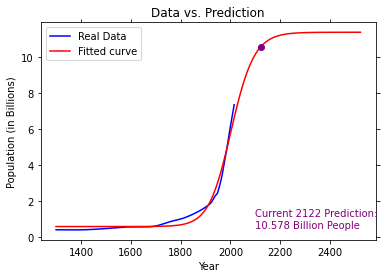

Iteration #24000, Loss: 0.05244944362106834


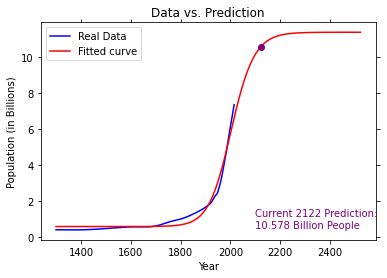

Iteration #24050, Loss: 0.052441643335363074


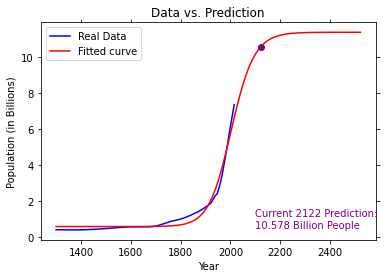

Iteration #24100, Loss: 0.0524338577426064


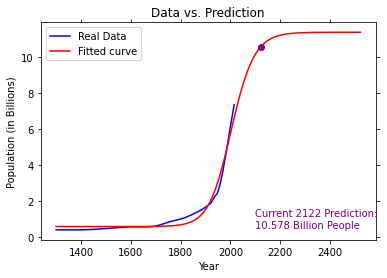

Iteration #24150, Loss: 0.05242608683238508


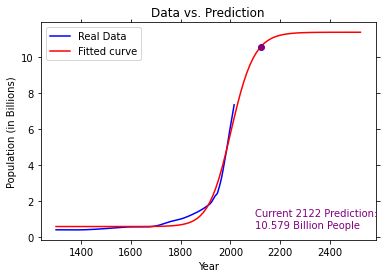

Iteration #24200, Loss: 0.05241833059460721


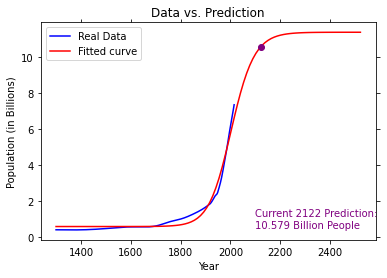

Iteration #24250, Loss: 0.052410589019495676


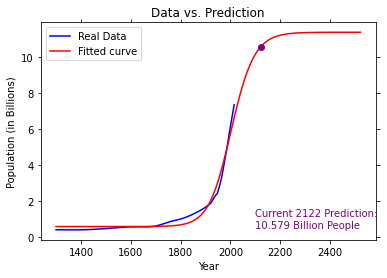

Iteration #24300, Loss: 0.05240286209758294


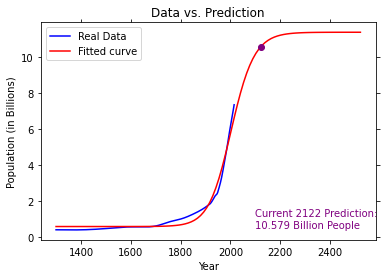

Iteration #24350, Loss: 0.0523951498197046


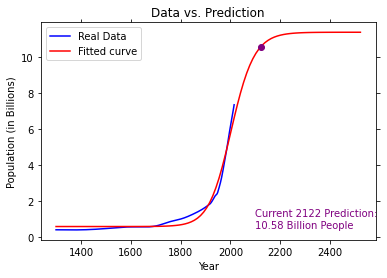

Iteration #24400, Loss: 0.052387452176994045


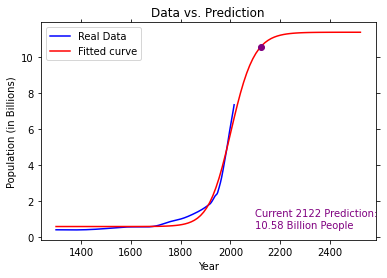

Iteration #24450, Loss: 0.052379769160876784


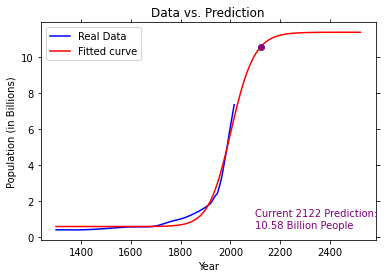

Iteration #24500, Loss: 0.05237210076306479


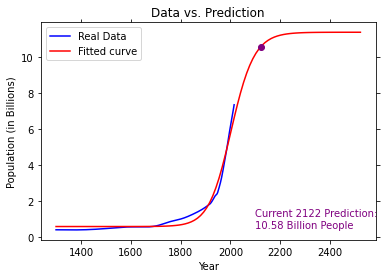

Iteration #24550, Loss: 0.05236444697555117


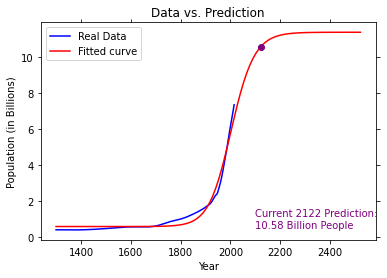

Iteration #24600, Loss: 0.05235680779060493


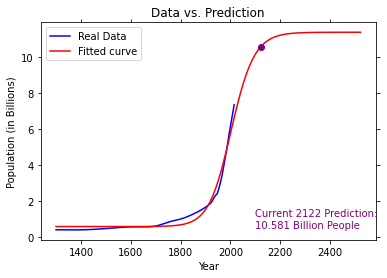

Iteration #24650, Loss: 0.05234918320076552


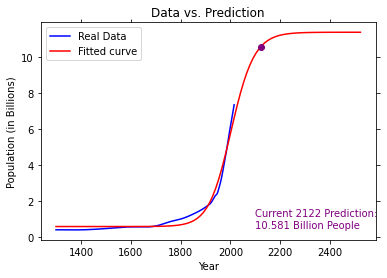

Iteration #24700, Loss: 0.05234157319883776


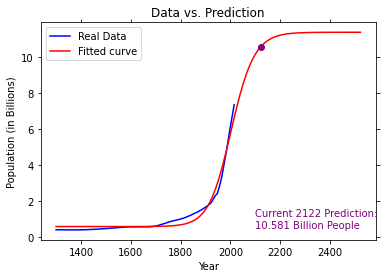

Iteration #24750, Loss: 0.05233397777788699


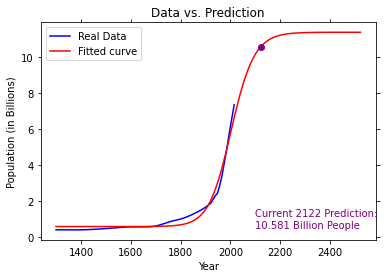

Iteration #24800, Loss: 0.052326396931233705


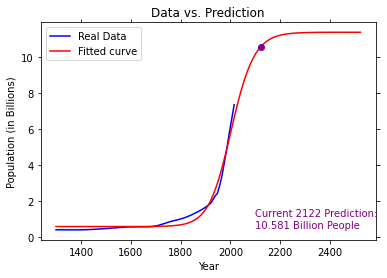

Iteration #24850, Loss: 0.05231883065244902


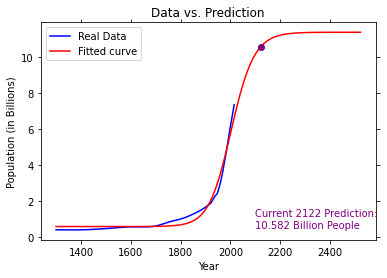

Iteration #24900, Loss: 0.05231127893534953


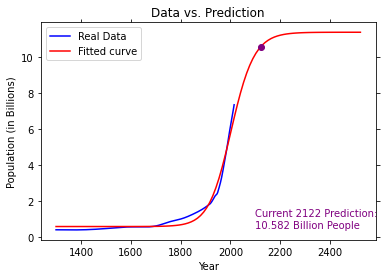

Iteration #24950, Loss: 0.05230374177399292


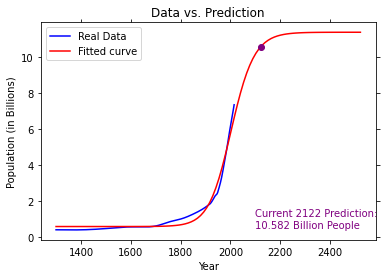

Iteration #25000, Loss: 0.0522962191626731


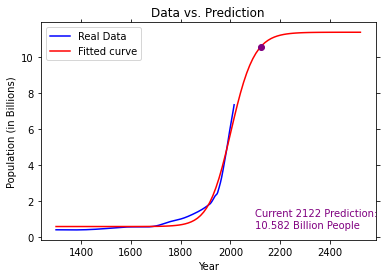

Iteration #25050, Loss: 0.052288711095915784


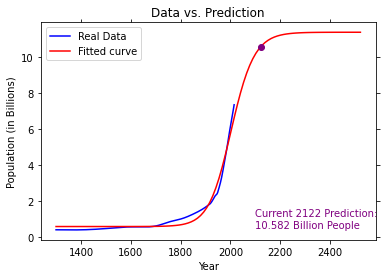

Iteration #25100, Loss: 0.05228121756847357


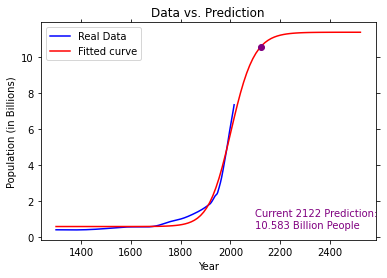

Iteration #25150, Loss: 0.05227373857532222


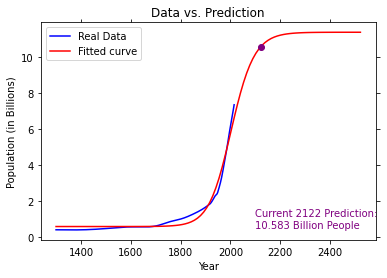

Iteration #25200, Loss: 0.052266274111655825


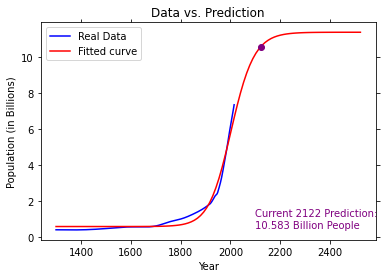

Iteration #25250, Loss: 0.05225882417288265


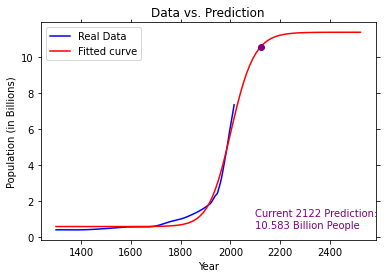

Iteration #25300, Loss: 0.05225138875462082


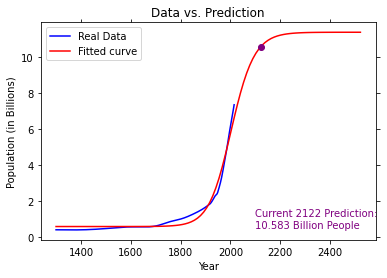

Iteration #25350, Loss: 0.05224396785269462


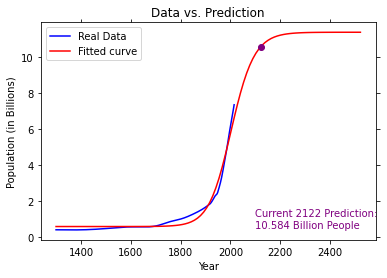

Iteration #25400, Loss: 0.052236561463129966


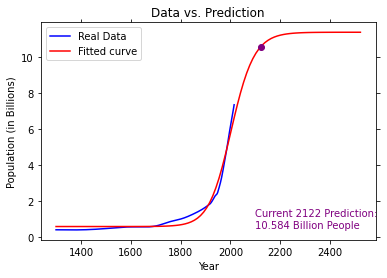

Iteration #25450, Loss: 0.0522291695821507


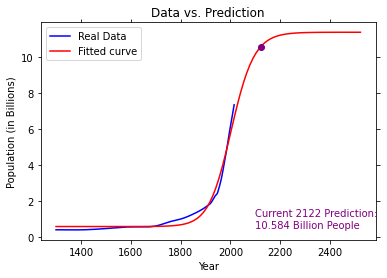

Iteration #25500, Loss: 0.052221792206174594


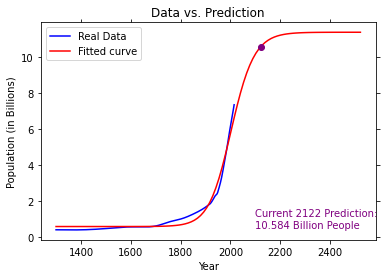

Iteration #25550, Loss: 0.052214429331809205


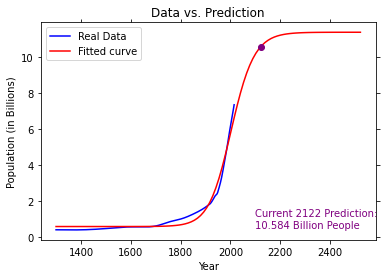

Iteration #25600, Loss: 0.05220708095584883


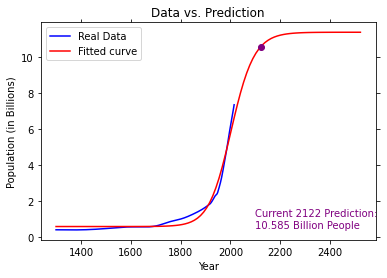

Iteration #25650, Loss: 0.05219974707526997


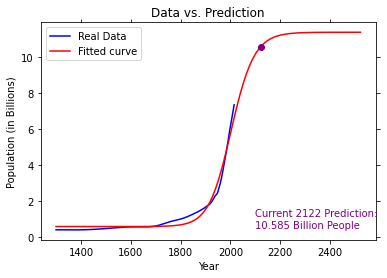

Iteration #25700, Loss: 0.052192427687228225


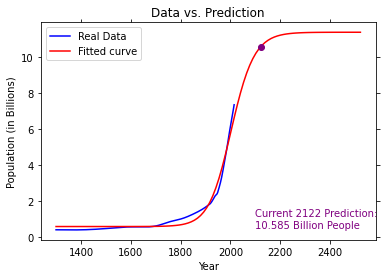

Iteration #25750, Loss: 0.05218512278905447


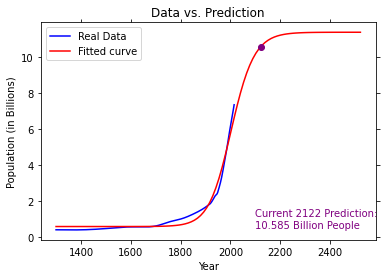

Iteration #25800, Loss: 0.052177832378251215


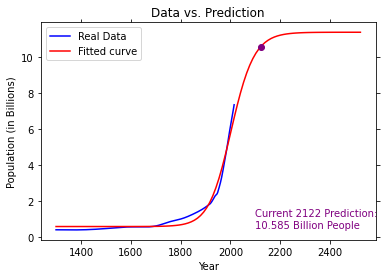

Iteration #25850, Loss: 0.0521705564524896


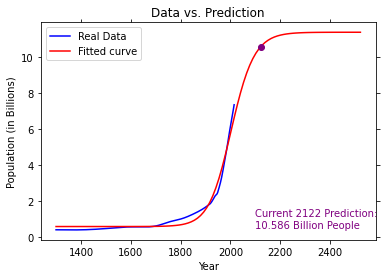

Iteration #25900, Loss: 0.05216329500960523


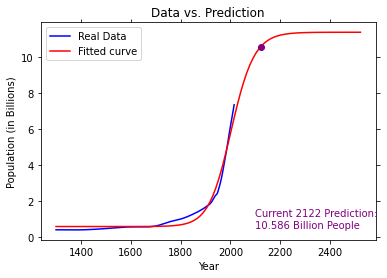

Iteration #25950, Loss: 0.05215604804759559


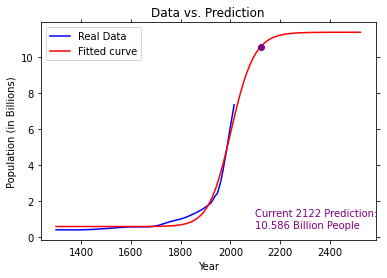

Iteration #26000, Loss: 0.05214881556461611


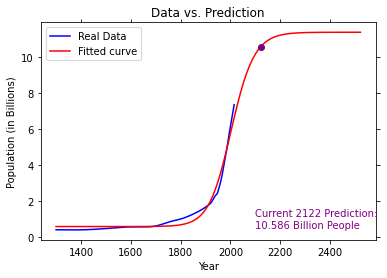

Iteration #26050, Loss: 0.05214159755897745


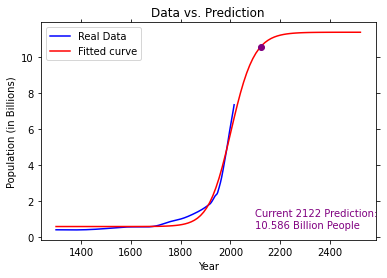

Iteration #26100, Loss: 0.052134394029141926


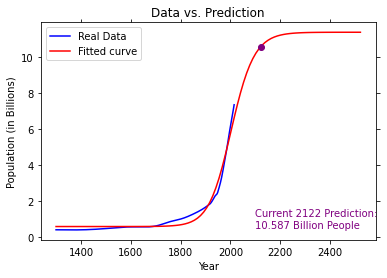

Iteration #26150, Loss: 0.052127204973720545


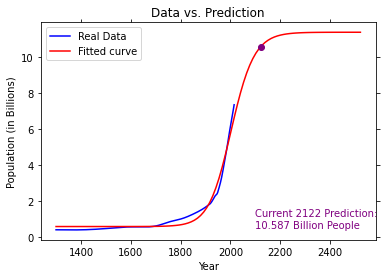

Iteration #26200, Loss: 0.05212003039146984


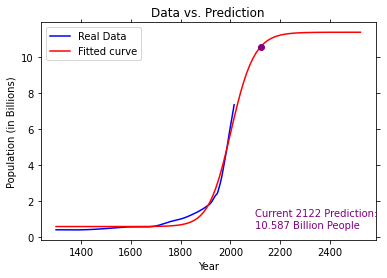

Iteration #26250, Loss: 0.052112870281289


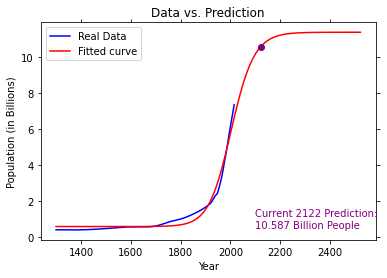

Iteration #26300, Loss: 0.05210572464221665


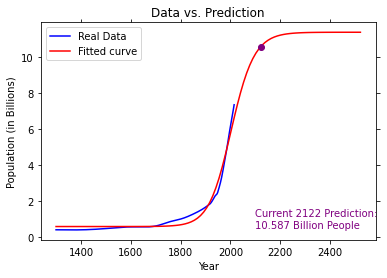

Iteration #26350, Loss: 0.05209859347342813


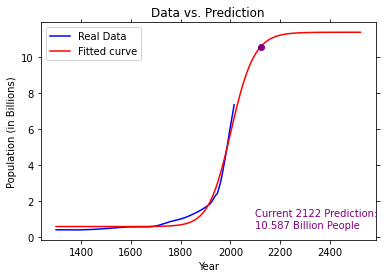

Iteration #26400, Loss: 0.05209147677423264


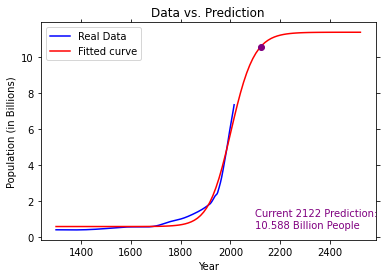

Iteration #26450, Loss: 0.05208437454407006


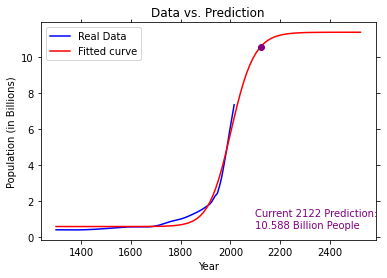

Iteration #26500, Loss: 0.05207728678250863


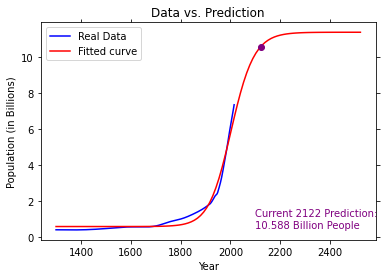

Iteration #26550, Loss: 0.05207021348924197


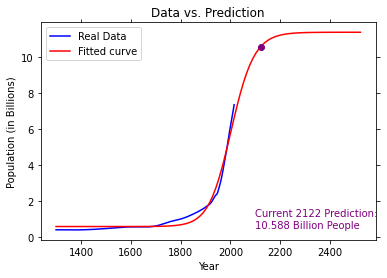

Iteration #26600, Loss: 0.052063154664086356


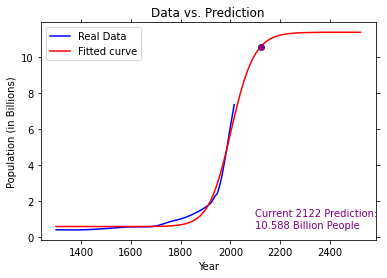

Iteration #26650, Loss: 0.05205611030697819


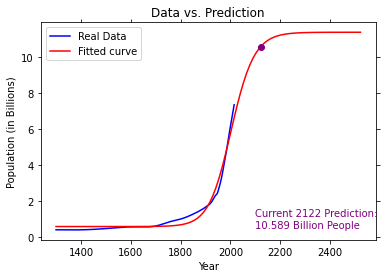

Iteration #26700, Loss: 0.0520490804179714


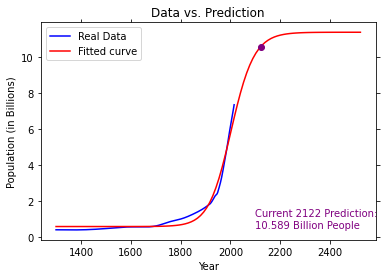

Iteration #26750, Loss: 0.0520420649972348


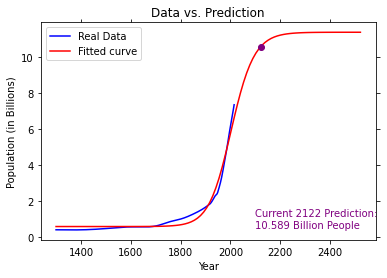

Iteration #26800, Loss: 0.05203506404504974


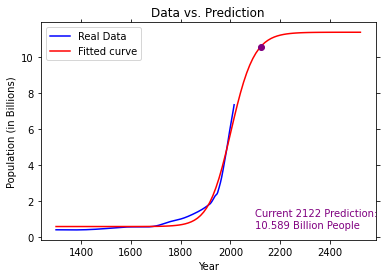

Iteration #26850, Loss: 0.052028077561807426


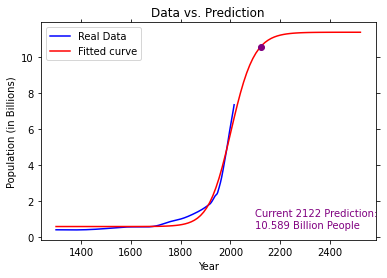

Iteration #26900, Loss: 0.052021105548006624


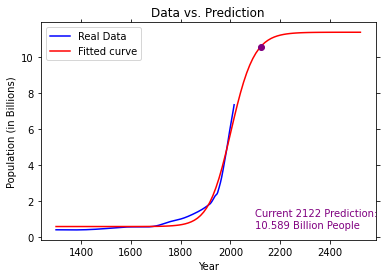

Iteration #26950, Loss: 0.052014148004251255


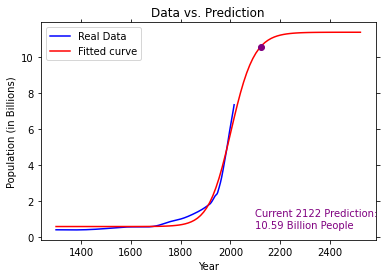

Iteration #27000, Loss: 0.052007204931248094


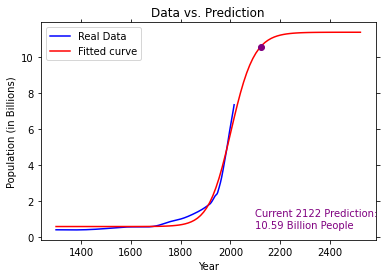

Iteration #27050, Loss: 0.05200027632980444


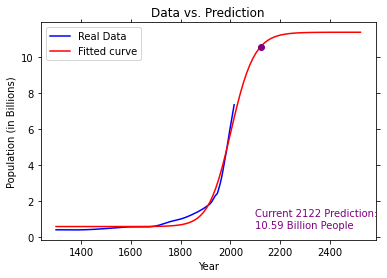

Iteration #27100, Loss: 0.05199336220082579


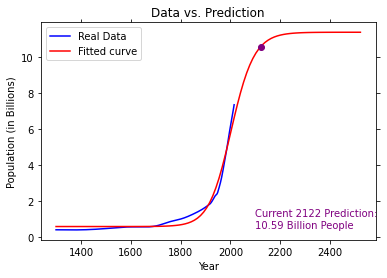

Iteration #27150, Loss: 0.05198646254531361


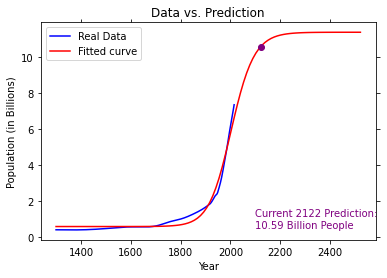

Iteration #27200, Loss: 0.05197957736436346


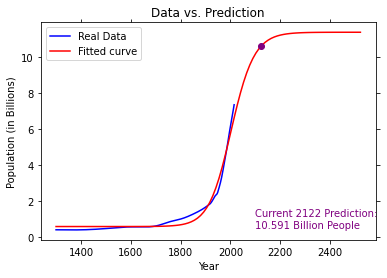

Iteration #27250, Loss: 0.05197270665916232


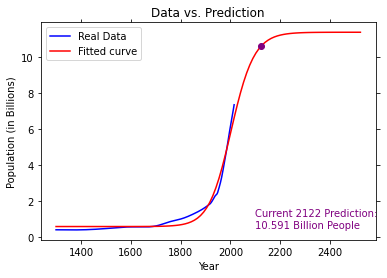

Iteration #27300, Loss: 0.05196585043098682


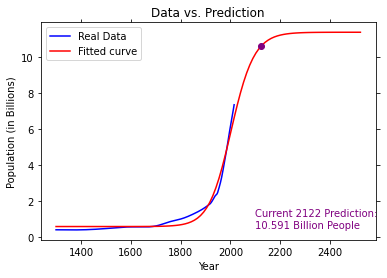

Iteration #27350, Loss: 0.0519590086812012


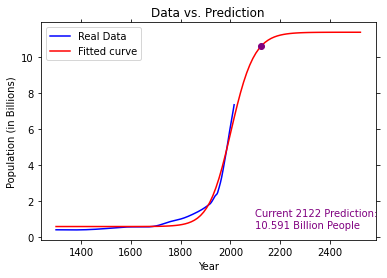

Iteration #27400, Loss: 0.05195218141125506


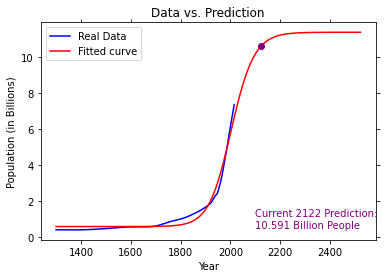

Iteration #27450, Loss: 0.051945368622681495


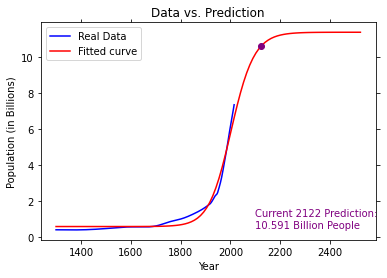

Iteration #27500, Loss: 0.051938570317095076


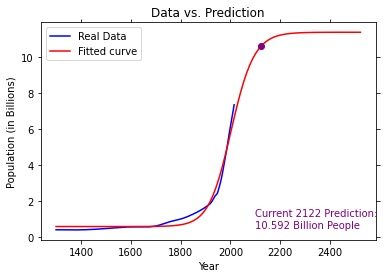

Iteration #27550, Loss: 0.051931786496189965


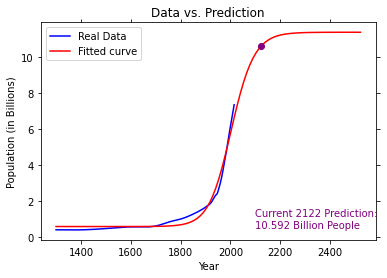

Iteration #27600, Loss: 0.05192501716173793


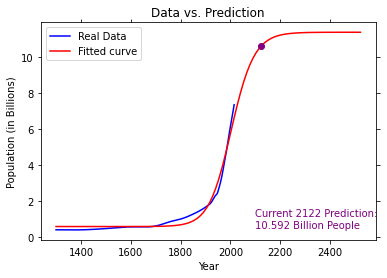

Iteration #27650, Loss: 0.051918262315586494


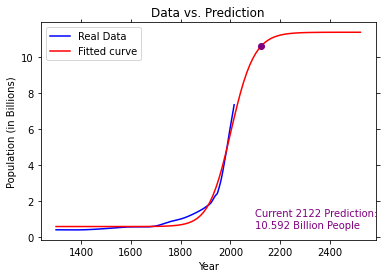

Iteration #27700, Loss: 0.0519115219596573


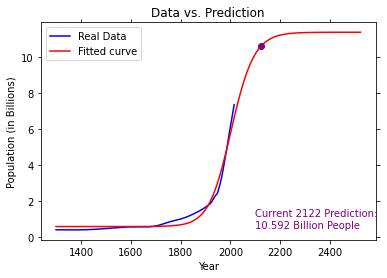

Iteration #27750, Loss: 0.0519047960959438


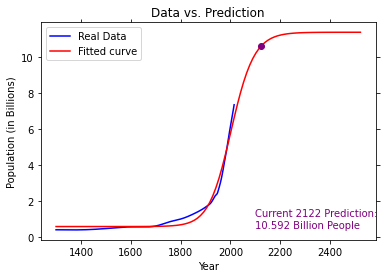

Iteration #27800, Loss: 0.05189808472651004


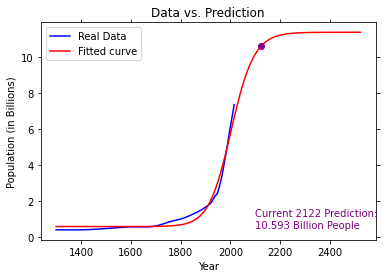

Iteration #27850, Loss: 0.05189138785348875


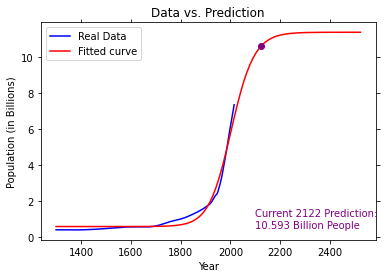

Iteration #27900, Loss: 0.051884705479079314


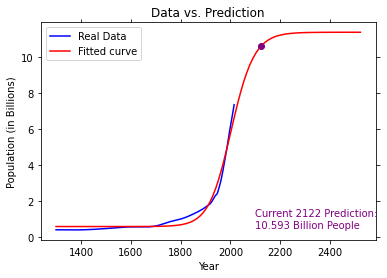

Iteration #27950, Loss: 0.051878037605546434


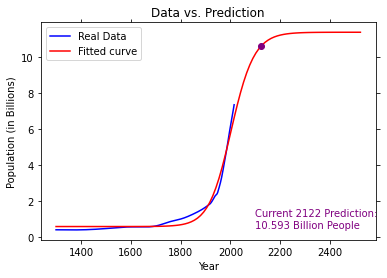

Iteration #28000, Loss: 0.05187138423521848


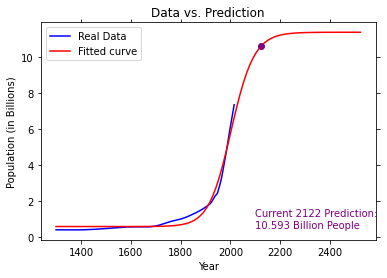

Iteration #28050, Loss: 0.05186474537048553


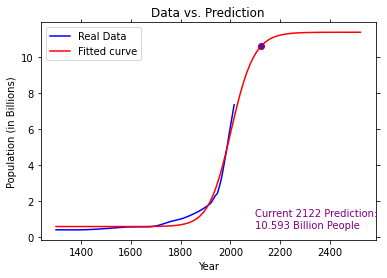

Iteration #28100, Loss: 0.05185812101379812


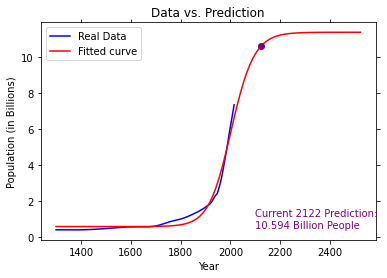

Iteration #28150, Loss: 0.051851511167665676


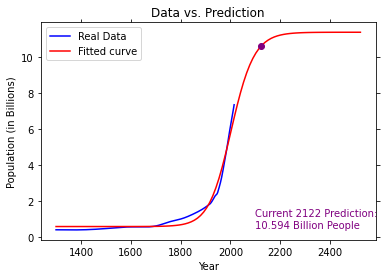

Iteration #28200, Loss: 0.051844915834654524


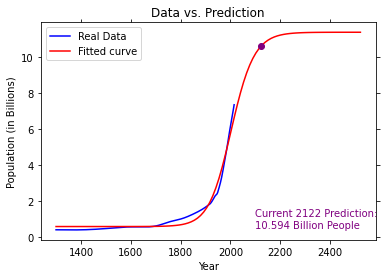

Iteration #28250, Loss: 0.05183833501738693


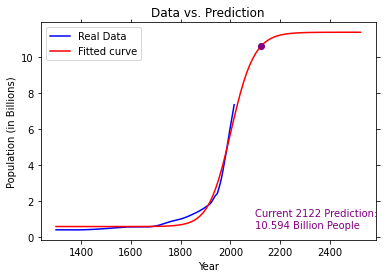

Iteration #28300, Loss: 0.0518317687185393


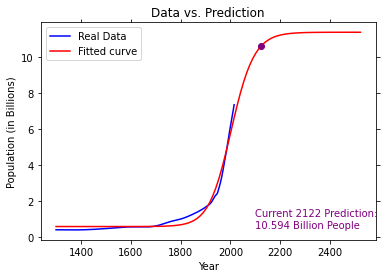

Iteration #28350, Loss: 0.05182521694084083


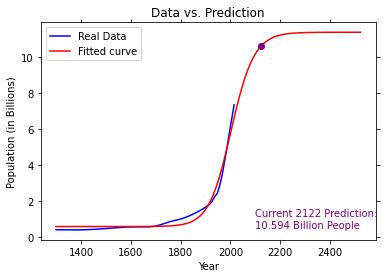

Iteration #28400, Loss: 0.05181867968707198


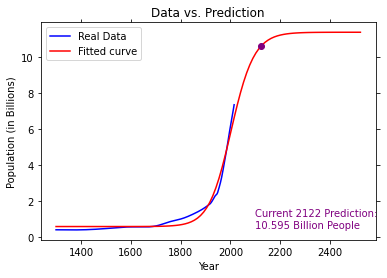

Iteration #28450, Loss: 0.05181215696006285


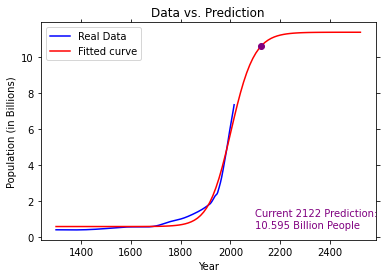

Iteration #28500, Loss: 0.05180564876269263


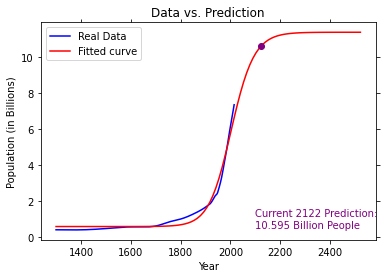

Iteration #28550, Loss: 0.05179915509788695


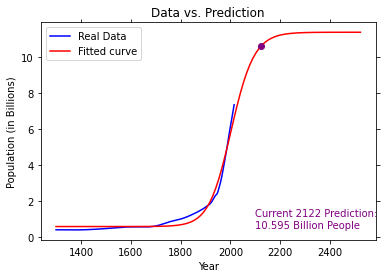

Iteration #28600, Loss: 0.05179267596861786


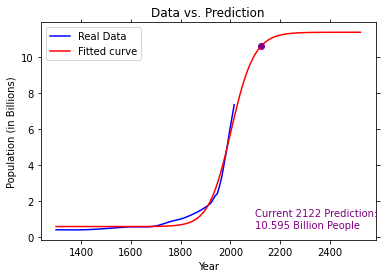

Iteration #28650, Loss: 0.051786211377901355


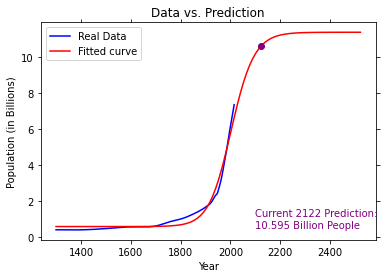

Iteration #28700, Loss: 0.051779761328796976


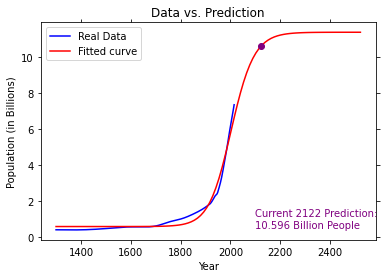

Iteration #28750, Loss: 0.05177332582440602


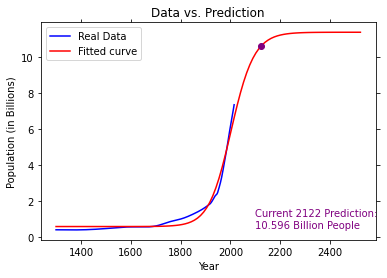

Iteration #28800, Loss: 0.051766904867870514


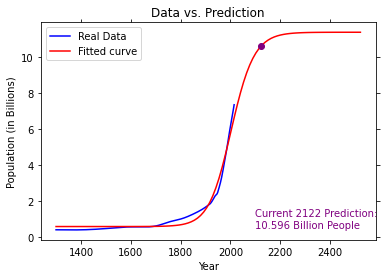

Iteration #28850, Loss: 0.05176049846237194


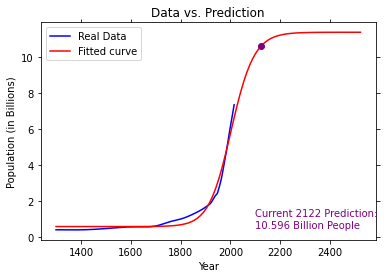

Iteration #28900, Loss: 0.05175410661112976


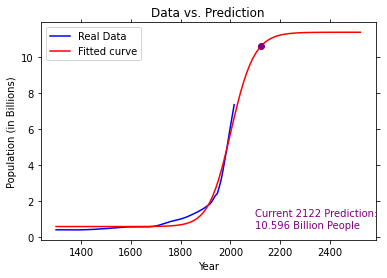

Iteration #28950, Loss: 0.05174772931740081


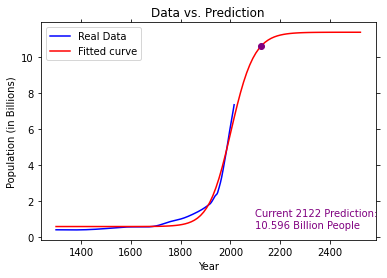

Iteration #29000, Loss: 0.05174136658447769


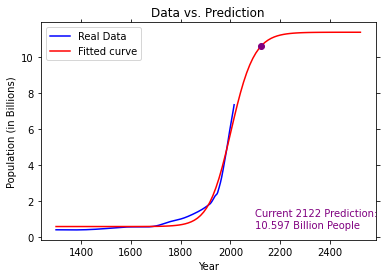

Iteration #29050, Loss: 0.05173501841568761


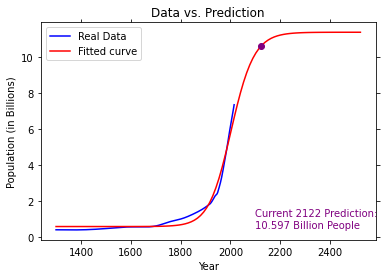

Iteration #29100, Loss: 0.05172868481439174


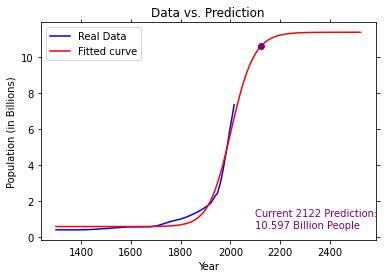

Iteration #29150, Loss: 0.051722365783983405


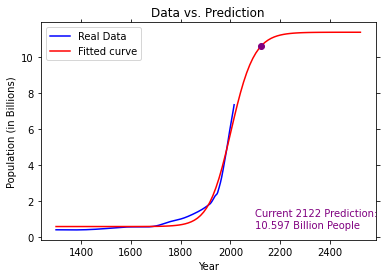

Iteration #29200, Loss: 0.05171606132788742


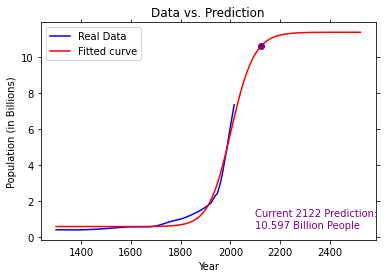

Iteration #29250, Loss: 0.05170977144955919


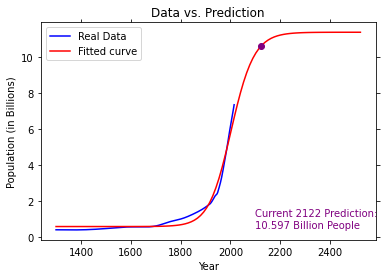

Iteration #29300, Loss: 0.051703496152483326


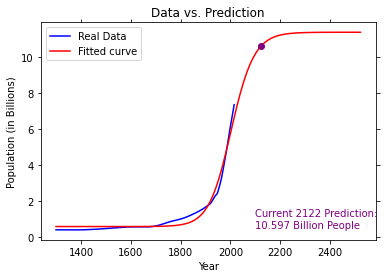

Iteration #29350, Loss: 0.05169723544017279


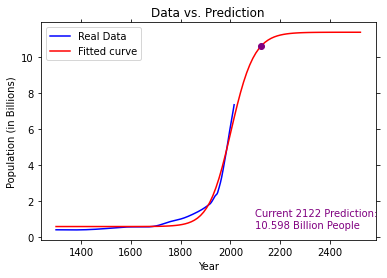

Iteration #29400, Loss: 0.05169098931616773


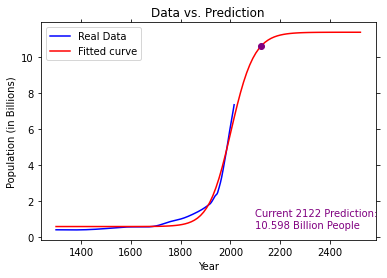

Iteration #29450, Loss: 0.05168475778403458


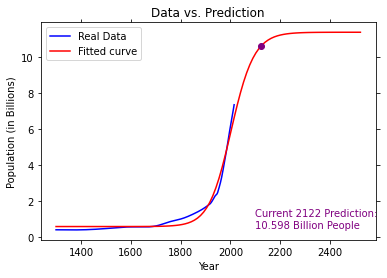

Iteration #29500, Loss: 0.0516785408473654


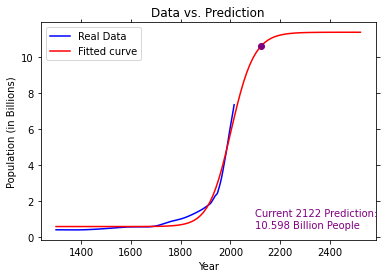

Iteration #29550, Loss: 0.05167233850977633


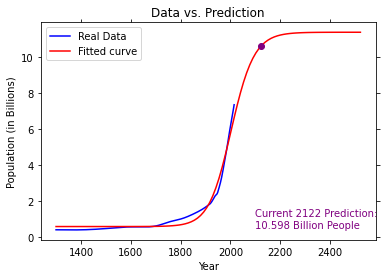

Iteration #29600, Loss: 0.05166615077490715


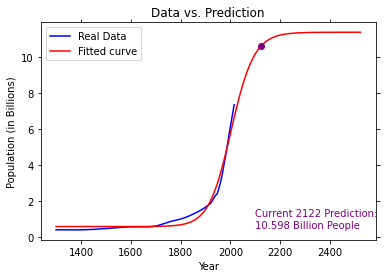

Iteration #29650, Loss: 0.051659977646420115


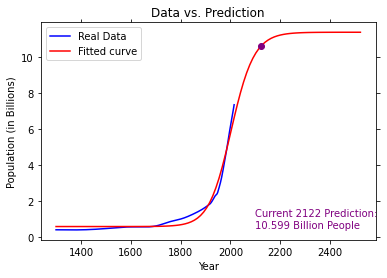

Iteration #29700, Loss: 0.05165381912799916


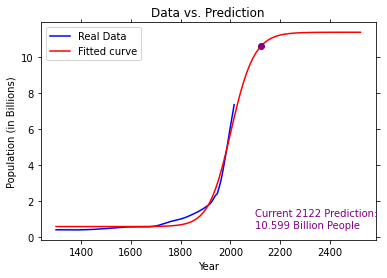

Iteration #29750, Loss: 0.05164767522334884


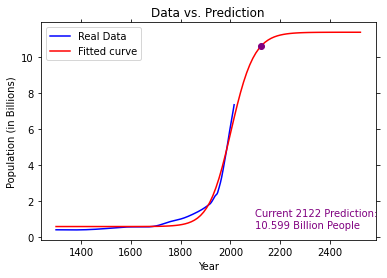

Iteration #29800, Loss: 0.05164154593619368


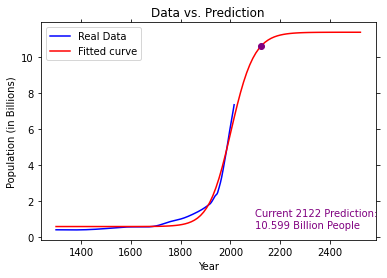

Iteration #29850, Loss: 0.051635431270277254


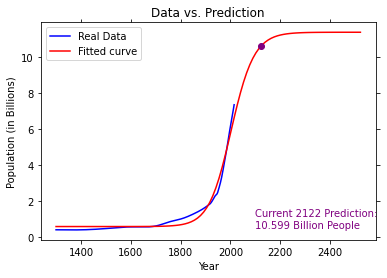

Iteration #29900, Loss: 0.051629331229361454


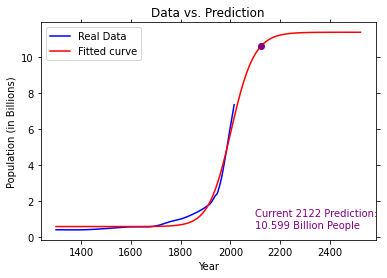

Iteration #29950, Loss: 0.05162324581722523


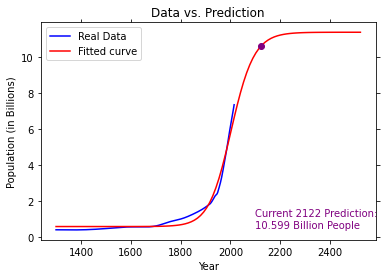

Iteration #30000, Loss: 0.05161717503766428


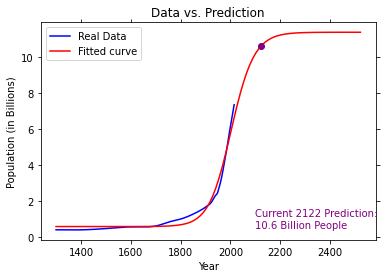

Iteration #30050, Loss: 0.051611118894490125


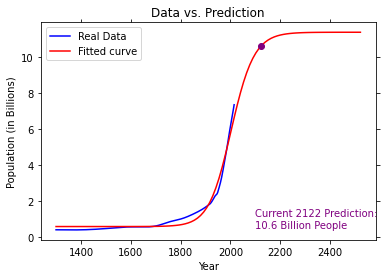

Iteration #30100, Loss: 0.05160507739152926


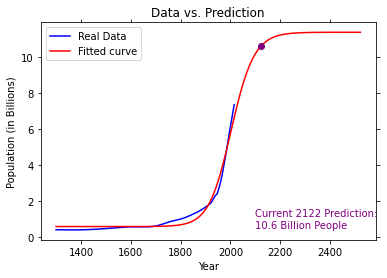

Iteration #30150, Loss: 0.051599050532622266


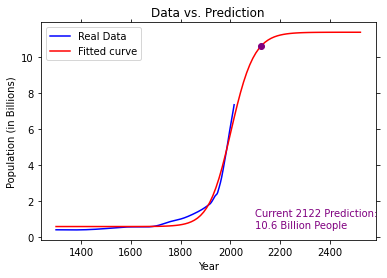

Iteration #30200, Loss: 0.05159303832162342


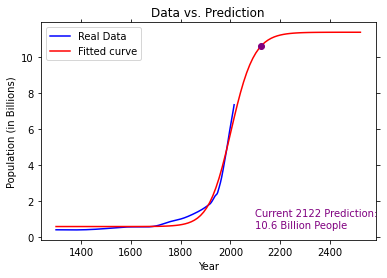

Iteration #30250, Loss: 0.05158704076239966


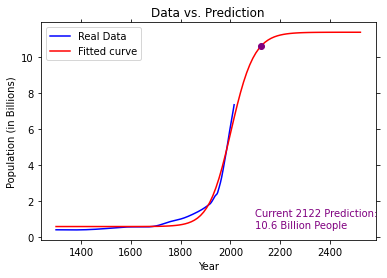

Iteration #30300, Loss: 0.051581057858829965


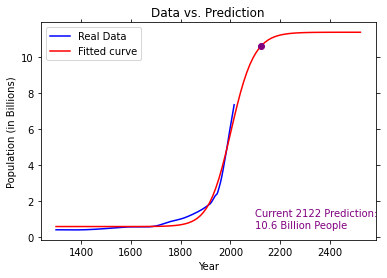

Iteration #30350, Loss: 0.051575089614804566


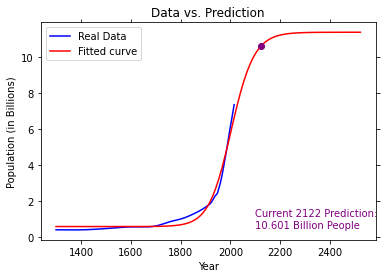

Iteration #30400, Loss: 0.05156913603422451


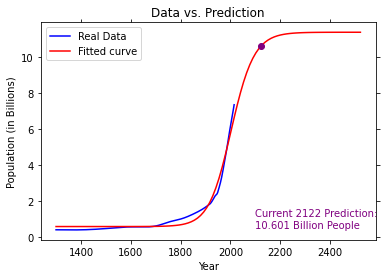

Iteration #30450, Loss: 0.05156319712100056


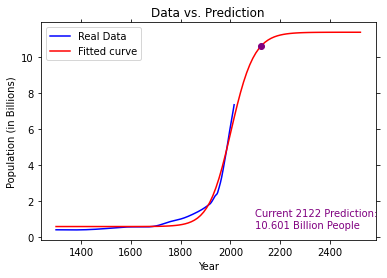

Iteration #30500, Loss: 0.051557272879053054


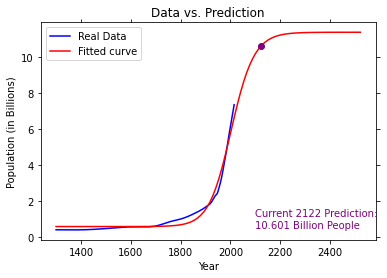

Iteration #30550, Loss: 0.05155136331231075


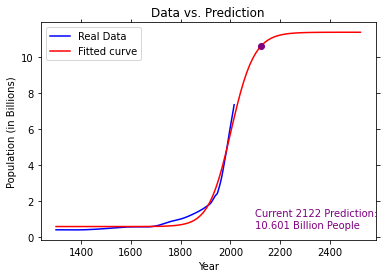

Iteration #30600, Loss: 0.051545468424710465


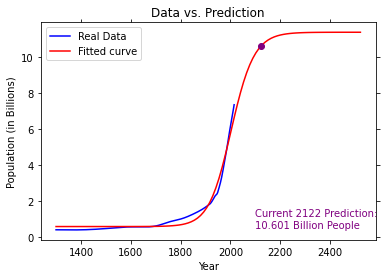

Iteration #30650, Loss: 0.05153958822019618


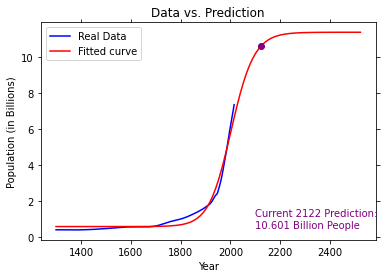

Iteration #30700, Loss: 0.051533722702719165


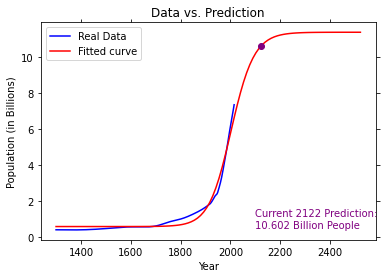

Iteration #30750, Loss: 0.05152787187623618


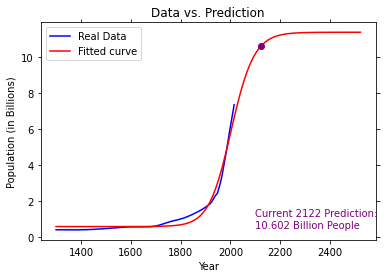

Iteration #30800, Loss: 0.05152203574471007


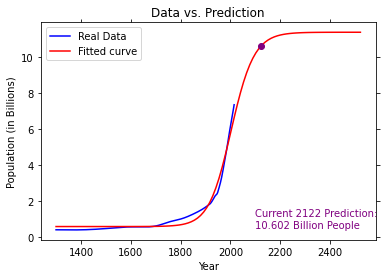

Iteration #30850, Loss: 0.05151621431210824


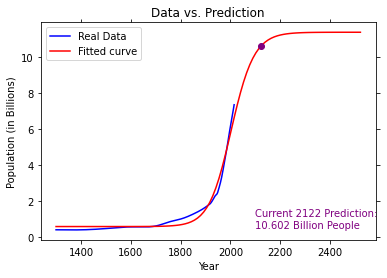

Iteration #30900, Loss: 0.051510407582402794


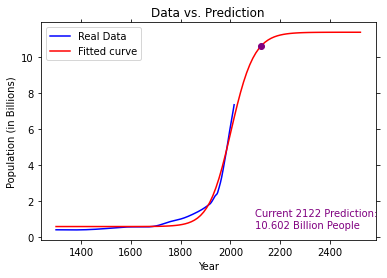

Iteration #30950, Loss: 0.051504615559569575


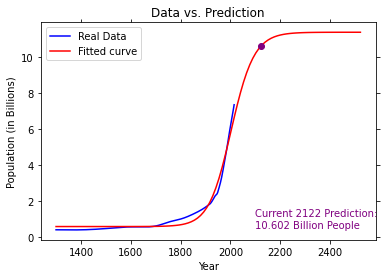

Iteration #31000, Loss: 0.05149883824758759


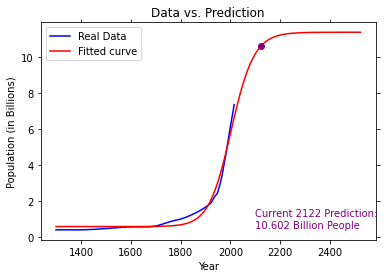

Iteration #31050, Loss: 0.05149307565043874


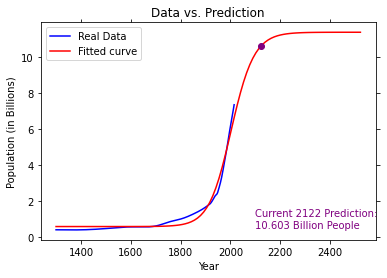

Iteration #31100, Loss: 0.051487327772107135


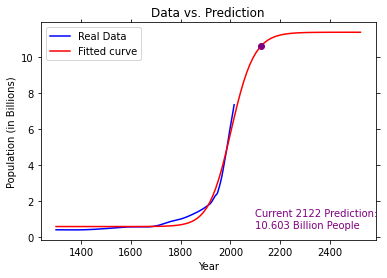

Iteration #31150, Loss: 0.05148159461657855


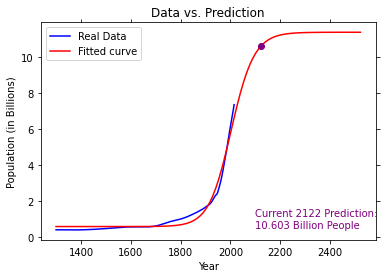

Iteration #31200, Loss: 0.05147587618784009


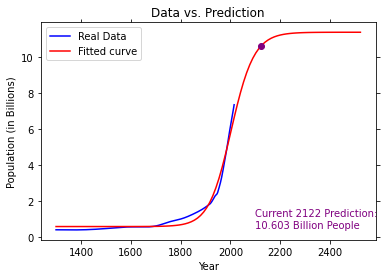

Iteration #31250, Loss: 0.05147017248987929


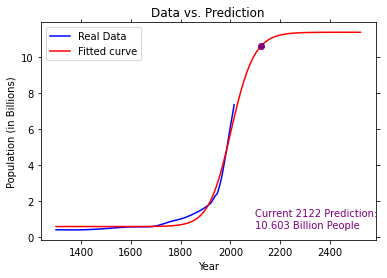

Iteration #31300, Loss: 0.05146448352668423


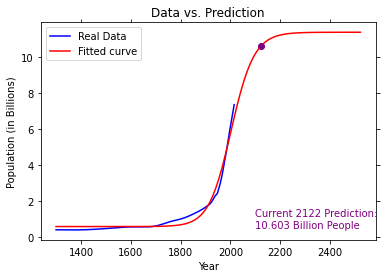

Iteration #31350, Loss: 0.05145880930224245


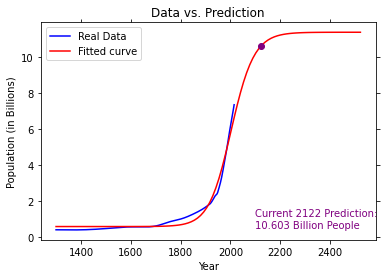

Iteration #31400, Loss: 0.05145314982054113


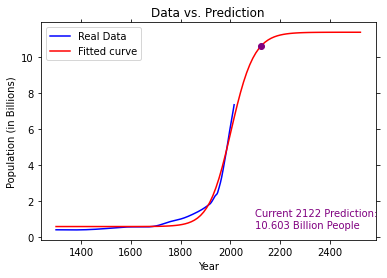

Iteration #31450, Loss: 0.05144750508556586


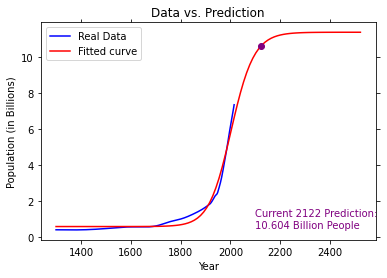

Iteration #31500, Loss: 0.051441875101300966


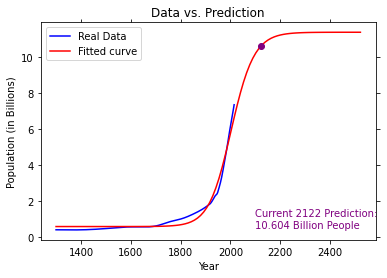

Iteration #31550, Loss: 0.05143625987172849


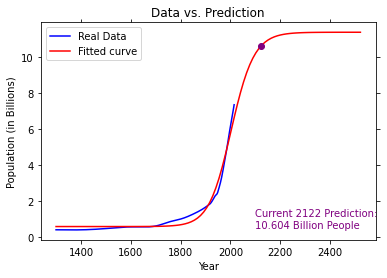

Iteration #31600, Loss: 0.051430659400828166


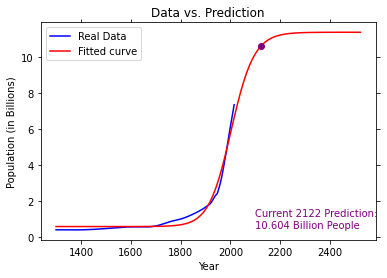

Iteration #31650, Loss: 0.051425073692576505


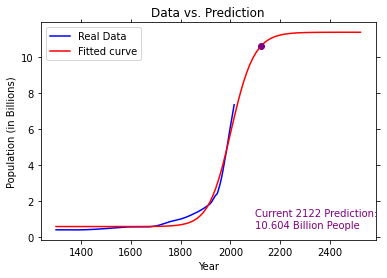

Iteration #31700, Loss: 0.051419502750947


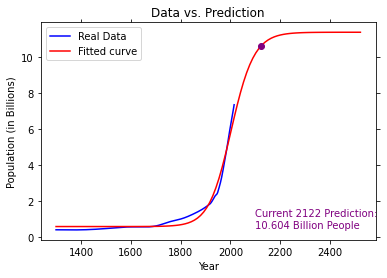

Iteration #31750, Loss: 0.051413946579909504


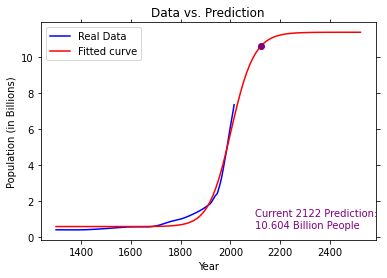

Iteration #31800, Loss: 0.051408405183429366


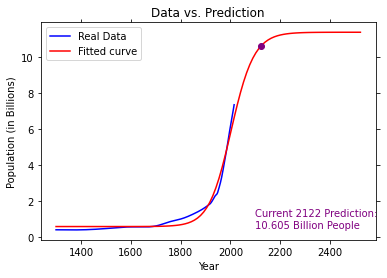

Iteration #31850, Loss: 0.051402878565467665


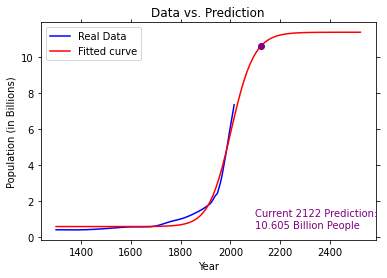

Iteration #31900, Loss: 0.05139736672998062


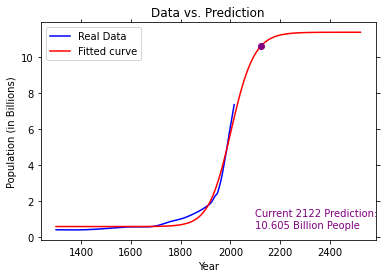

Iteration #31950, Loss: 0.05139186968091954


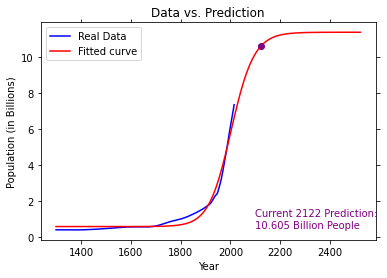

Iteration #32000, Loss: 0.051386387422229236


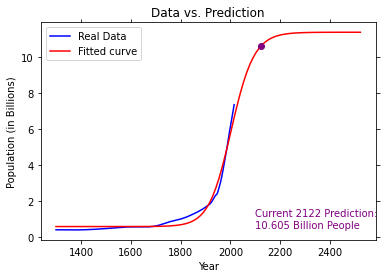

Iteration #32050, Loss: 0.05138091995784943


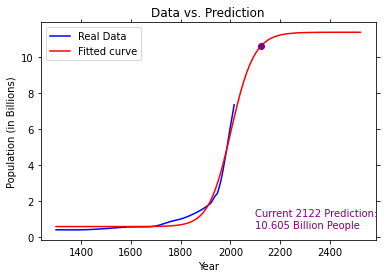

Iteration #32100, Loss: 0.05137546729171301


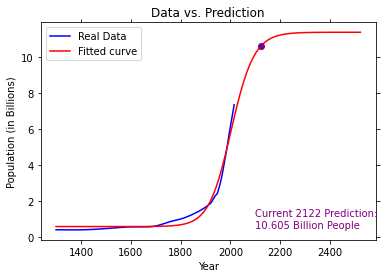

Iteration #32150, Loss: 0.0513700294277465


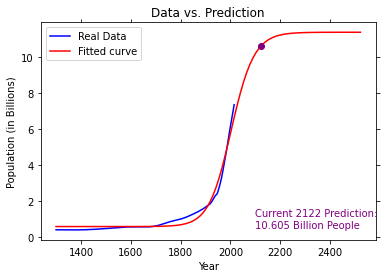

Iteration #32200, Loss: 0.05136460636986935


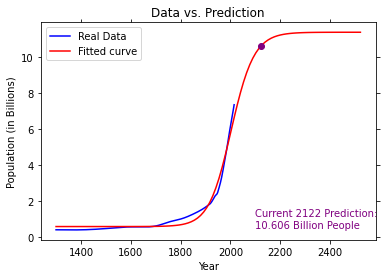

Iteration #32250, Loss: 0.05135919812199379


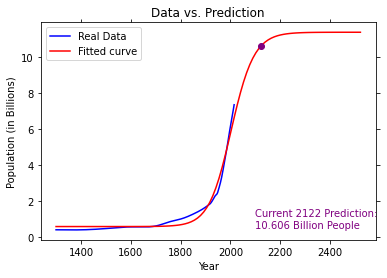

Iteration #32300, Loss: 0.05135380468802433


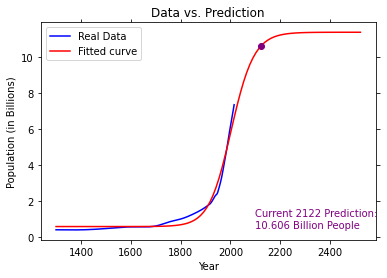

Iteration #32350, Loss: 0.05134842607185762


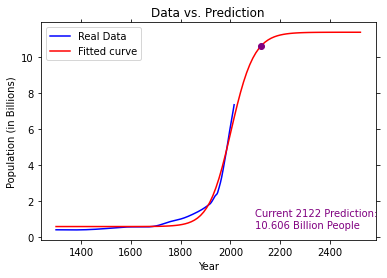

Iteration #32400, Loss: 0.05134306227738205


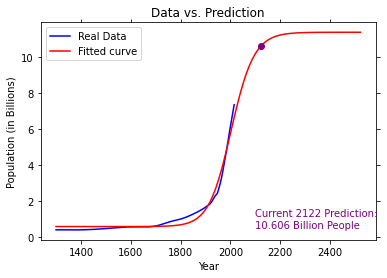

Iteration #32450, Loss: 0.051337713308477674


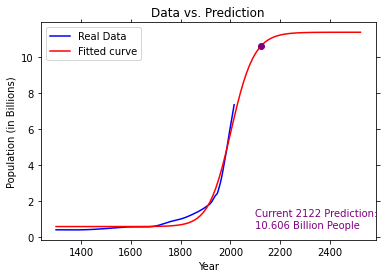

Iteration #32500, Loss: 0.05133237916901534


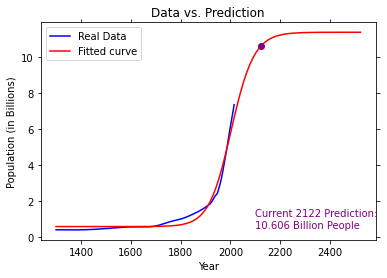

Iteration #32550, Loss: 0.0513270598628574


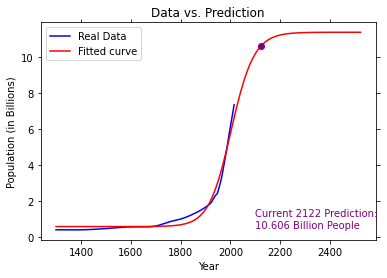

Iteration #32600, Loss: 0.05132175539385628


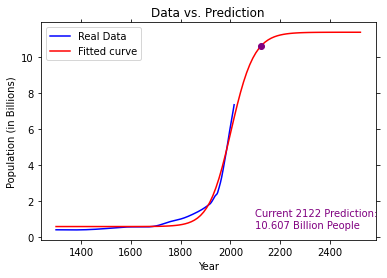

Iteration #32650, Loss: 0.0513164657658551


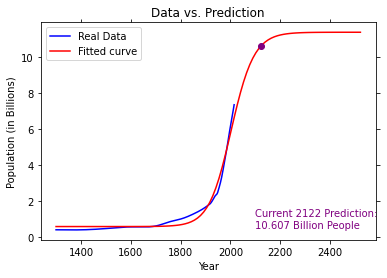

Iteration #32700, Loss: 0.051311190982687056


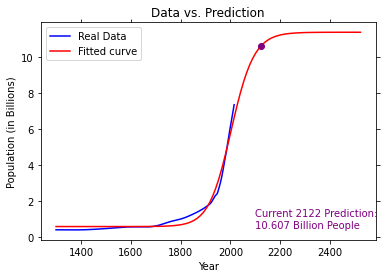

Iteration #32750, Loss: 0.05130593104817503


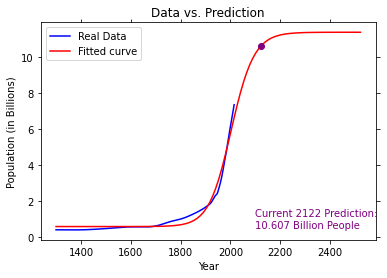

Iteration #32800, Loss: 0.0513006859661318


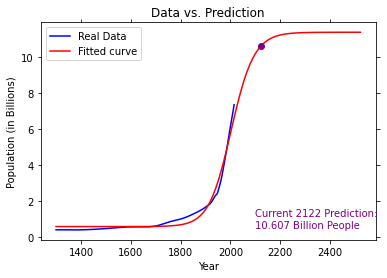

Iteration #32850, Loss: 0.05129545574035958


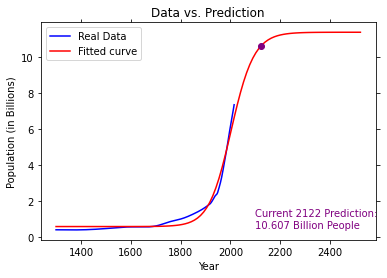

Iteration #32900, Loss: 0.0512902403746485


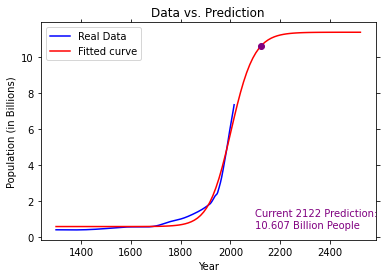

Iteration #32950, Loss: 0.051285039872779666


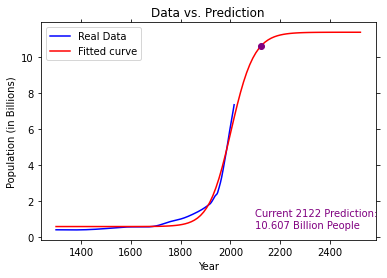

Iteration #33000, Loss: 0.05127985423852133


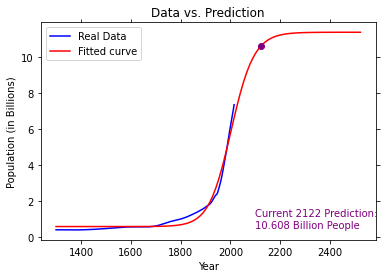

Iteration #33050, Loss: 0.05127468347563069


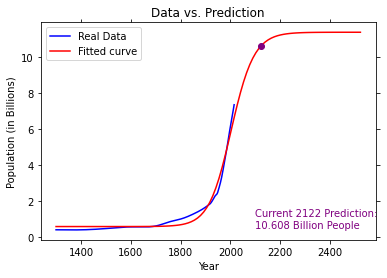

Iteration #33100, Loss: 0.0512695275878529


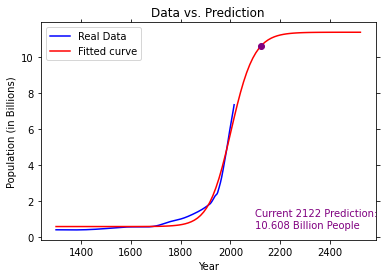

Iteration #33150, Loss: 0.051264386578921683


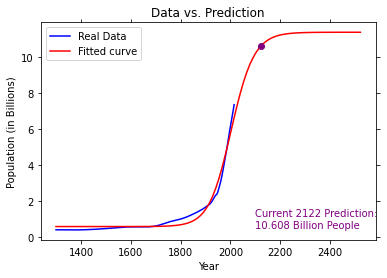

Iteration #33200, Loss: 0.0512592604525581


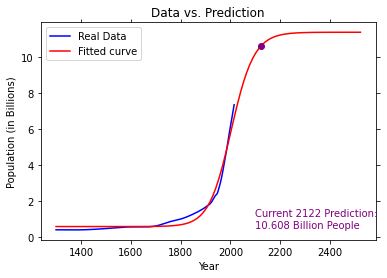

Iteration #33250, Loss: 0.05125414921247115


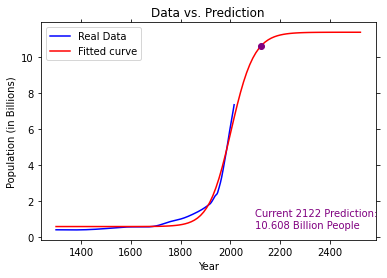

Iteration #33300, Loss: 0.051249052862356974


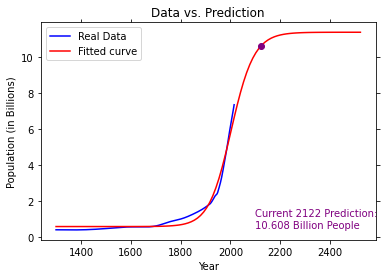

Iteration #33350, Loss: 0.05124397140589925


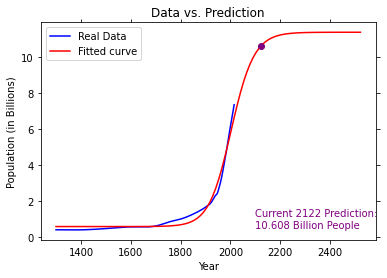

Iteration #33400, Loss: 0.05123890484676837


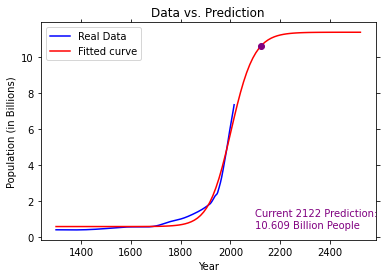

Iteration #33450, Loss: 0.05123385318862212


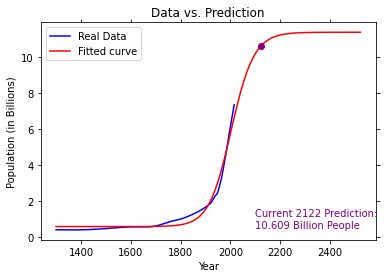

Iteration #33500, Loss: 0.051228816435104484


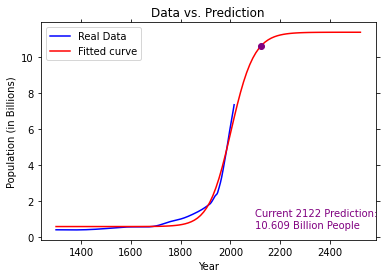

Iteration #33550, Loss: 0.05122379458984644


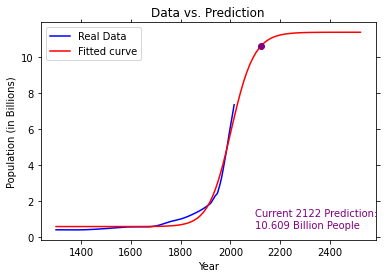

Iteration #33600, Loss: 0.0512187876564649


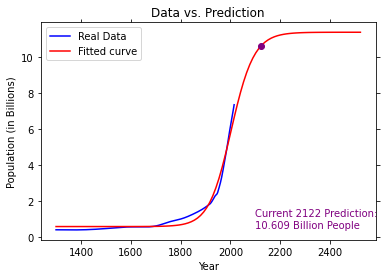

Iteration #33650, Loss: 0.05121379563856343


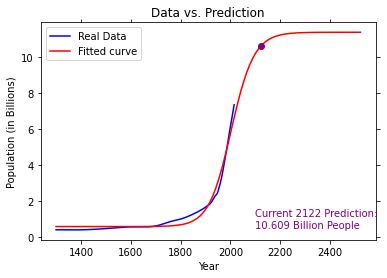

Iteration #33700, Loss: 0.051208818539731416


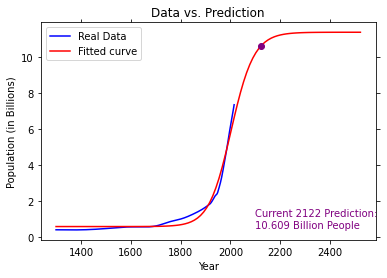

Iteration #33750, Loss: 0.05120385636354423


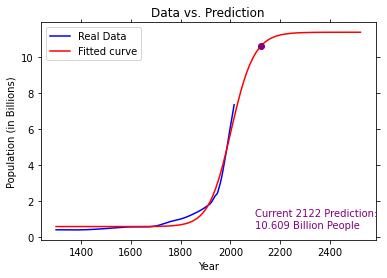

Iteration #33800, Loss: 0.05119890911356304


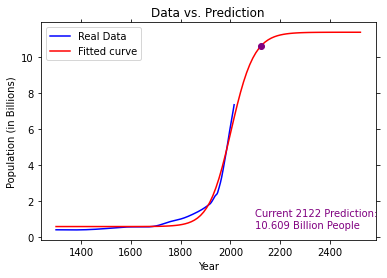

Iteration #33850, Loss: 0.05119397679333468


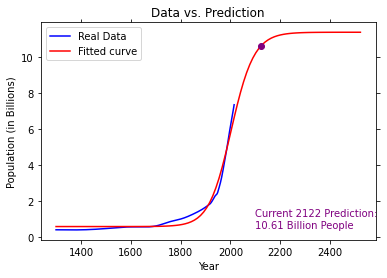

Iteration #33900, Loss: 0.05118905940639136


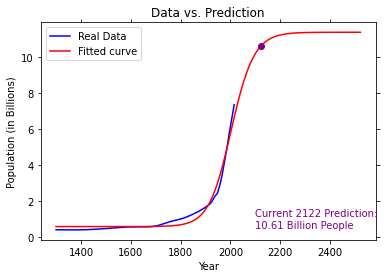

Iteration #33950, Loss: 0.05118415695625093


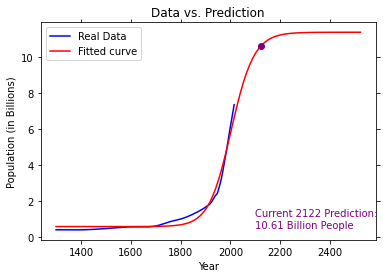

Iteration #34000, Loss: 0.051179269446415994


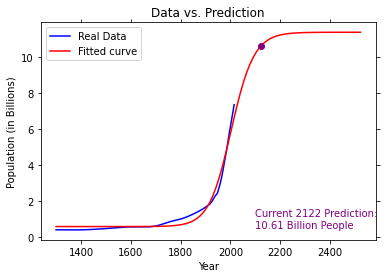

Iteration #34050, Loss: 0.05117439688037487


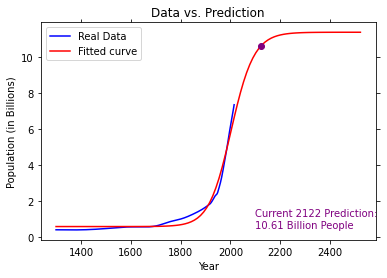

Iteration #34100, Loss: 0.051169539261600595


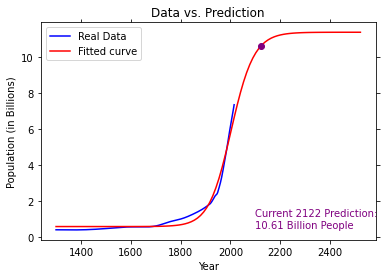

Iteration #34150, Loss: 0.051164696593550614


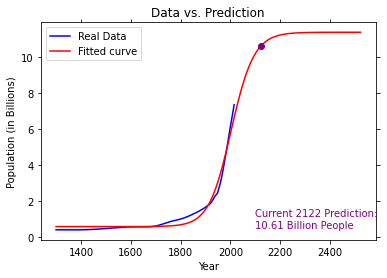

Iteration #34200, Loss: 0.05115986887966868


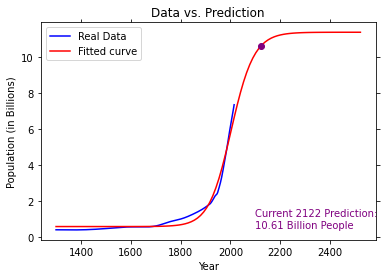

Iteration #34250, Loss: 0.05115505612338116


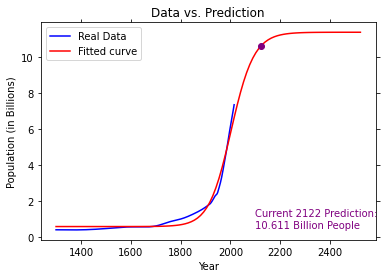

Iteration #34300, Loss: 0.05115025832810035


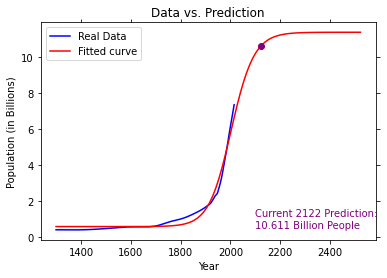

Iteration #34350, Loss: 0.051145475497222495


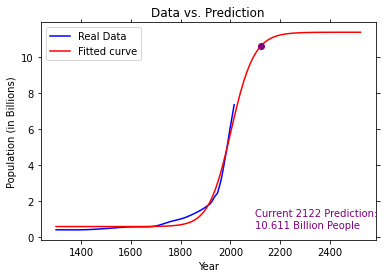

Iteration #34400, Loss: 0.05114070763412855


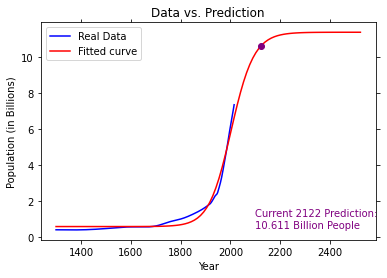

Iteration #34450, Loss: 0.05113595474218339


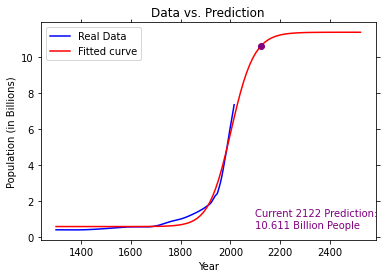

Iteration #34500, Loss: 0.05113121682473621


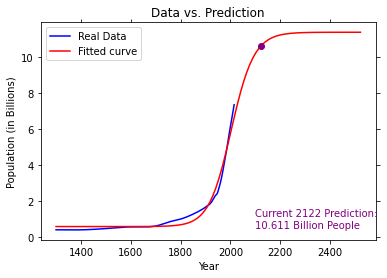

Iteration #34550, Loss: 0.05112649388512052


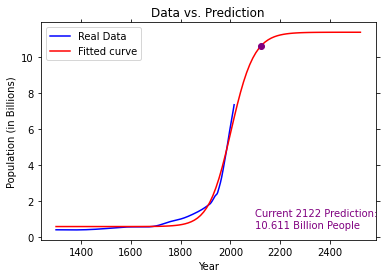

Iteration #34600, Loss: 0.05112178592665333


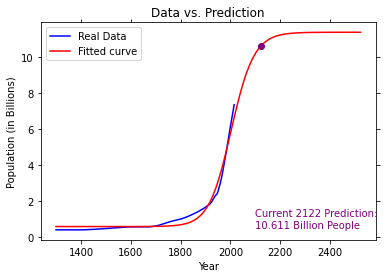

Iteration #34650, Loss: 0.051117092952636126


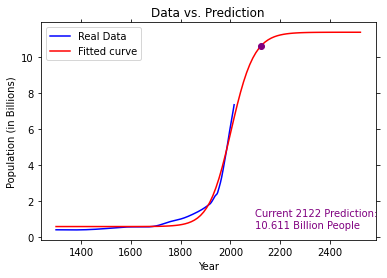

Iteration #34700, Loss: 0.05111241496635394


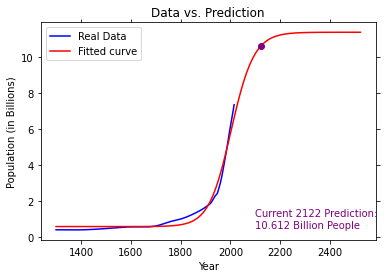

Iteration #34750, Loss: 0.05110775197107544


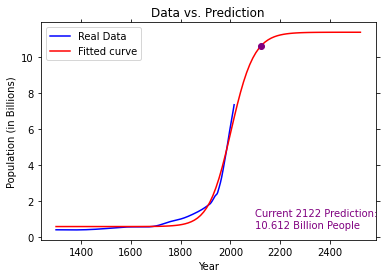

Iteration #34800, Loss: 0.05110310397005353


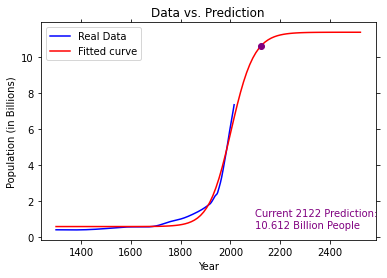

Iteration #34850, Loss: 0.05109847096652432


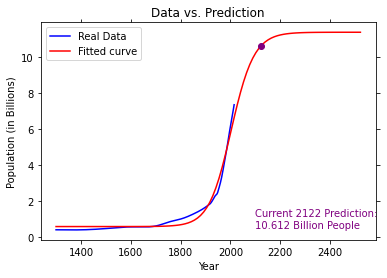

Iteration #34900, Loss: 0.05109385296370759


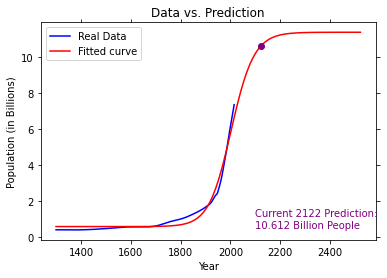

Iteration #34950, Loss: 0.05108924996480679


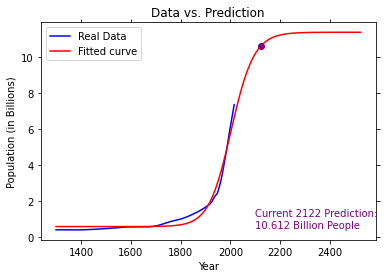

Iteration #35000, Loss: 0.051084661973008656


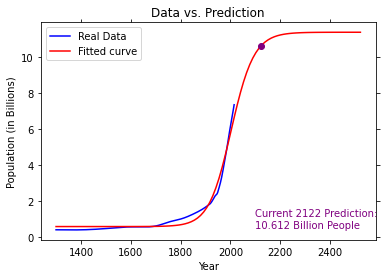

Iteration #35050, Loss: 0.05108008899148343


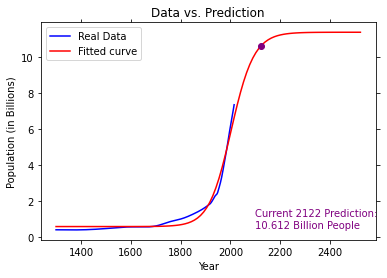

Iteration #35100, Loss: 0.05107553102338467


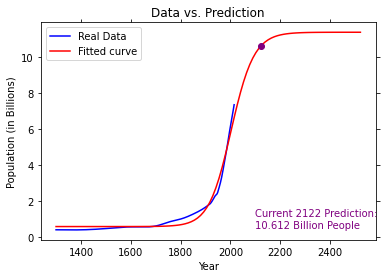

Iteration #35150, Loss: 0.05107098807184925


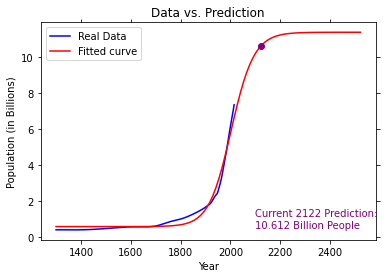

Iteration #35200, Loss: 0.05106646013999729


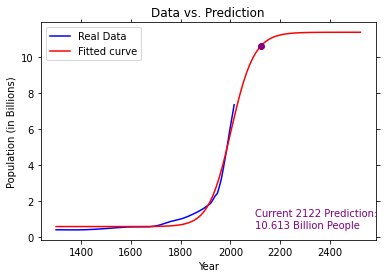

Iteration #35250, Loss: 0.05106194723093233


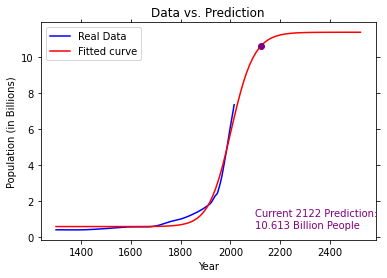

Iteration #35300, Loss: 0.05105744934774056


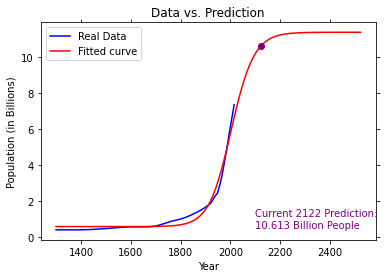

Iteration #35350, Loss: 0.05105296649349221


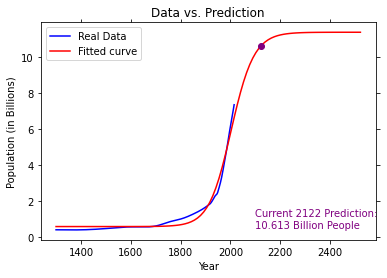

Iteration #35400, Loss: 0.051048498671239534


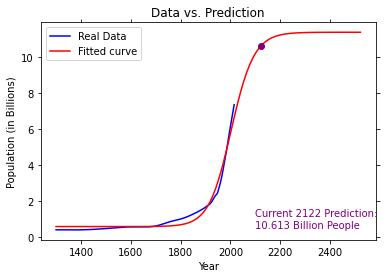

Iteration #35450, Loss: 0.05104404588401857


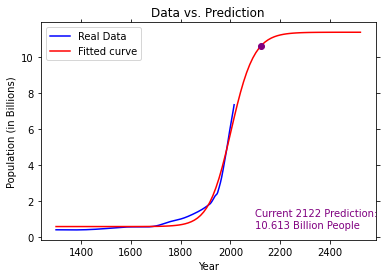

Iteration #35500, Loss: 0.051039608134848355


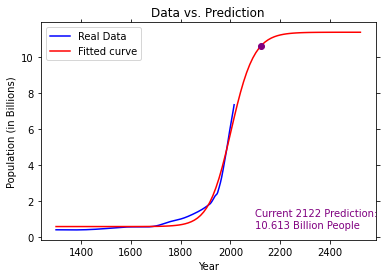

Iteration #35550, Loss: 0.051035185426730544


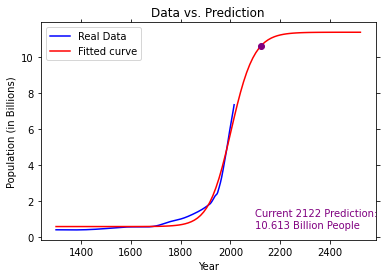

Iteration #35600, Loss: 0.05103077776265012


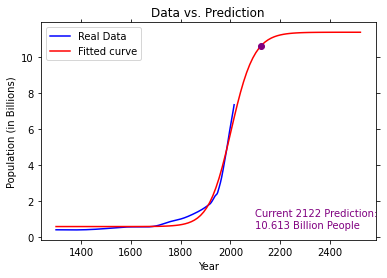

Iteration #35650, Loss: 0.051026385145574914


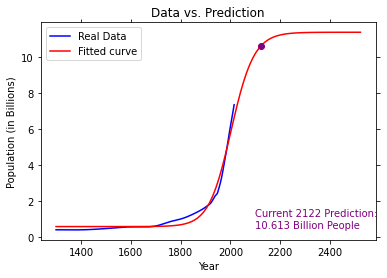

Iteration #35700, Loss: 0.05102200757845576


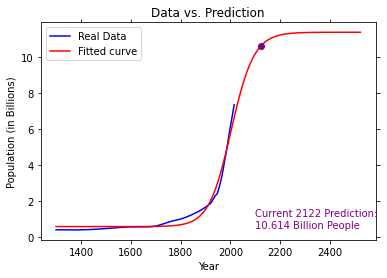

Iteration #35750, Loss: 0.05101764506422628


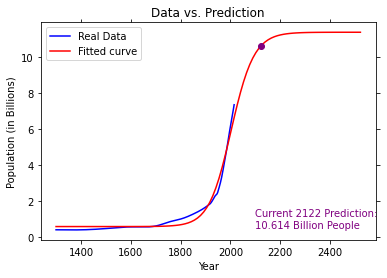

Iteration #35800, Loss: 0.05101329760580311


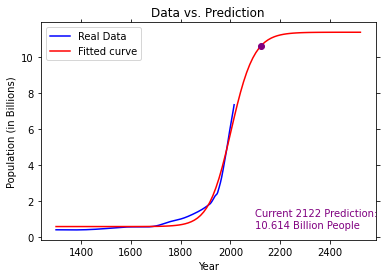

Iteration #35850, Loss: 0.051008965206085645


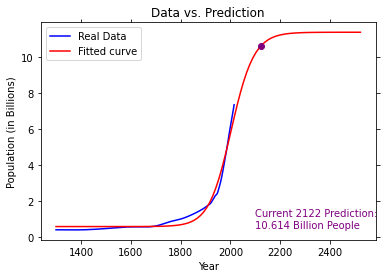

Iteration #35900, Loss: 0.0510046478679564


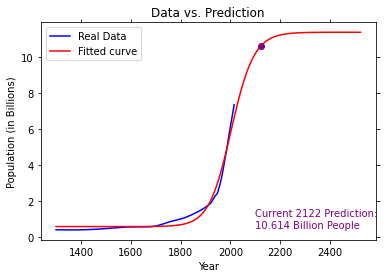

Iteration #35950, Loss: 0.051000345594280454


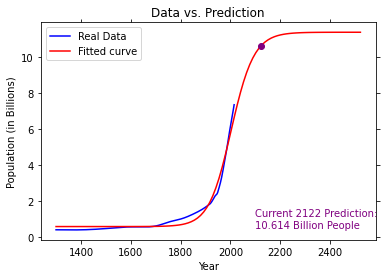

Iteration #36000, Loss: 0.05099605838790567


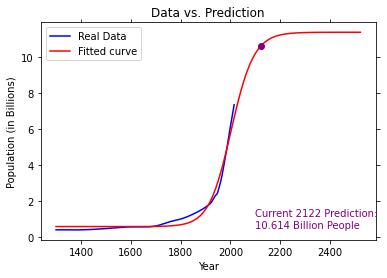

Iteration #36050, Loss: 0.050991786251663826


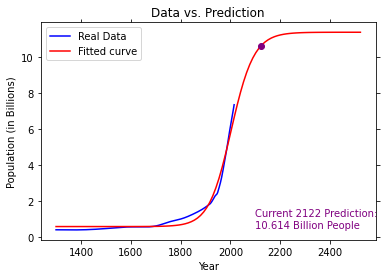

Iteration #36100, Loss: 0.05098752918836776


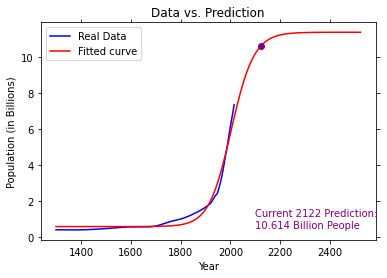

Iteration #36150, Loss: 0.05098328720081464


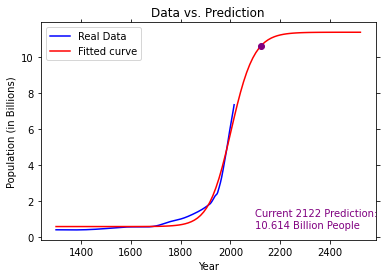

Iteration #36200, Loss: 0.0509790602917835


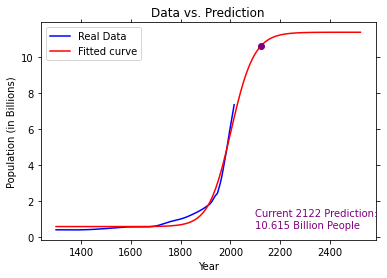

Iteration #36250, Loss: 0.05097484846403696


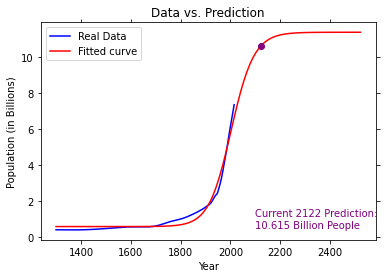

Iteration #36300, Loss: 0.05097065172031998


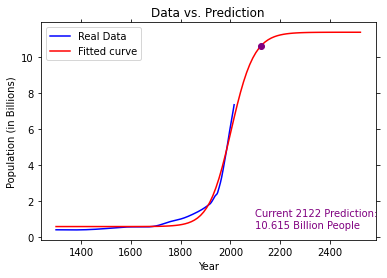

Iteration #36350, Loss: 0.050966470063360636


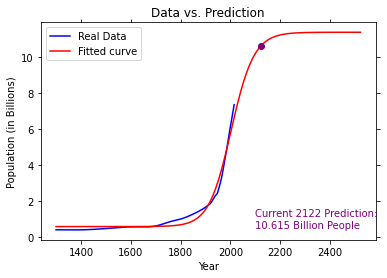

Iteration #36400, Loss: 0.05096230349586972


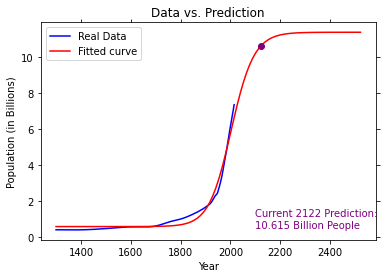

Iteration #36450, Loss: 0.050958152020540985


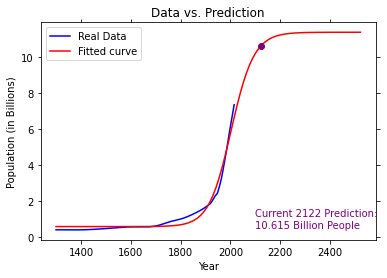

Iteration #36500, Loss: 0.0509540156400509


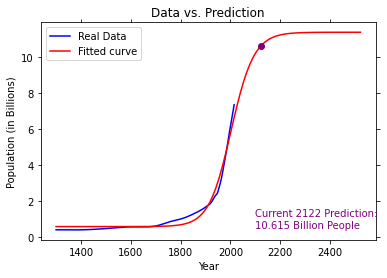

Iteration #36550, Loss: 0.050949894357059156


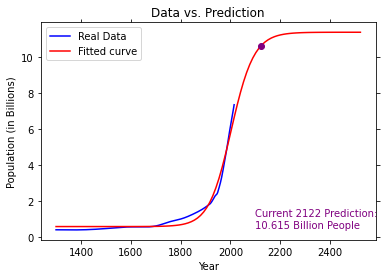

Iteration #36600, Loss: 0.05094578817420789


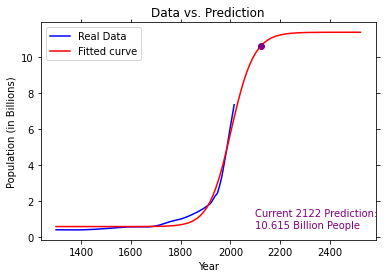

Iteration #36650, Loss: 0.050941697094122516


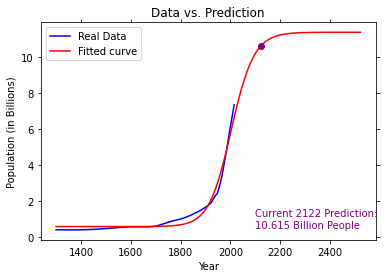

Iteration #36700, Loss: 0.05093762111941107


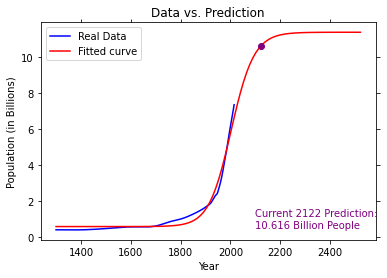

Iteration #36750, Loss: 0.050933560252665086


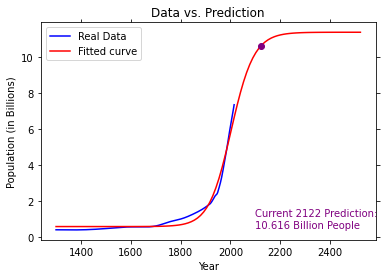

Iteration #36800, Loss: 0.05092951449645835


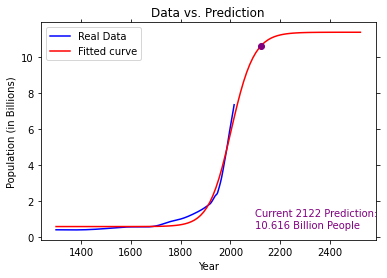

Iteration #36850, Loss: 0.050925483853348184


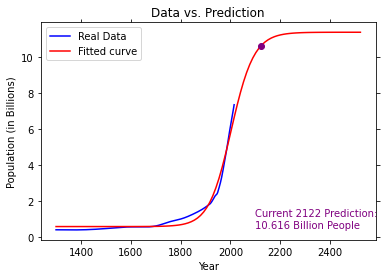

Iteration #36900, Loss: 0.05092146832587458


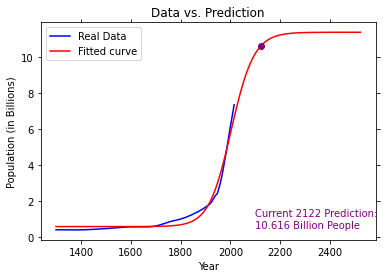

Iteration #36950, Loss: 0.05091746791656084


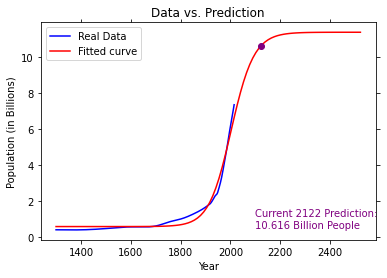

Iteration #37000, Loss: 0.050913482627913065


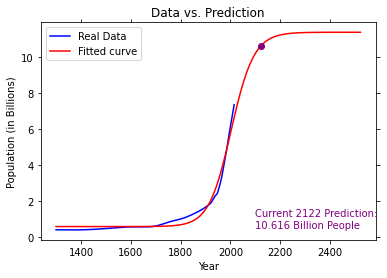

Iteration #37050, Loss: 0.050909512462420675


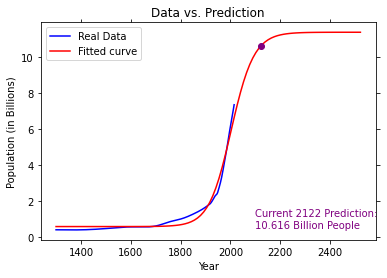

Iteration #37100, Loss: 0.05090555742255618


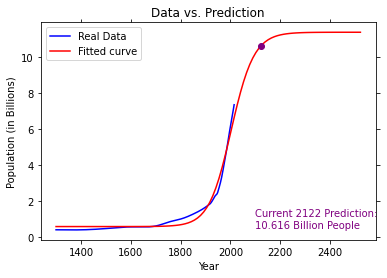

Iteration #37150, Loss: 0.05090161751077496


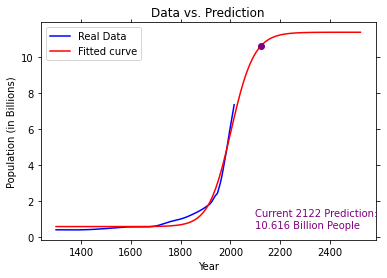

Iteration #37200, Loss: 0.05089769272951598


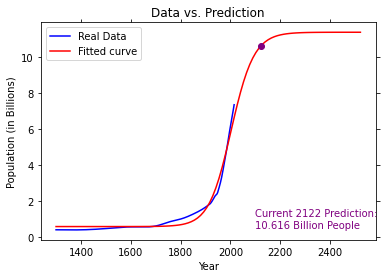

Iteration #37250, Loss: 0.050893783081201065


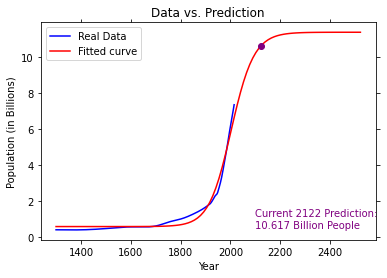

Iteration #37300, Loss: 0.050889888568235515


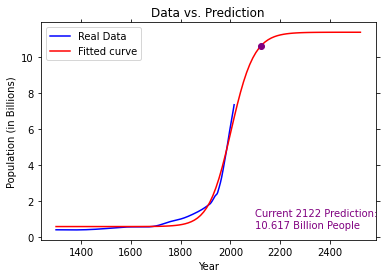

Iteration #37350, Loss: 0.05088600919300774


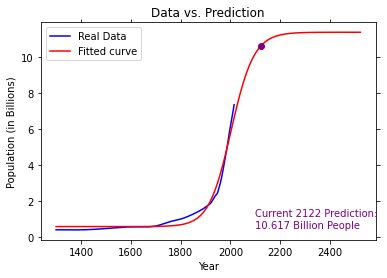

Iteration #37400, Loss: 0.050882144957889626


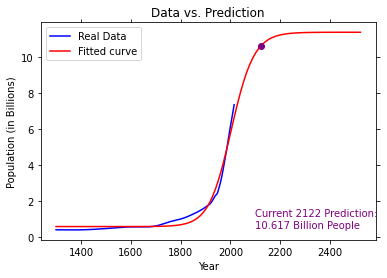

Iteration #37450, Loss: 0.050878295865236345


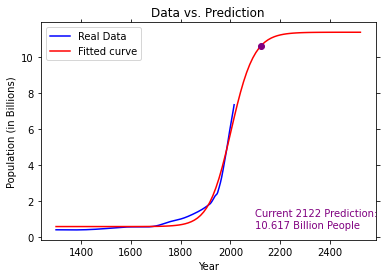

Iteration #37500, Loss: 0.050874461917386385


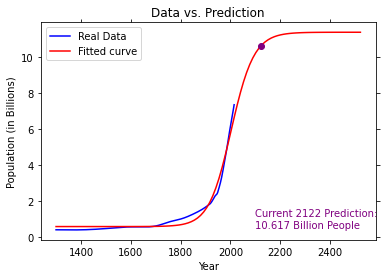

Iteration #37550, Loss: 0.05087064311666161


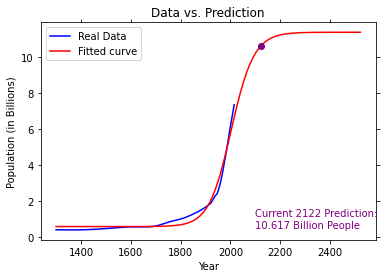

Iteration #37600, Loss: 0.0508668394653676


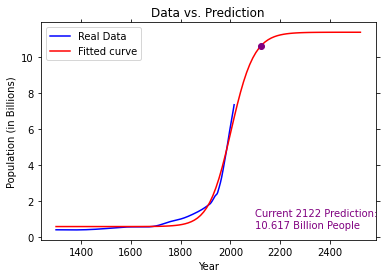

Iteration #37650, Loss: 0.050863050965793306


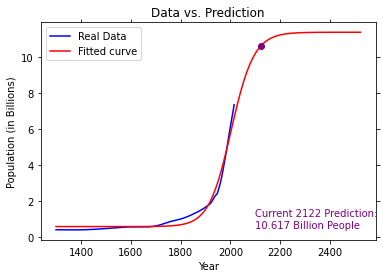

Iteration #37700, Loss: 0.05085927762021088


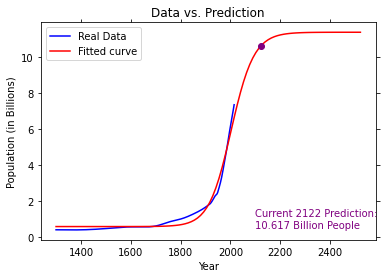

Iteration #37750, Loss: 0.05085551943087678


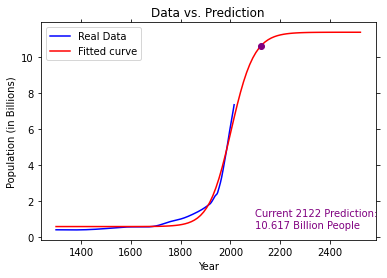

Iteration #37800, Loss: 0.05085177640003055


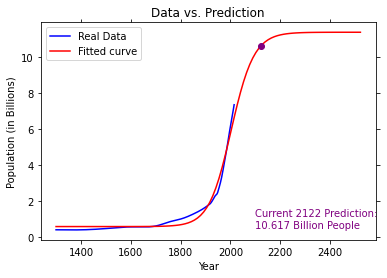

Iteration #37850, Loss: 0.05084804852989561


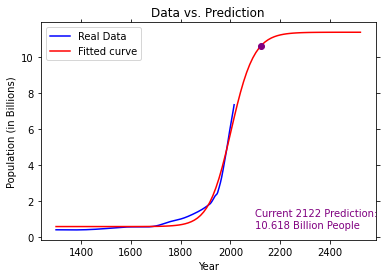

Iteration #37900, Loss: 0.05084433582267879


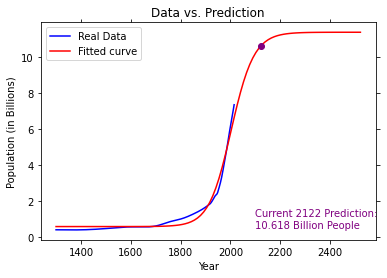

Iteration #37950, Loss: 0.050840638280571754


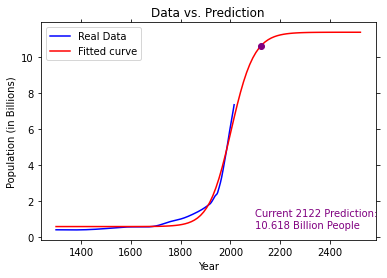

Iteration #38000, Loss: 0.050836955905748486


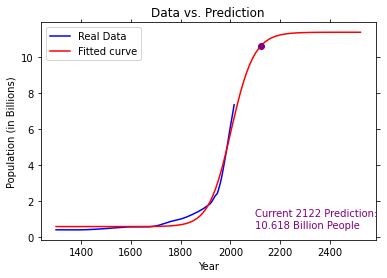

Iteration #38050, Loss: 0.050833288700367435


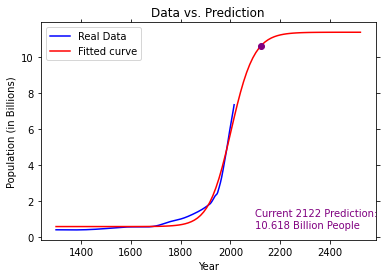

Iteration #38100, Loss: 0.050829636666572045


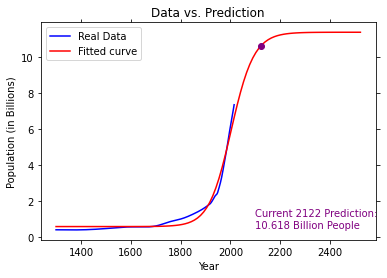

Iteration #38150, Loss: 0.050825999806487825


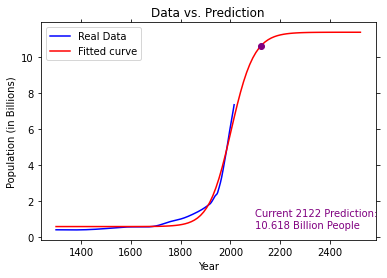

Iteration #38200, Loss: 0.05082237812222562


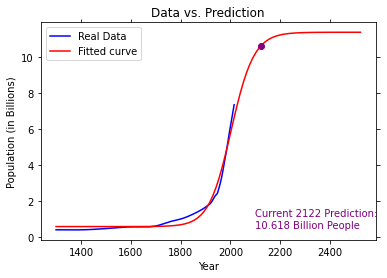

Iteration #38250, Loss: 0.05081877161587992


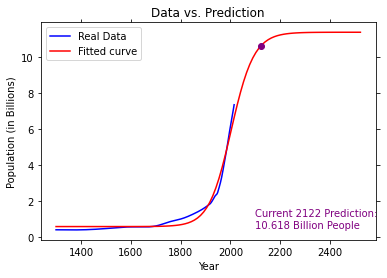

Iteration #38300, Loss: 0.05081518028952957


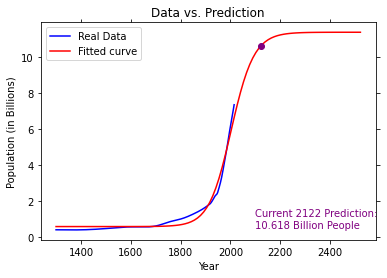

Iteration #38350, Loss: 0.05081160414523727


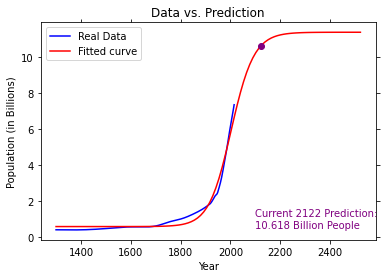

Iteration #38400, Loss: 0.05080804318505006


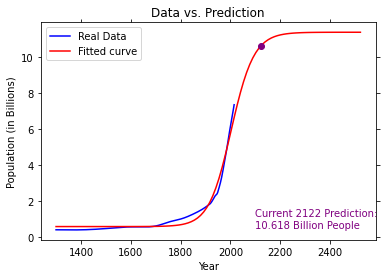

Iteration #38450, Loss: 0.05080449741099952


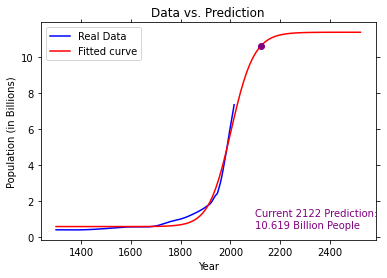

Iteration #38500, Loss: 0.0508009668251012


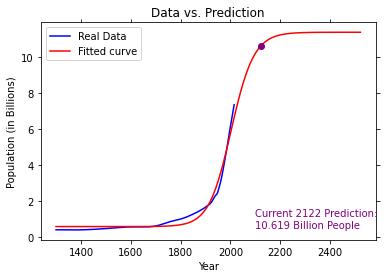

Iteration #38550, Loss: 0.050797451429355295


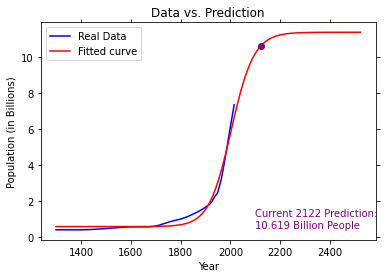

Iteration #38600, Loss: 0.05079395122574637


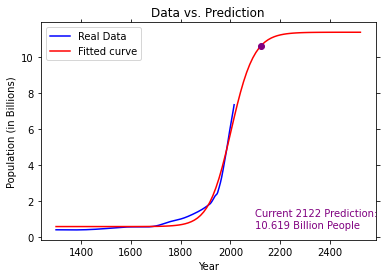

Iteration #38650, Loss: 0.05079046621624352


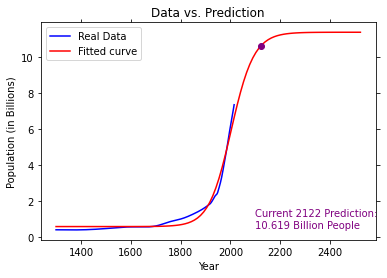

Iteration #38700, Loss: 0.05078699640280038


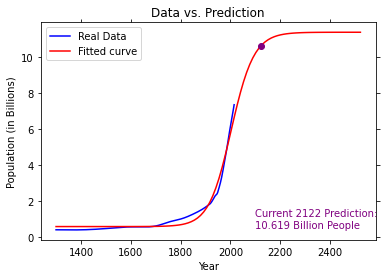

Iteration #38750, Loss: 0.050783541787355335


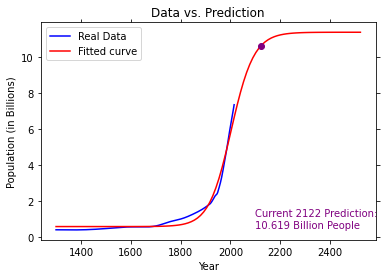

Iteration #38800, Loss: 0.0507801023718312


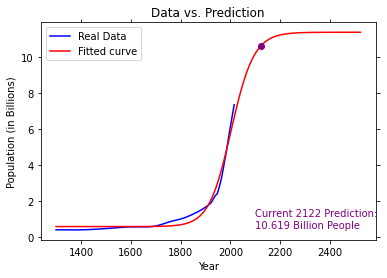

Iteration #38850, Loss: 0.05077667815813582


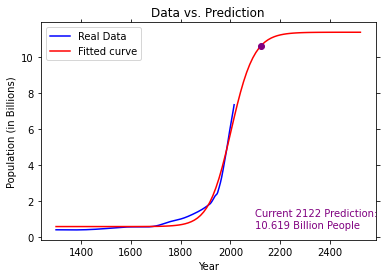

Iteration #38900, Loss: 0.050773269148161715


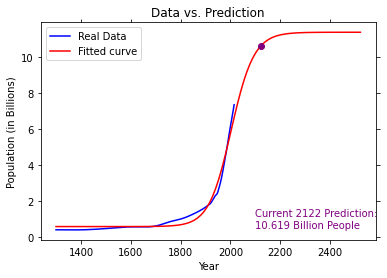

Iteration #38950, Loss: 0.05076987534378639


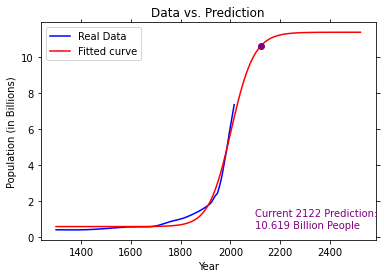

Iteration #39000, Loss: 0.05076649674687198


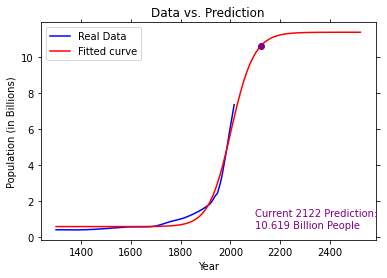

Iteration #39050, Loss: 0.0507631333592657


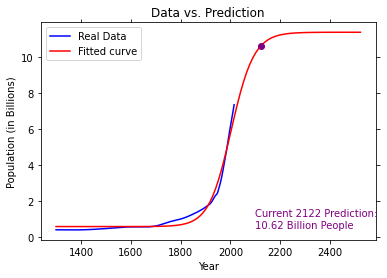

Iteration #39100, Loss: 0.0507597851828008


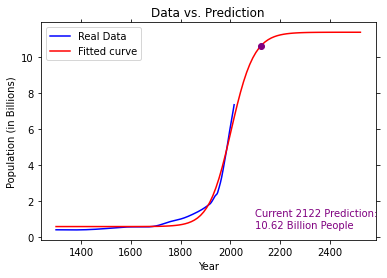

Iteration #39150, Loss: 0.05075645221929395


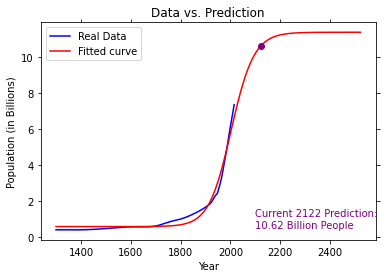

Iteration #39200, Loss: 0.050753134470548064


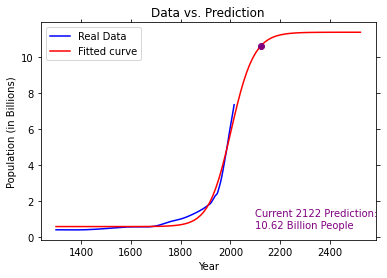

Iteration #39250, Loss: 0.05074983193835106


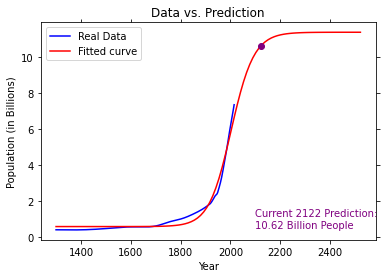

Iteration #39300, Loss: 0.050746544624476426


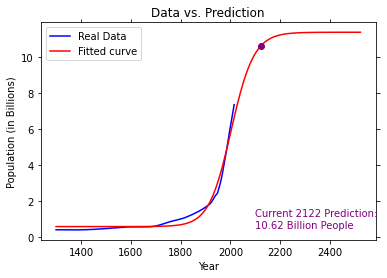

Iteration #39350, Loss: 0.050743272530682546


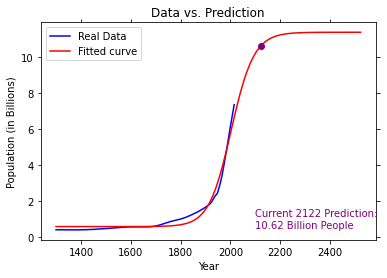

Iteration #39400, Loss: 0.05074001565871371


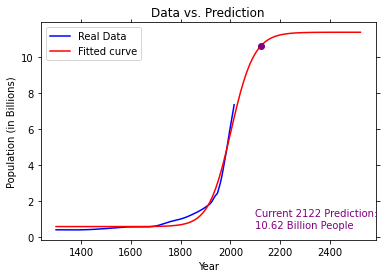

Iteration #39450, Loss: 0.05073677401029929


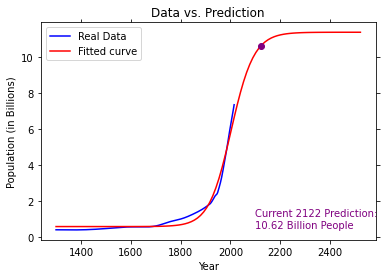

Iteration #39500, Loss: 0.050733547587154613


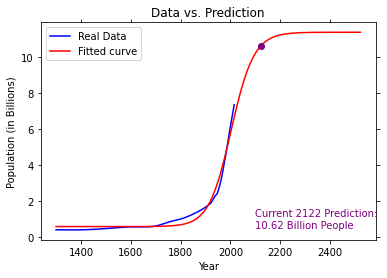

Iteration #39550, Loss: 0.05073033639098045


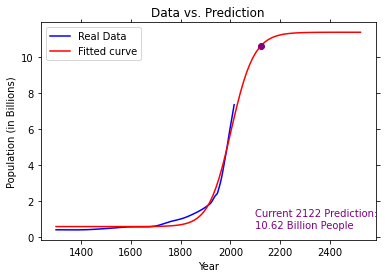

Iteration #39600, Loss: 0.05072714042346329


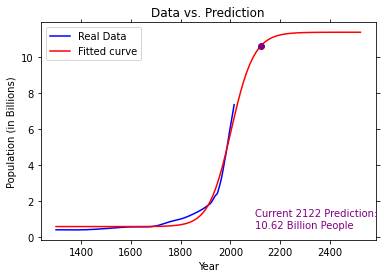

Iteration #39650, Loss: 0.05072395968627539


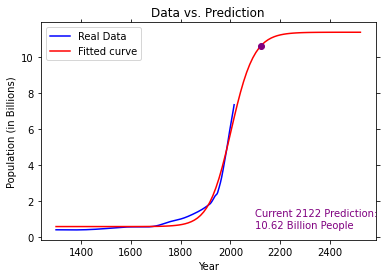

Iteration #39700, Loss: 0.05072079418107486


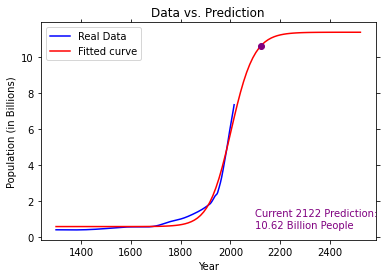

Iteration #39750, Loss: 0.05071764390950589


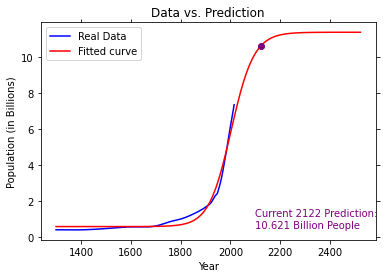

Iteration #39800, Loss: 0.050714508873198255


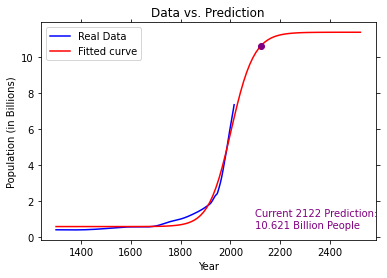

Iteration #39850, Loss: 0.05071138907376815


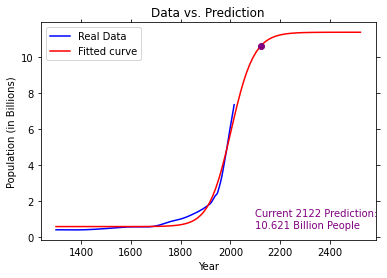

Iteration #39900, Loss: 0.0507082845128178


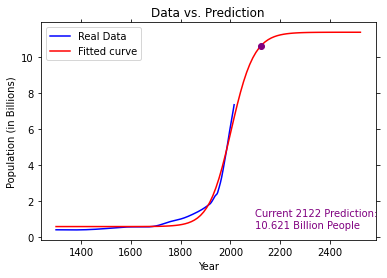

Iteration #39950, Loss: 0.05070519519193528


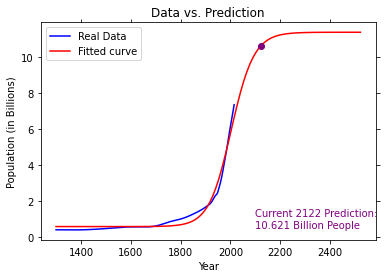

Iteration #40000, Loss: 0.05070212111269545


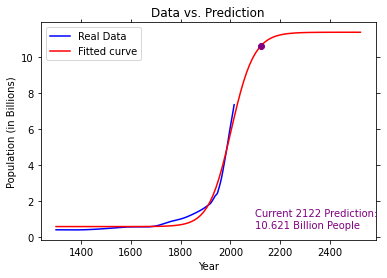

Iteration #40050, Loss: 0.05069906227665914


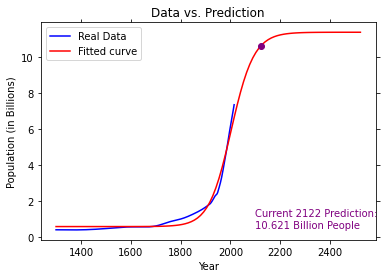

Iteration #40100, Loss: 0.050696018685373566


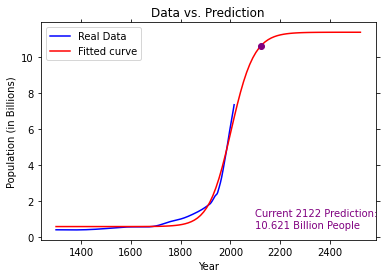

Iteration #40150, Loss: 0.0506929903403726


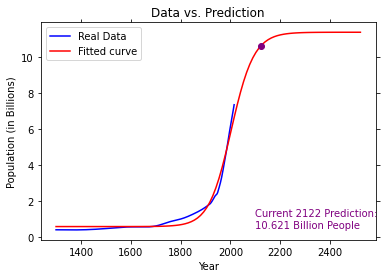

Iteration #40200, Loss: 0.0506899772431764


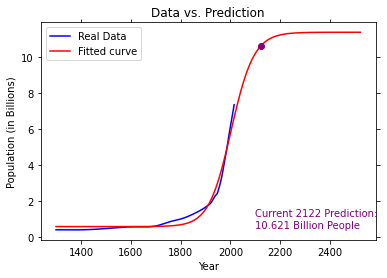

Iteration #40250, Loss: 0.05068697939529189


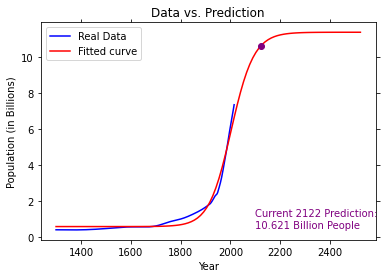

Iteration #40300, Loss: 0.05068399679821273


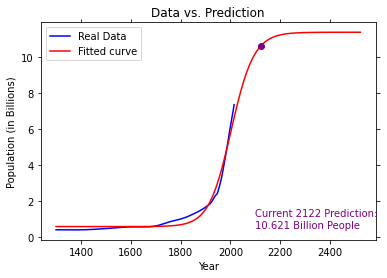

Iteration #40350, Loss: 0.05068102945341902


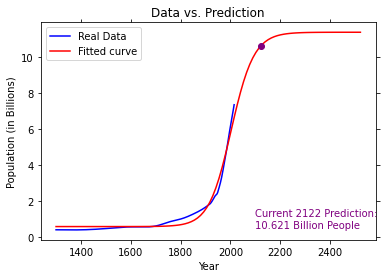

Iteration #40400, Loss: 0.05067807736237814


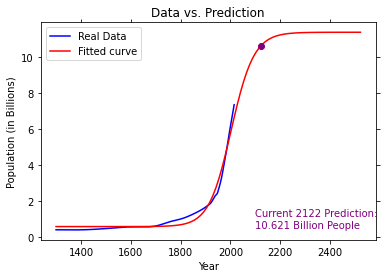

Iteration #40450, Loss: 0.05067514052654352


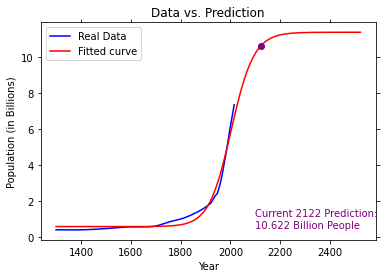

Iteration #40500, Loss: 0.050672218947356566


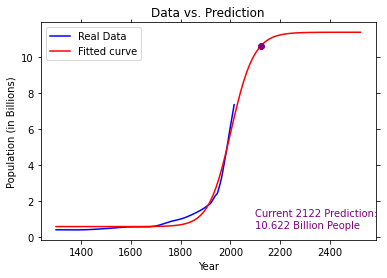

Iteration #40550, Loss: 0.05066931262624499


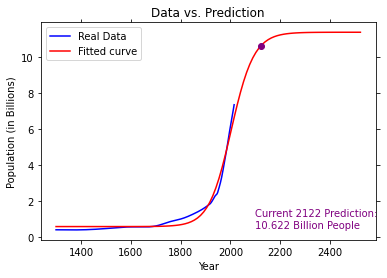

Iteration #40600, Loss: 0.05066642156462398


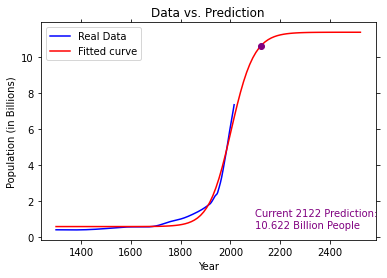

Iteration #40650, Loss: 0.050663545763895514


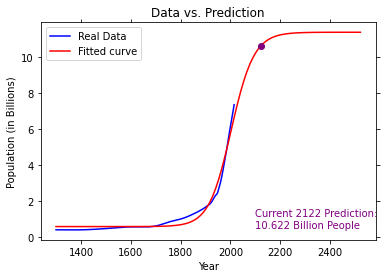

Iteration #40700, Loss: 0.05066068522544916


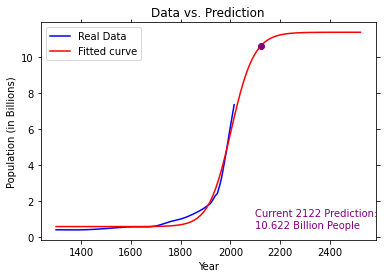

Iteration #40750, Loss: 0.05065783995066161


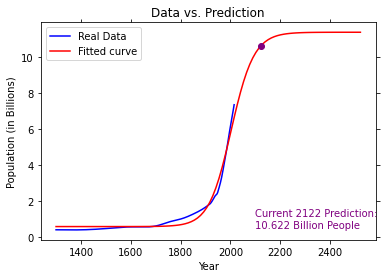

Iteration #40800, Loss: 0.05065500994089686


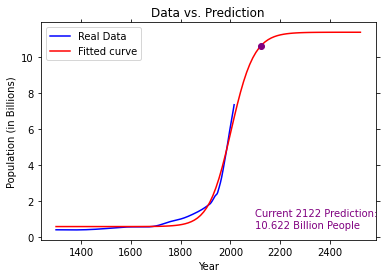

Iteration #40850, Loss: 0.05065219519750642


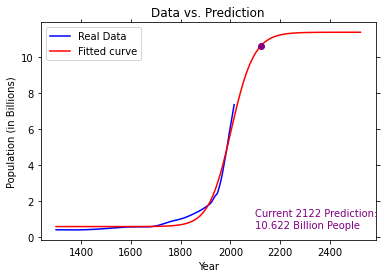

Iteration #40900, Loss: 0.050649395721829554


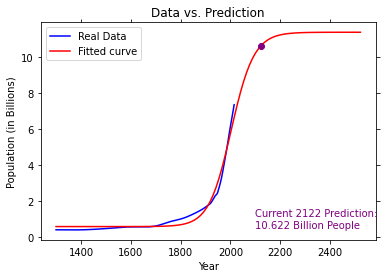

Iteration #40950, Loss: 0.05064661151519271


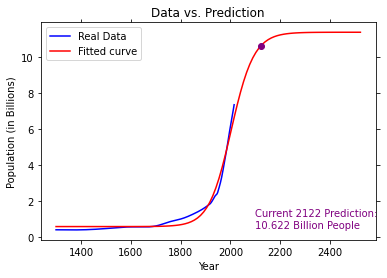

Iteration #41000, Loss: 0.05064384257891027


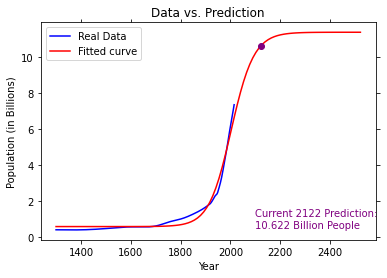

Iteration #41050, Loss: 0.050641088914284205


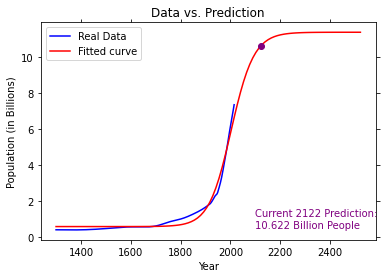

Iteration #41100, Loss: 0.050638350522604354


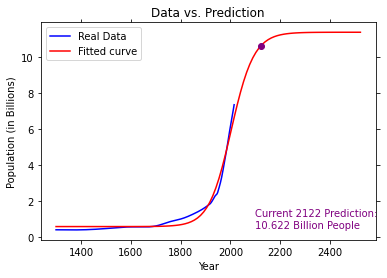

Iteration #41150, Loss: 0.05063562740514845


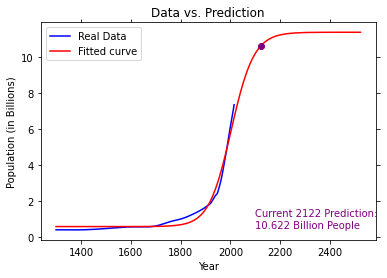

Iteration #41200, Loss: 0.05063291956318208


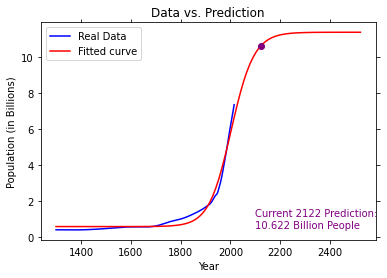

Iteration #41250, Loss: 0.050630226997958966


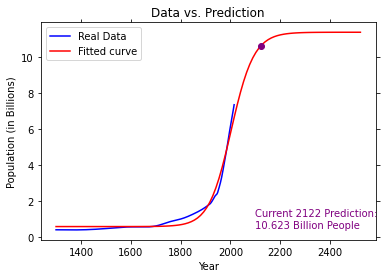

Iteration #41300, Loss: 0.05062754971072066


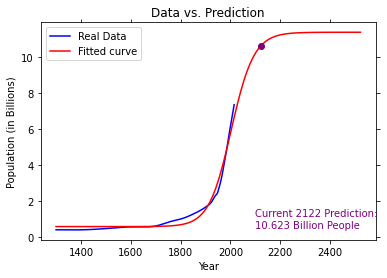

Iteration #41350, Loss: 0.05062488770269723


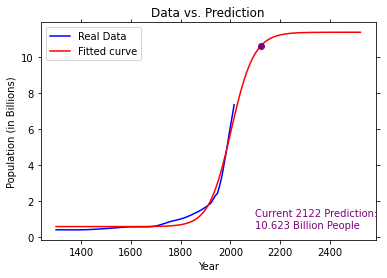

Iteration #41400, Loss: 0.050622240975106744


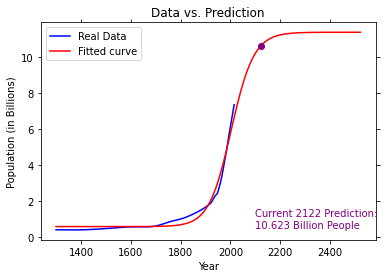

Iteration #41450, Loss: 0.05061960952915562


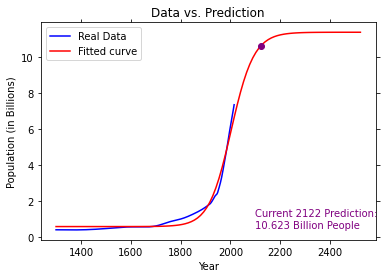

Iteration #41500, Loss: 0.050616993366038726


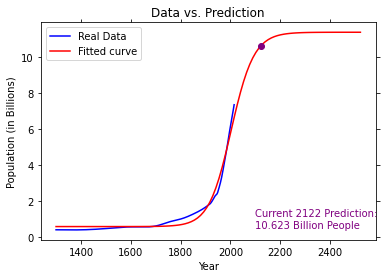

Iteration #41550, Loss: 0.05061439248693913


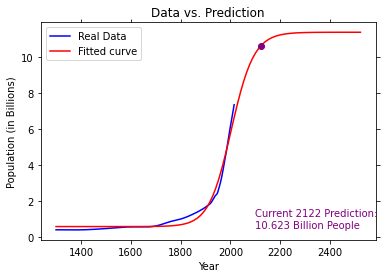

Iteration #41600, Loss: 0.05061180689302865


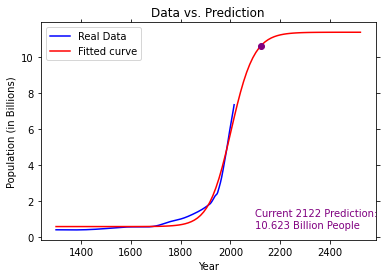

Iteration #41650, Loss: 0.05060923658546769


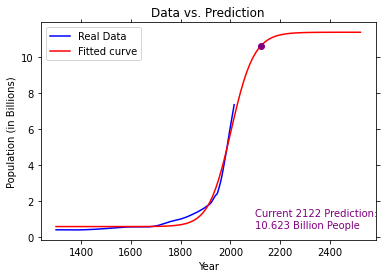

Iteration #41700, Loss: 0.05060668156540505


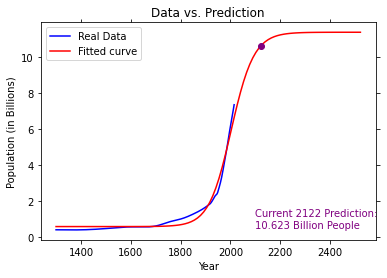

Iteration #41750, Loss: 0.05060414183397857


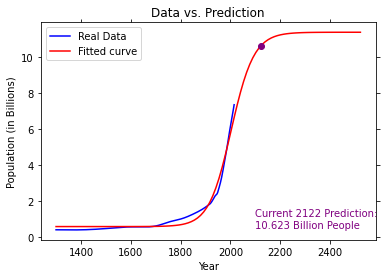

Iteration #41800, Loss: 0.05060161739231469


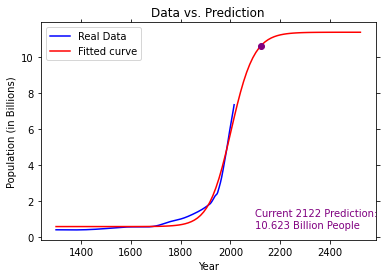

Iteration #41850, Loss: 0.05059910824152879


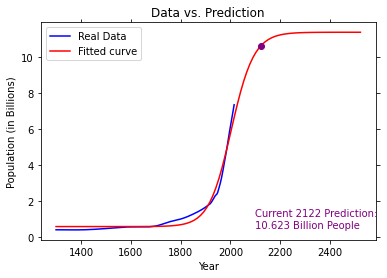

Iteration #41900, Loss: 0.05059661438272506


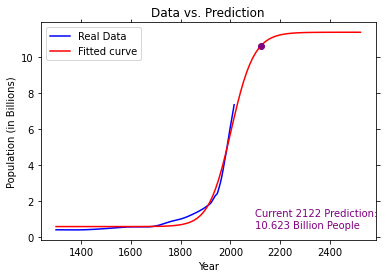

Iteration #41950, Loss: 0.050594135816996955


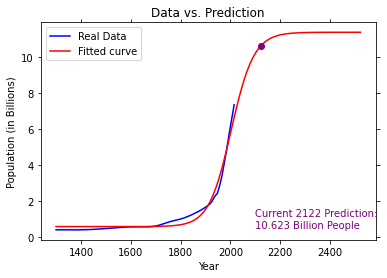

Iteration #42000, Loss: 0.050591672545426715


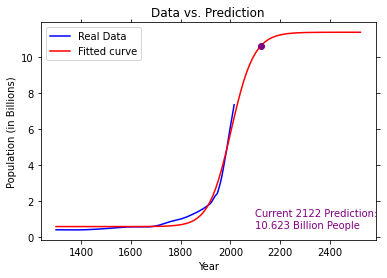

Iteration #42050, Loss: 0.05058922456908592


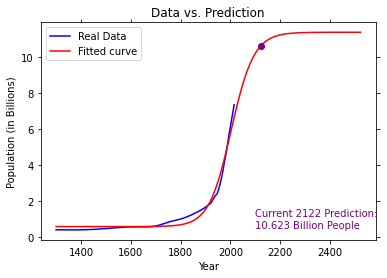

Iteration #42100, Loss: 0.05058679188903519


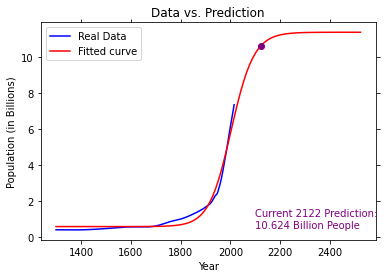

Iteration #42150, Loss: 0.050584374506324664


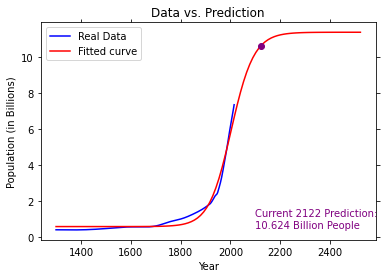

Iteration #42200, Loss: 0.050581972421993554


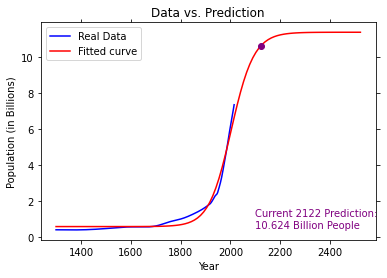

Iteration #42250, Loss: 0.05057958563707069


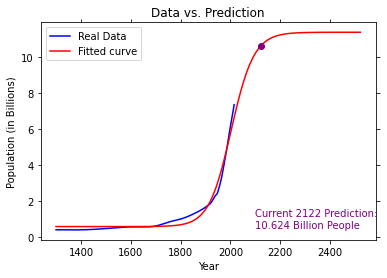

Iteration #42300, Loss: 0.05057721415257444


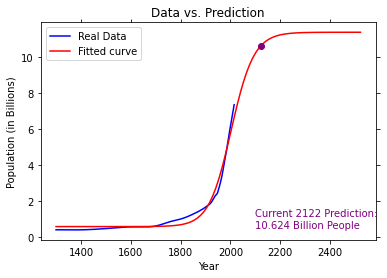

Iteration #42350, Loss: 0.05057485796951242


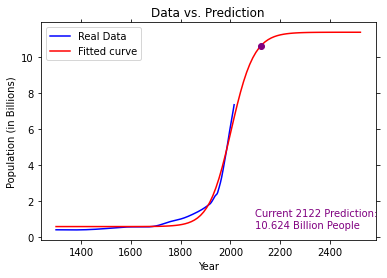

Iteration #42400, Loss: 0.050572517088882364


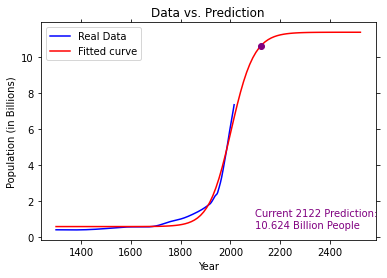

Iteration #42450, Loss: 0.05057019151167111


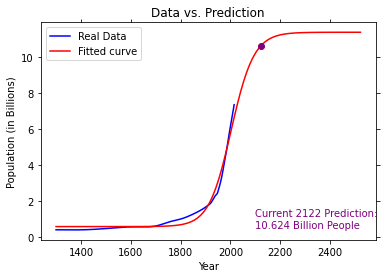

Iteration #42500, Loss: 0.05056788123885585


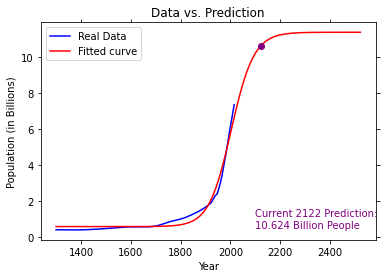

Iteration #42550, Loss: 0.050565586271403146


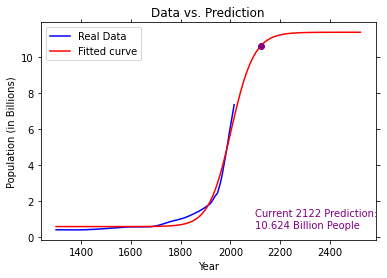

Iteration #42600, Loss: 0.05056330661026964


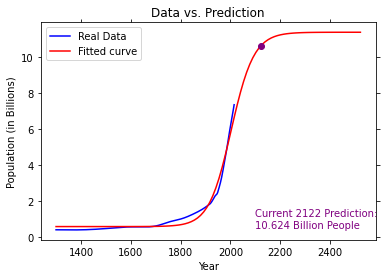

Iteration #42650, Loss: 0.050561042256402094


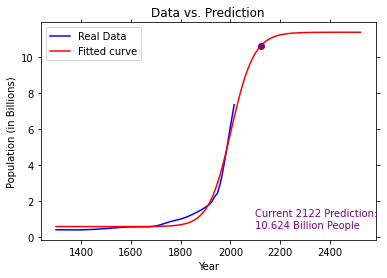

Iteration #42700, Loss: 0.05055879321073702


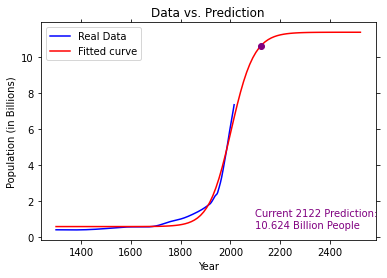

Iteration #42750, Loss: 0.05055655947420102


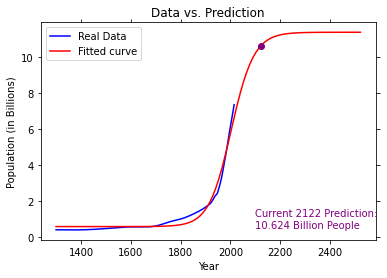

Iteration #42800, Loss: 0.05055434104771129


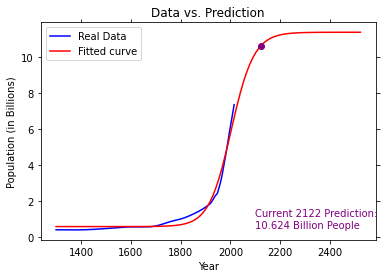

Iteration #42850, Loss: 0.05055213793217491


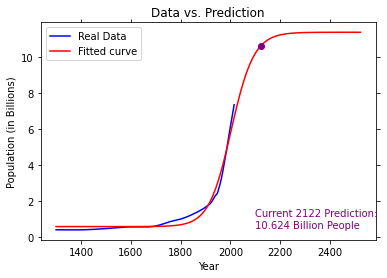

Iteration #42900, Loss: 0.05054995012848917


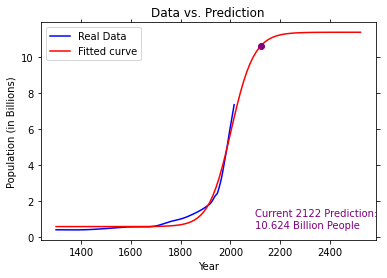

Iteration #42950, Loss: 0.05054777763754212


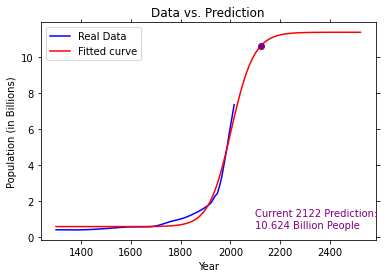

Iteration #43000, Loss: 0.05054562046021172


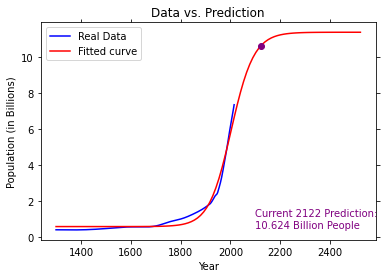

Iteration #43050, Loss: 0.05054347859736706


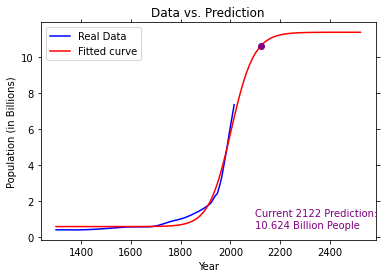

Iteration #43100, Loss: 0.050541352049867115


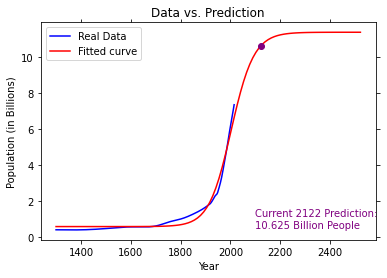

Iteration #43150, Loss: 0.05053924081856203


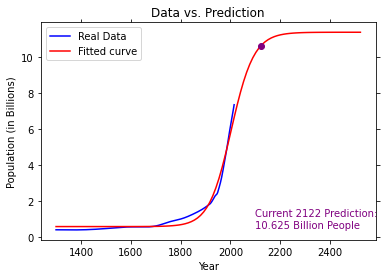

Iteration #43200, Loss: 0.05053714490429235


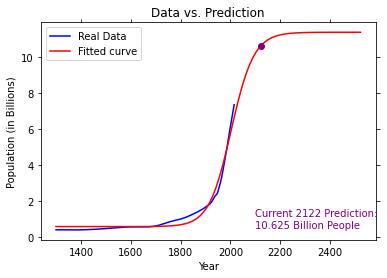

Iteration #43250, Loss: 0.05053506430788949


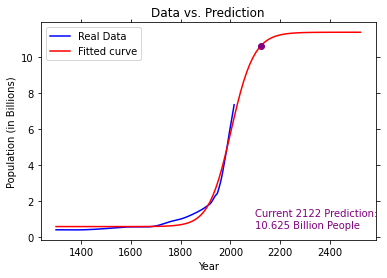

Iteration #43300, Loss: 0.05053299903017574


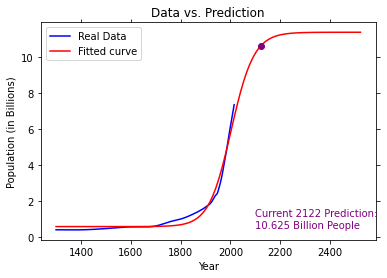

Iteration #43350, Loss: 0.05053094907196433


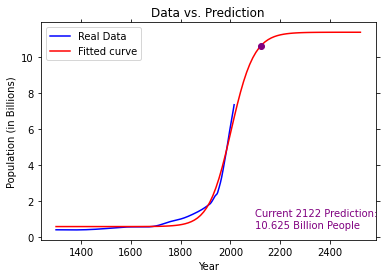

Iteration #43400, Loss: 0.050528914434058554


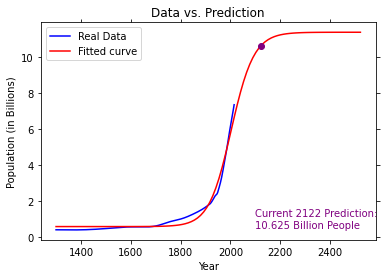

Iteration #43450, Loss: 0.05052689511725432


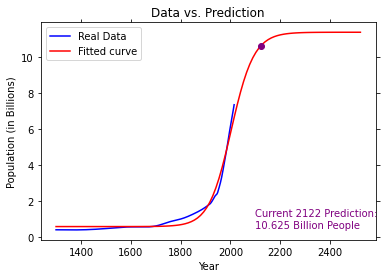

Iteration #43500, Loss: 0.0505248911223374


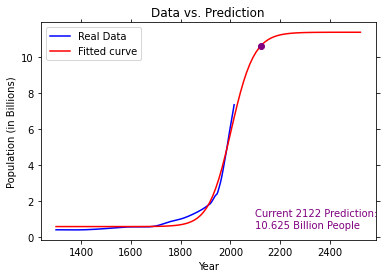

Iteration #43550, Loss: 0.050522902450085214


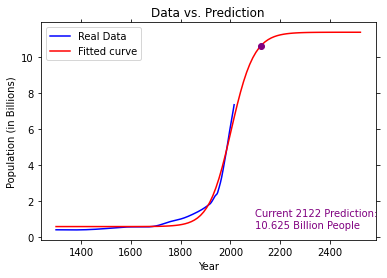

Iteration #43600, Loss: 0.05052092910126606


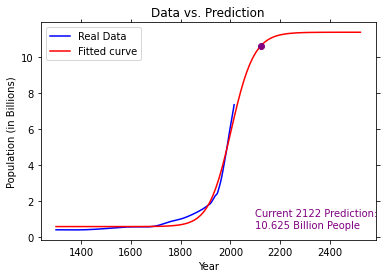

Iteration #43650, Loss: 0.05051897107663968


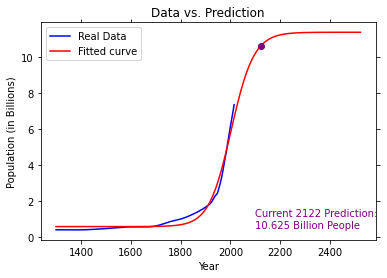

Iteration #43700, Loss: 0.050517028376957276


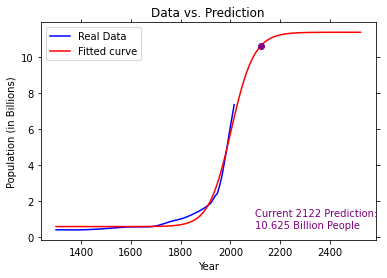

Iteration #43750, Loss: 0.05051510100296115


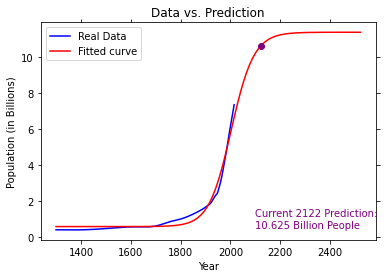

Iteration #43800, Loss: 0.05051318895538511


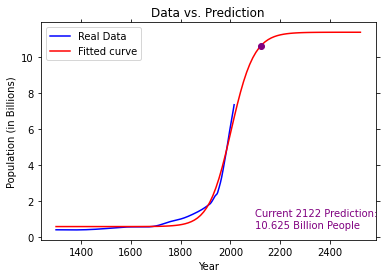

Iteration #43850, Loss: 0.050511292234955214


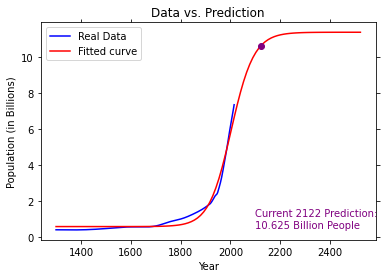

Iteration #43900, Loss: 0.05050941084238764


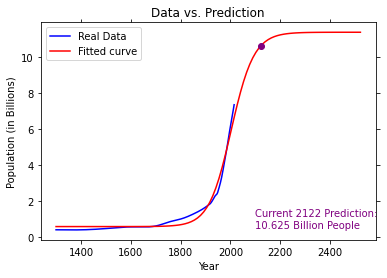

Iteration #43950, Loss: 0.050507544778391214


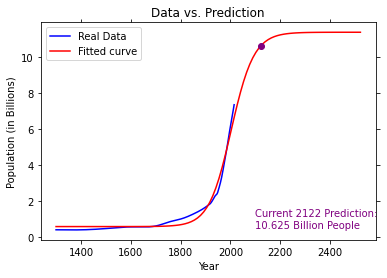

Iteration #44000, Loss: 0.050505694043666324


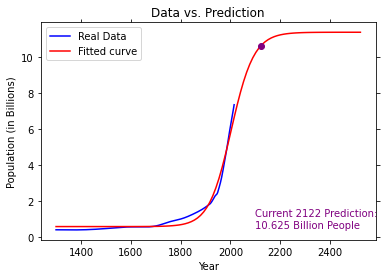

Iteration #44050, Loss: 0.05050385863890486


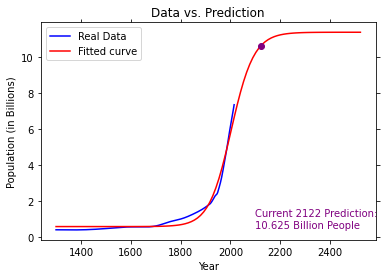

Iteration #44100, Loss: 0.05050203856479076


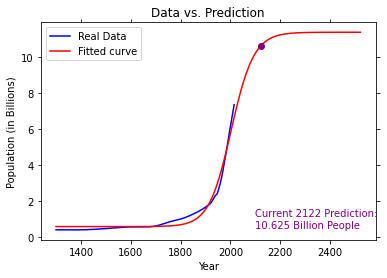

Iteration #44150, Loss: 0.05050023382199976


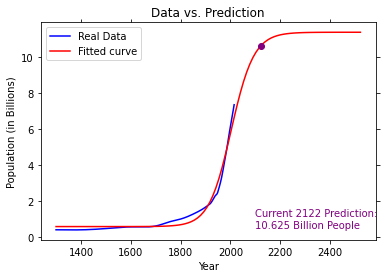

Iteration #44200, Loss: 0.050498444411199134


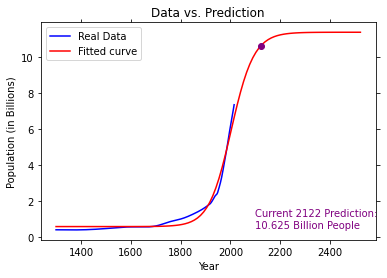

Iteration #44250, Loss: 0.05049667033304921


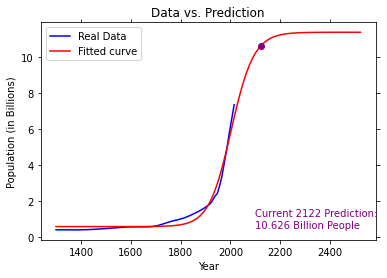

Iteration #44300, Loss: 0.05049491158820094


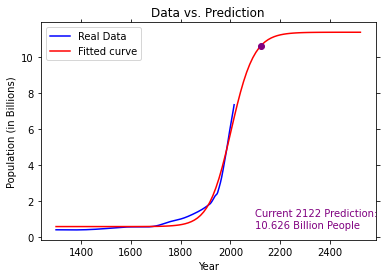

Iteration #44350, Loss: 0.05049316817729818


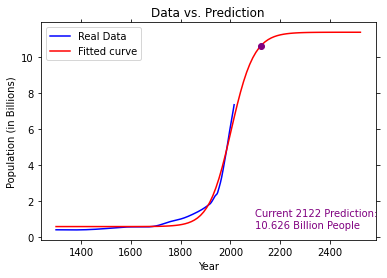

Iteration #44400, Loss: 0.050491440100976996


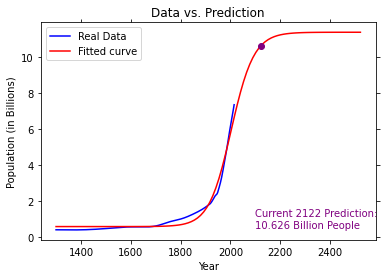

Iteration #44450, Loss: 0.05048972735986534


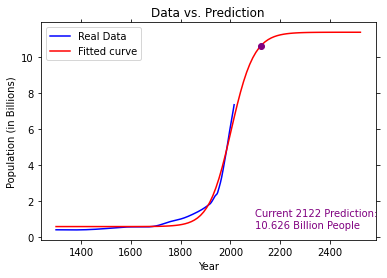

Iteration #44500, Loss: 0.05048802995458359


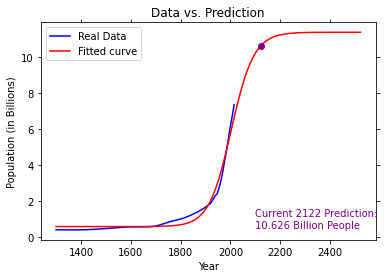

Iteration #44550, Loss: 0.05048634788574452


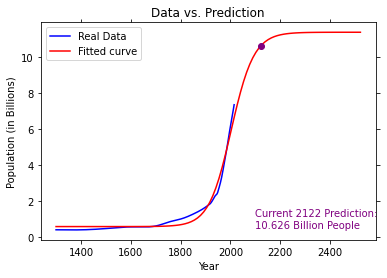

Iteration #44600, Loss: 0.05048468115395312


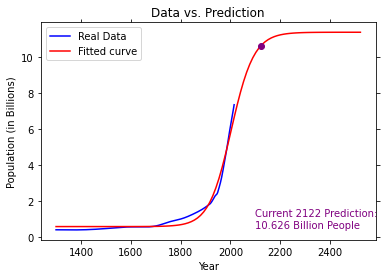

Iteration #44650, Loss: 0.0504830297598067


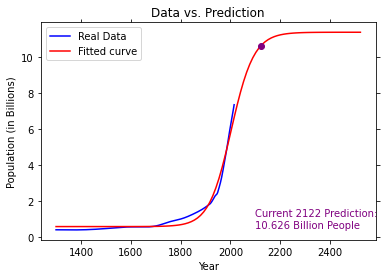

Iteration #44700, Loss: 0.05048139370389528


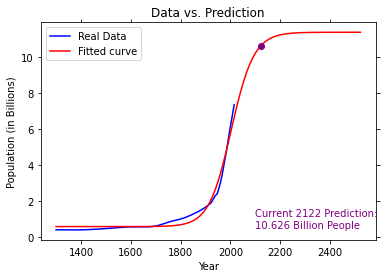

Iteration #44750, Loss: 0.05047977298680161


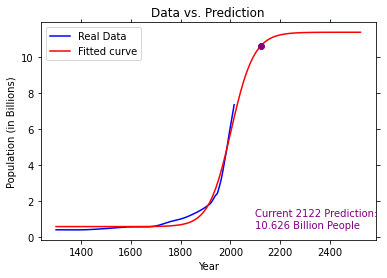

Iteration #44800, Loss: 0.050478167609100136


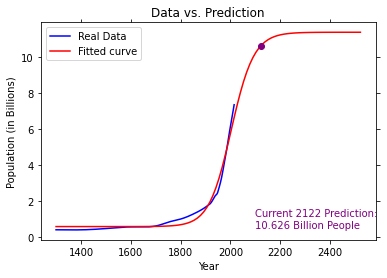

Iteration #44850, Loss: 0.05047657757135954


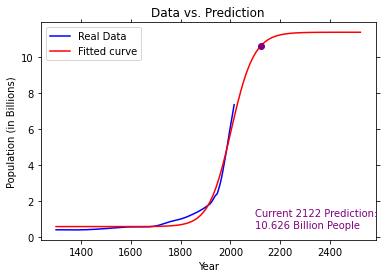

Iteration #44900, Loss: 0.0504750028741395


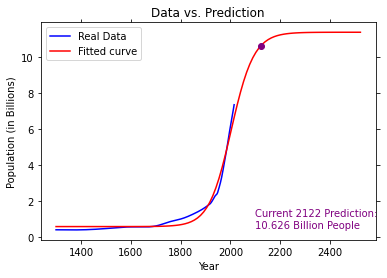

Iteration #44950, Loss: 0.05047344351799347


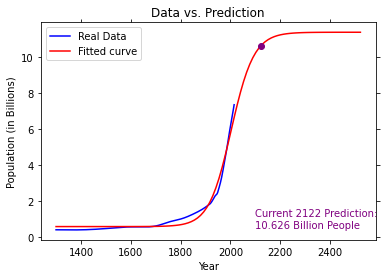

Iteration #45000, Loss: 0.05047189950346726


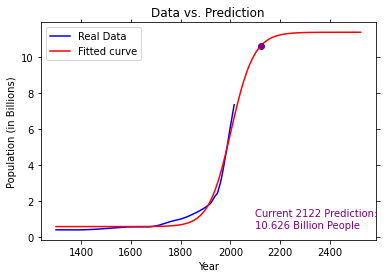

Iteration #45050, Loss: 0.05047037083109976


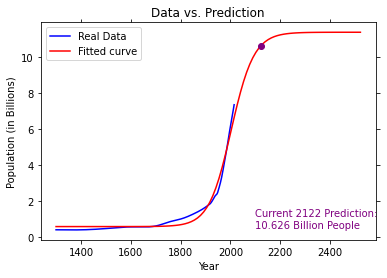

Iteration #45100, Loss: 0.050468857501422826


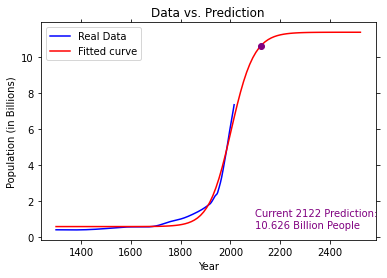

Iteration #45150, Loss: 0.05046735951496085


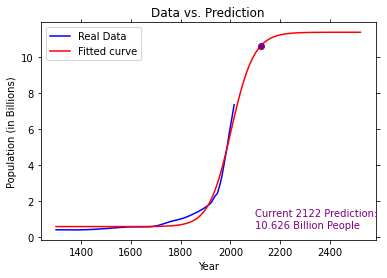

Iteration #45200, Loss: 0.0504658768722316


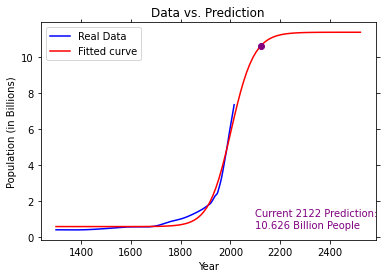

Iteration #45250, Loss: 0.05046440957374629


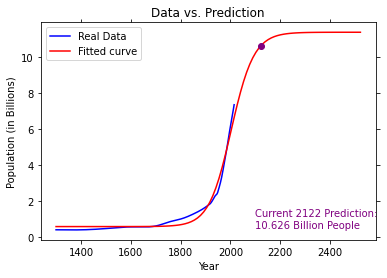

Iteration #45300, Loss: 0.050462957620008145


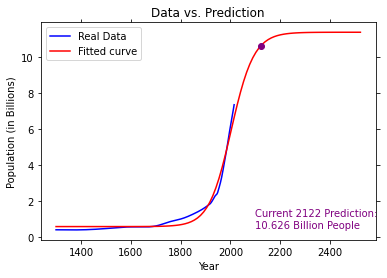

Iteration #45350, Loss: 0.05046152101151438


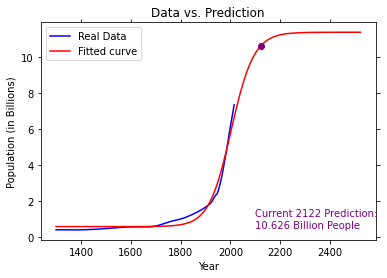

Iteration #45400, Loss: 0.050460099748755184


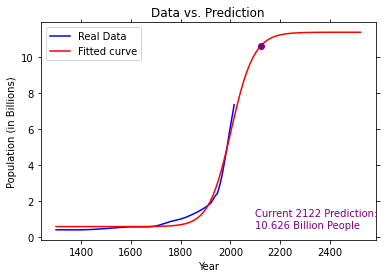

Iteration #45450, Loss: 0.050458693832214026


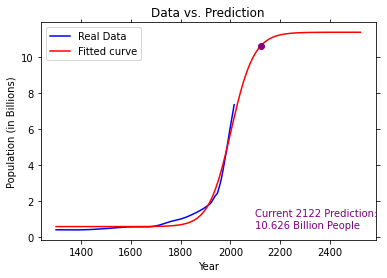

Iteration #45500, Loss: 0.05045730326236747


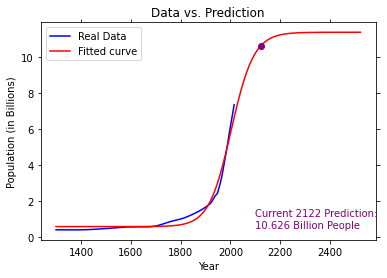

Iteration #45550, Loss: 0.05045592803968589


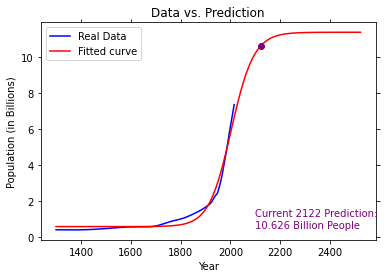

Iteration #45600, Loss: 0.05045456816463227


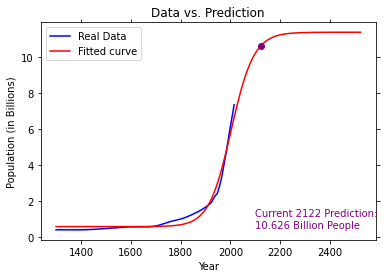

Iteration #45650, Loss: 0.05045322363766418


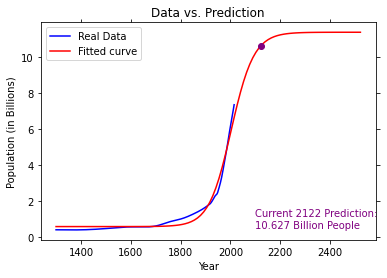

Iteration #45700, Loss: 0.050451894459231636


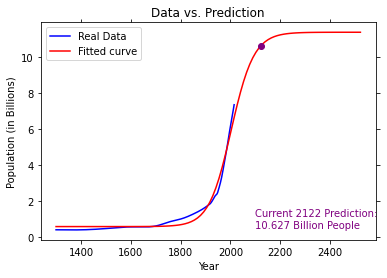

Iteration #45750, Loss: 0.050450580629778426


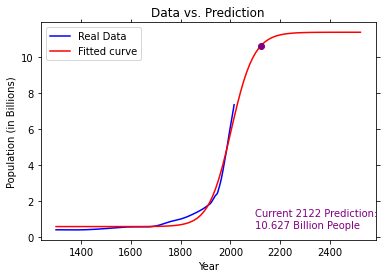

Iteration #45800, Loss: 0.050449282149742126


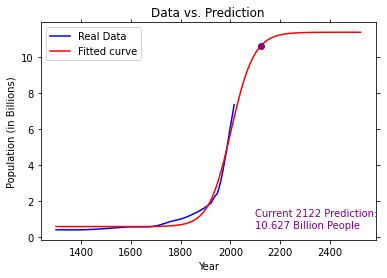

Iteration #45850, Loss: 0.050447999019553824


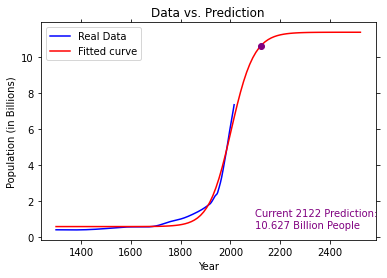

Iteration #45900, Loss: 0.05044673123963842


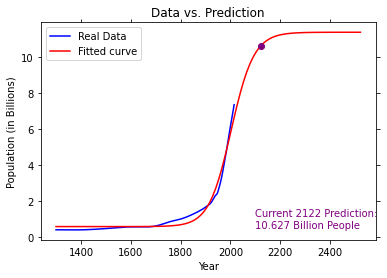

Iteration #45950, Loss: 0.05044547881041426


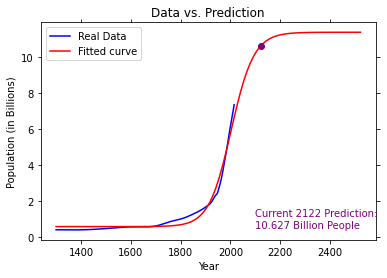

Iteration #46000, Loss: 0.05044424173229353


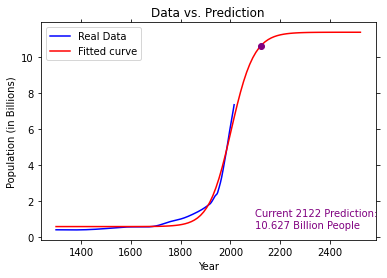

Iteration #46050, Loss: 0.0504430200056822


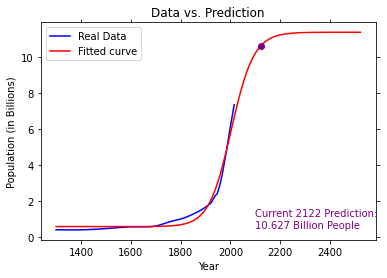

Iteration #46100, Loss: 0.050441813630980166


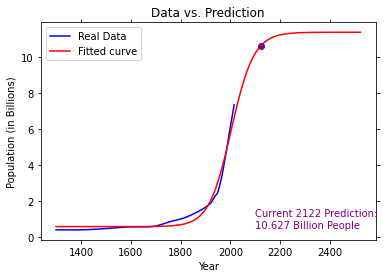

Iteration #46150, Loss: 0.05044062260858121


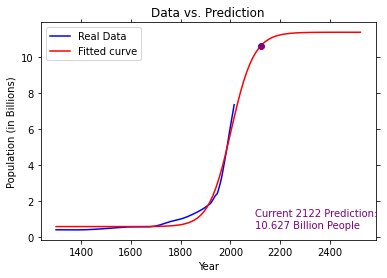

Iteration #46200, Loss: 0.05043944693887254


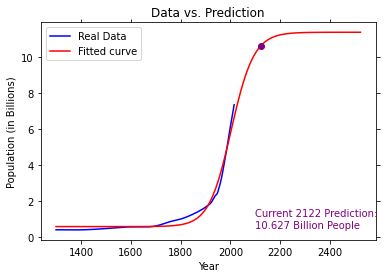

Iteration #46250, Loss: 0.05043828662223619


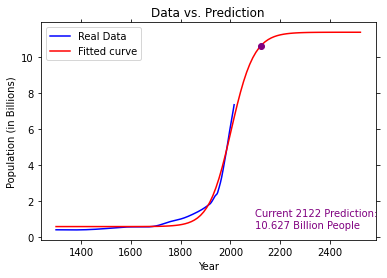

Iteration #46300, Loss: 0.050437141659047446


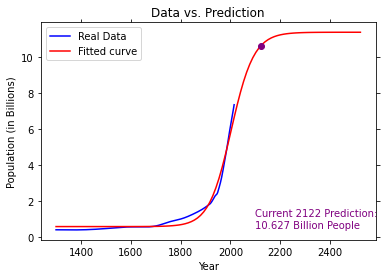

Iteration #46350, Loss: 0.050436012049675974


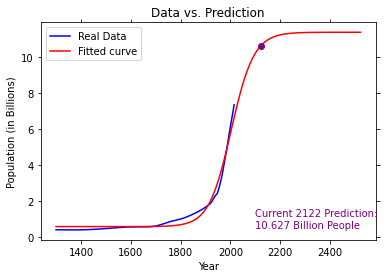

Iteration #46400, Loss: 0.050434897794485505


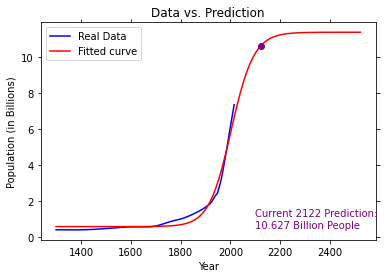

Iteration #46450, Loss: 0.05043379889383362


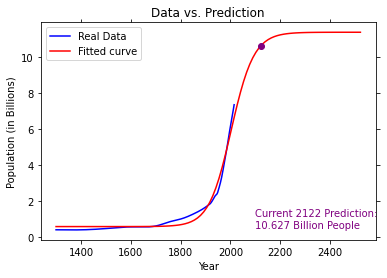

Iteration #46500, Loss: 0.05043271534807244


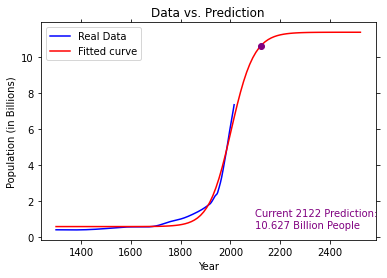

Iteration #46550, Loss: 0.05043164715754809


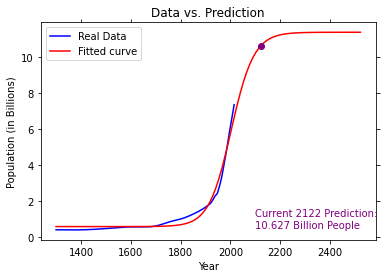

Iteration #46600, Loss: 0.050430594322600684


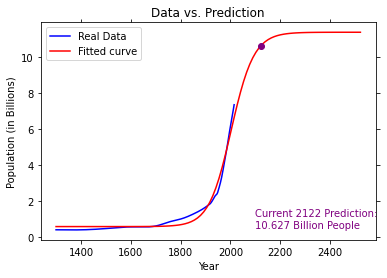

Iteration #46650, Loss: 0.05042955684356505


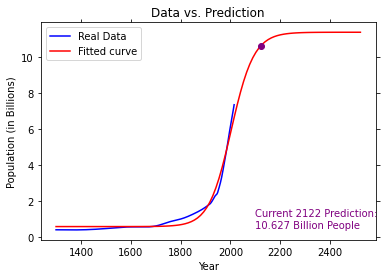

Iteration #46700, Loss: 0.05042853472076997


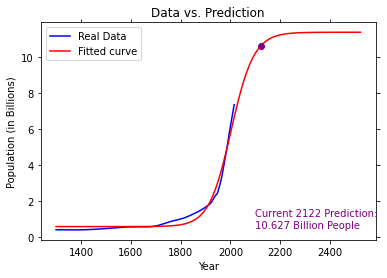

Iteration #46750, Loss: 0.05042752795453861


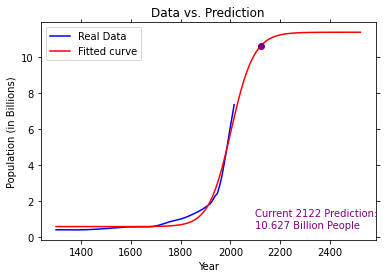

Iteration #46800, Loss: 0.05042653654518876


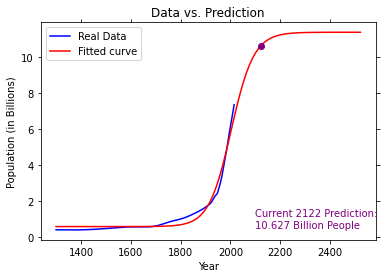

Iteration #46850, Loss: 0.05042556049303222


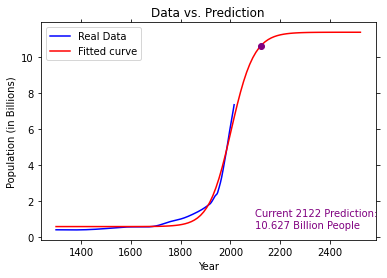

Iteration #46900, Loss: 0.05042459979837547


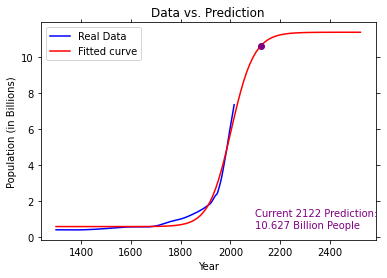

Iteration #46950, Loss: 0.05042365446151955


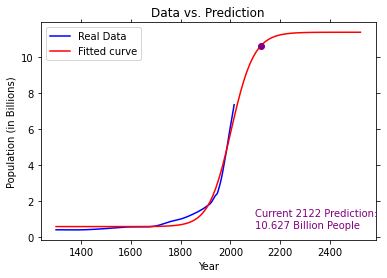

Iteration #47000, Loss: 0.0504227244827597


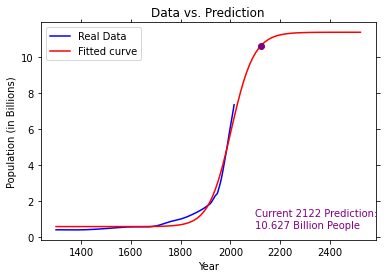

Iteration #47050, Loss: 0.05042180986238599


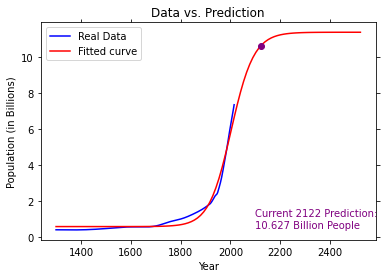

Iteration #47100, Loss: 0.050420910600682836


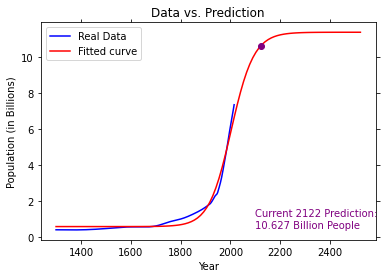

Iteration #47150, Loss: 0.05042002669792942


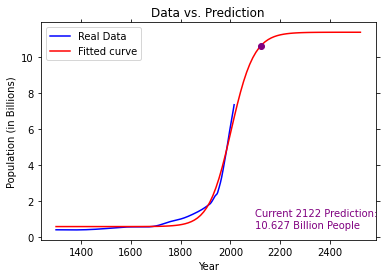

Iteration #47200, Loss: 0.050419158154399596


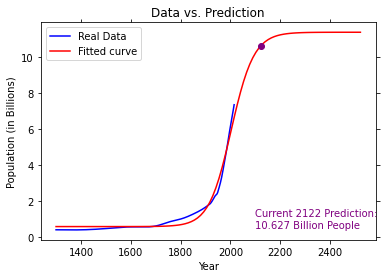

Iteration #47250, Loss: 0.05041830497036148


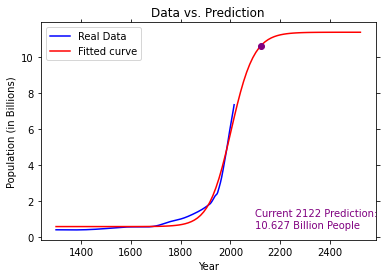

Iteration #47300, Loss: 0.05041746714607851


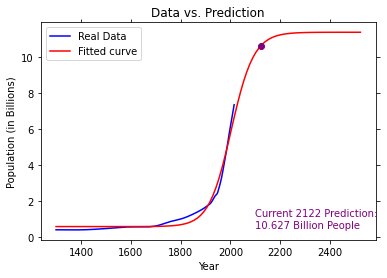

Iteration #47350, Loss: 0.0504166446818082


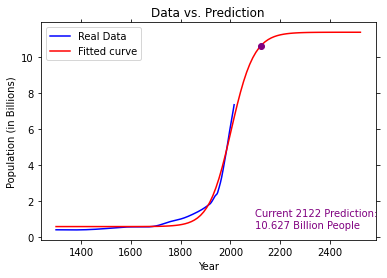

Iteration #47400, Loss: 0.05041583757780355


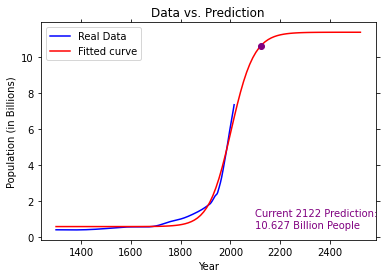

Iteration #47450, Loss: 0.05041504583431158


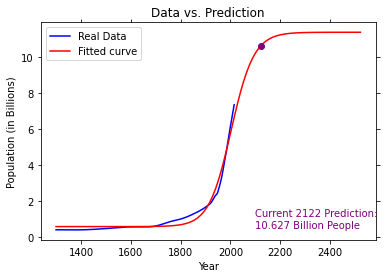

Iteration #47500, Loss: 0.050414269451574546


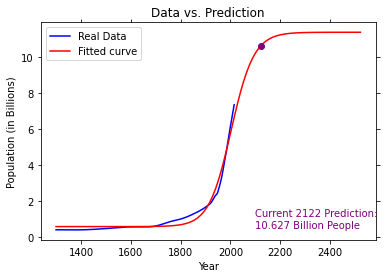

Iteration #47550, Loss: 0.050413508429829355


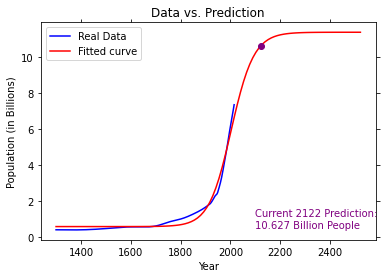

Iteration #47600, Loss: 0.050412762769308395


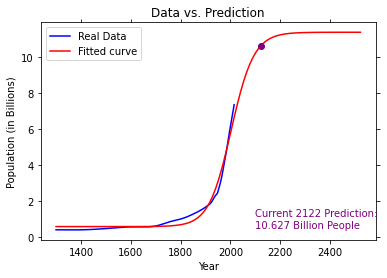

Iteration #47650, Loss: 0.050412032470237775


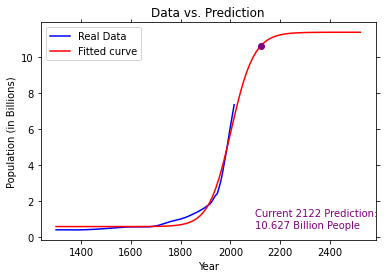

Iteration #47700, Loss: 0.05041131753283956


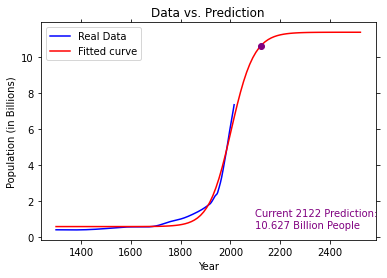

Iteration #47750, Loss: 0.05041061795733013


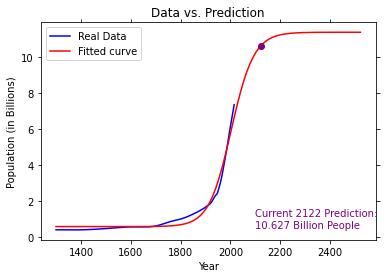

Iteration #47800, Loss: 0.050409933743921095


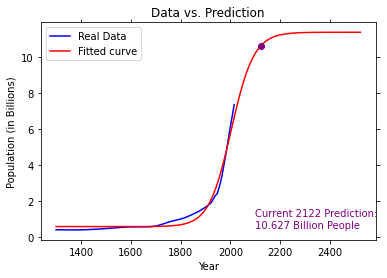

Iteration #47850, Loss: 0.05040926489281945


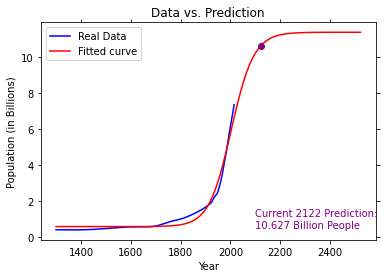

Iteration #47900, Loss: 0.050408611404226304


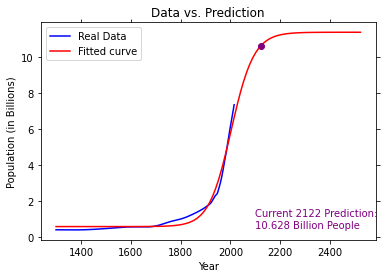

Iteration #47950, Loss: 0.05040797327833859


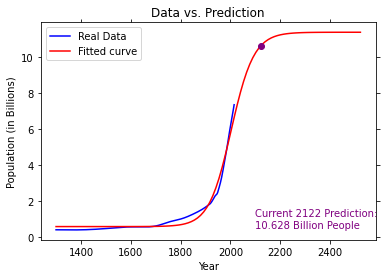

Iteration #48000, Loss: 0.05040735051534775


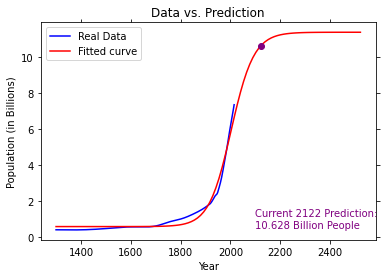

Iteration #48050, Loss: 0.05040674311544073


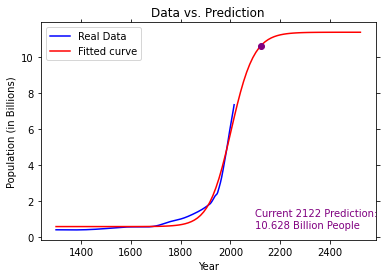

Iteration #48100, Loss: 0.05040615107879941


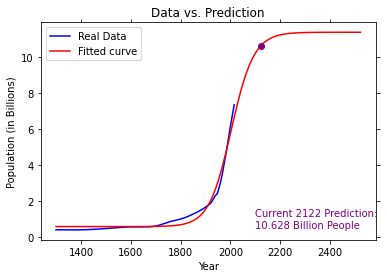

Iteration #48150, Loss: 0.05040557440560078


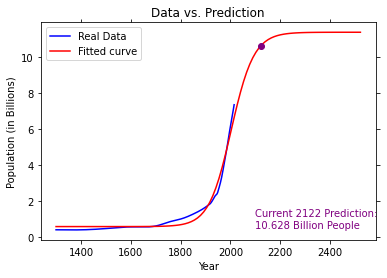

Iteration #48200, Loss: 0.05040501309601688


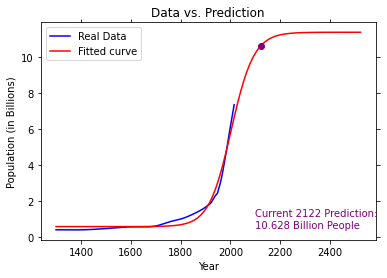

Iteration #48250, Loss: 0.05040446715021528


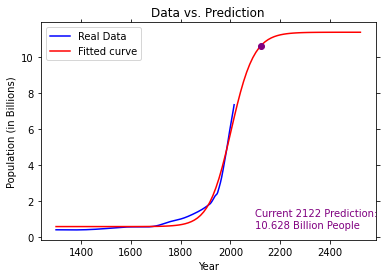

Iteration #48300, Loss: 0.05040393656835833


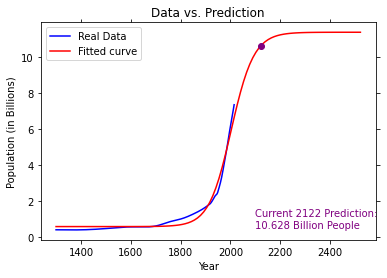

Iteration #48350, Loss: 0.050403421350603814


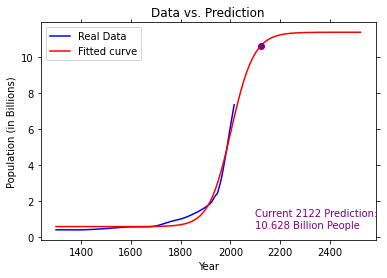

Iteration #48400, Loss: 0.050402921497104645


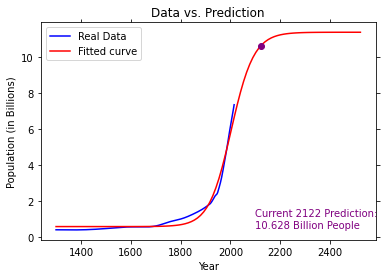

Iteration #48450, Loss: 0.05040243700800909


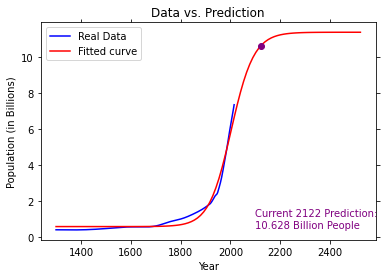

Iteration #48500, Loss: 0.050401967883460845


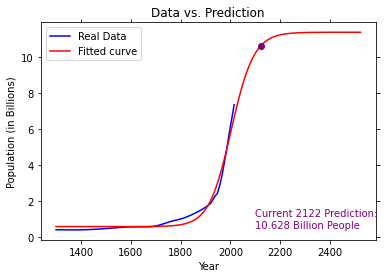

Iteration #48550, Loss: 0.05040151412359775


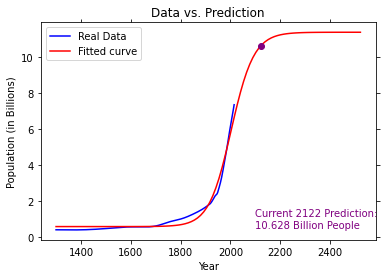

Iteration #48600, Loss: 0.050401075728554824


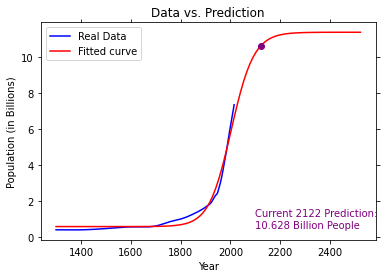

Iteration #48650, Loss: 0.05040065269846099


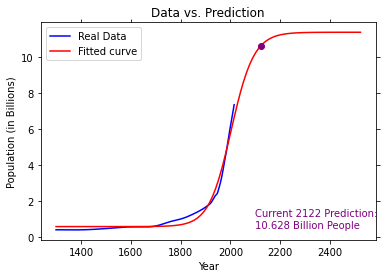

Iteration #48700, Loss: 0.050400245033440844


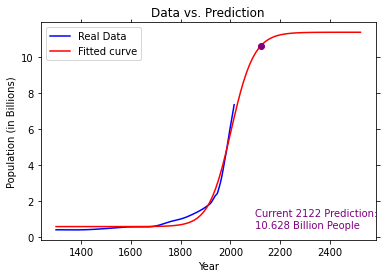

Iteration #48750, Loss: 0.05039985273361471


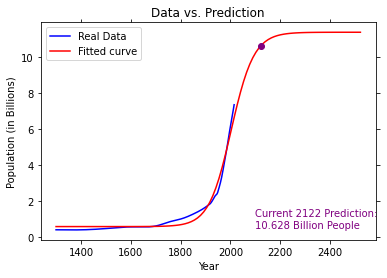

Iteration #48800, Loss: 0.05039947579909769


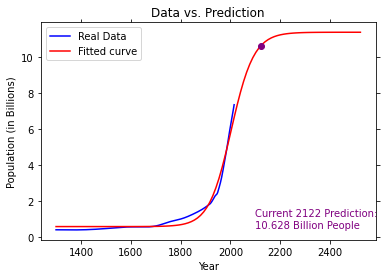

Iteration #48850, Loss: 0.05039911423000063


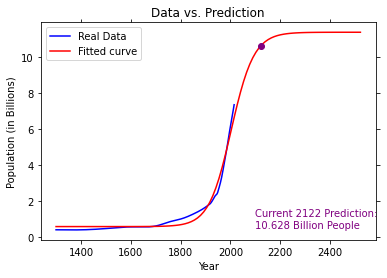

Iteration #48900, Loss: 0.050398768026429626


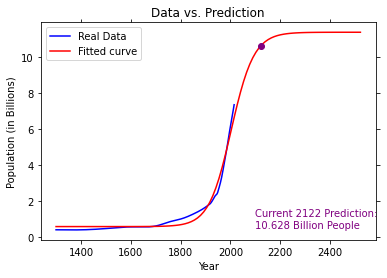

Iteration #48950, Loss: 0.050398437188486175


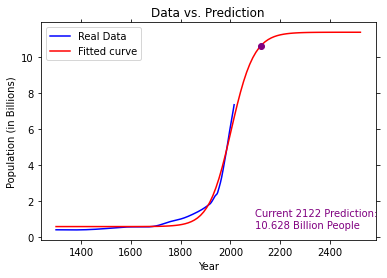

Iteration #49000, Loss: 0.050398121716267265


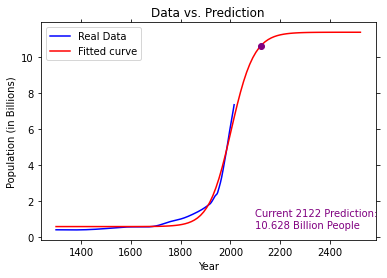

Iteration #49050, Loss: 0.05039782160986517


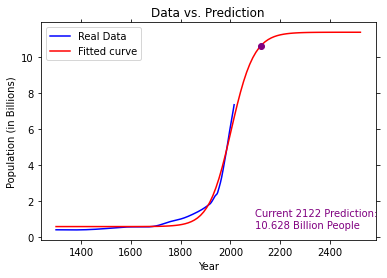

Iteration #49100, Loss: 0.05039753686936772


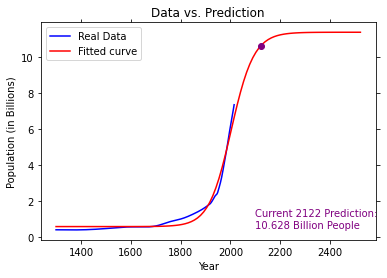

Iteration #49150, Loss: 0.05039726749485813


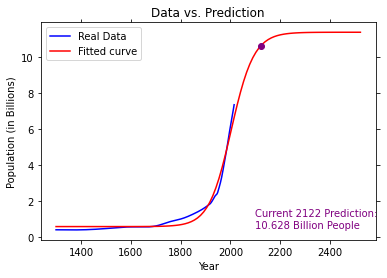

Iteration #49200, Loss: 0.050397013486415135


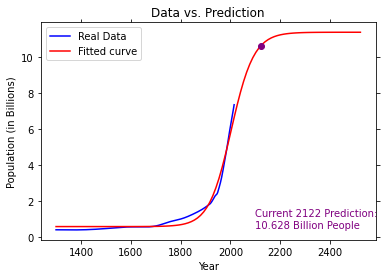

Iteration #49250, Loss: 0.05039677484411268


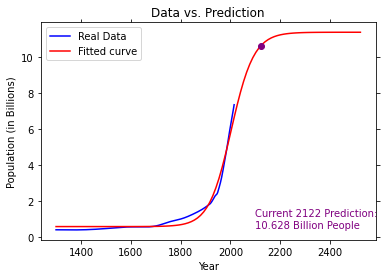

Iteration #49300, Loss: 0.050396551568020635


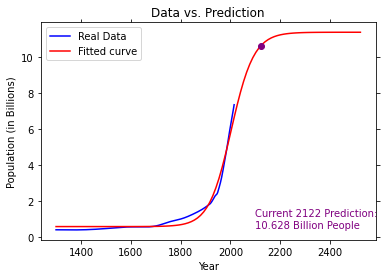

Iteration #49350, Loss: 0.05039634365820384


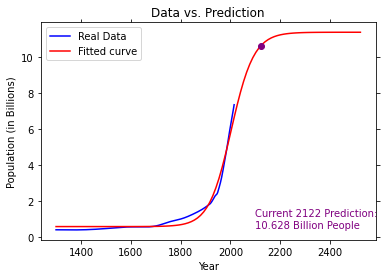

Iteration #49400, Loss: 0.05039615111472305


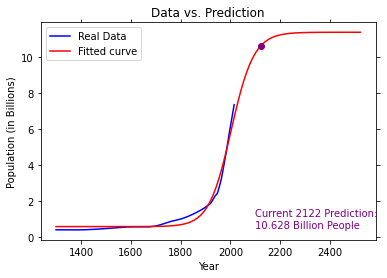

Iteration #49450, Loss: 0.05039597393763429


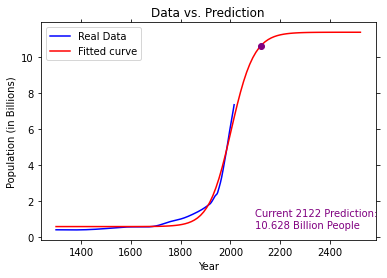

Iteration #49500, Loss: 0.05039581212698907


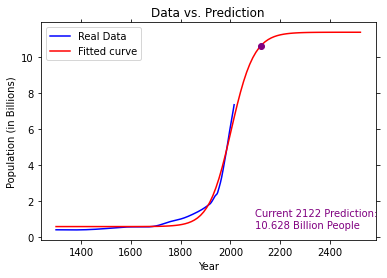

Iteration #49550, Loss: 0.05039566568283453


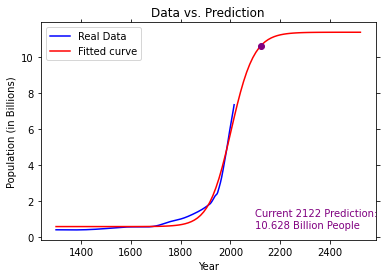

Iteration #49600, Loss: 0.0503955346052132


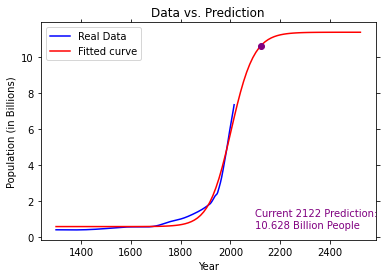

Iteration #49650, Loss: 0.050395418894163165


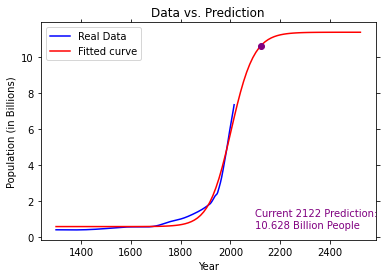

Iteration #49700, Loss: 0.050395318549718134


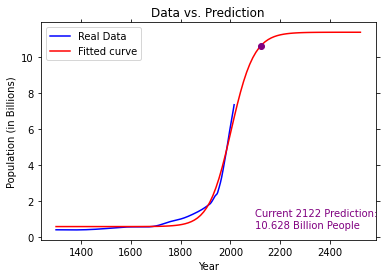

Iteration #49750, Loss: 0.050395233571907116


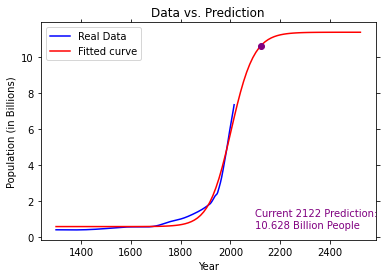

Iteration #49800, Loss: 0.05039516396075523


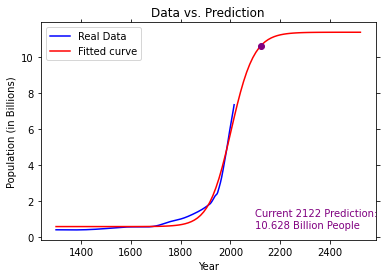

Iteration #49850, Loss: 0.05039510971628225


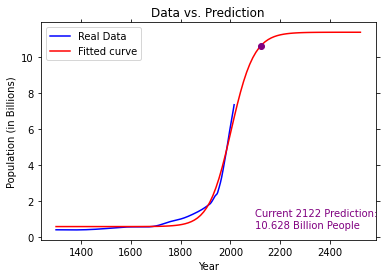

Iteration #49900, Loss: 0.050395070838504


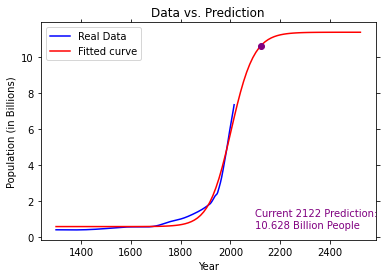

Iteration #49950, Loss: 0.05039504732743204


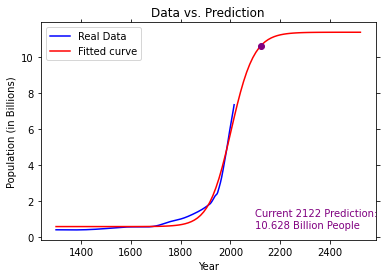

In [11]:
# Iterate "updates" number of times and update the model
for i in range(0, updates):
    # Get some predictions from the model
    preds = m(years)

    # Calculate the loss
    loss = m.getLoss(preds, values)

    # Update the model
    m.update(loss, updates, i)


    # Plot the graph with some data and show the loss every so often
    if i % 50 == 0:
        print(f"Iteration #{i}, Loss: {loss}")
        if showGraph == True:
            testX = torch.from_numpy(np.linspace(13,25.22,100))
            testY = m(testX).detach()
            plt.cla()
            plt.plot(years*100, values, c="blue", label="Real Data")
            plt.plot(testX*100, testY, c="red", label="Fitted curve")
            plt.plot(21.22*100, m(21.22).detach(), 'o', c="purple") 
            plt.text(21.00*100, 0.5, f"Current 2122 Prediction: \n{m(21.22).detach().numpy().round(3)} Billion People", c="purple")
            plt.xlabel("Year")
            plt.ylabel("Population (in Billions)")
            plt.title("Data vs. Prediction")
            plt.legend(loc="upper left")
            plt.pause(0.0001)
            #plt.savefig(f'gif/img{i/50}.png')

Now let's get the parameters of the model when the model is done training

In [12]:
# Get the parameters of the model to save them
c1, c2, c3, c4, c5, c6, c7, c8 = m.getParams()
print(f"Parameters: c1={c1}, c2={c2}, c3={c3}, c4={c4}, c5={c5}, c6={c6}, c7={c7}, c8={c8}")

Parameters: c1=10.654135216823821, c2=0.9864140912245566, c3=1.0385540355655845, c4=1.9698143047910193, c5=1.104389410774113, c6=-22.060388036261674, c7=1.0657278995848072, c8=0.5712219176728186


Finally, we will make a prediction for 2122

In [13]:
# Make the prediction
print(f"Model prediction for 2122: {m(torch.tensor(21.22))} billion people")

Model prediction for 2122: 10.62781082708388 billion people
